In [1]:
# This just checks to make sure you have the right packages installed
%run check_setup.py

[✓] scikit-image  0.17.2
[✓] numpy         1.18.5
[✓] scipy         1.4.1
[✓] matplotlib    3.2.1
[✓] notebook      6.0.1
[✓] scikit-learn  0.23.1


In [2]:
# Magic command to make plotting inline
%matplotlib inline

# sets the figure format
%config InlineBackend.figure_format = 'retina'

# Images are numpy arrays

Images are represented in ``scikit-image`` using standard ``numpy`` arrays.  This allows maximum inter-operability with other libraries in the scientific Python ecosystem, such as ``matplotlib`` and ``scipy``.

Let's see how to build a grayscale image as a 2D array:

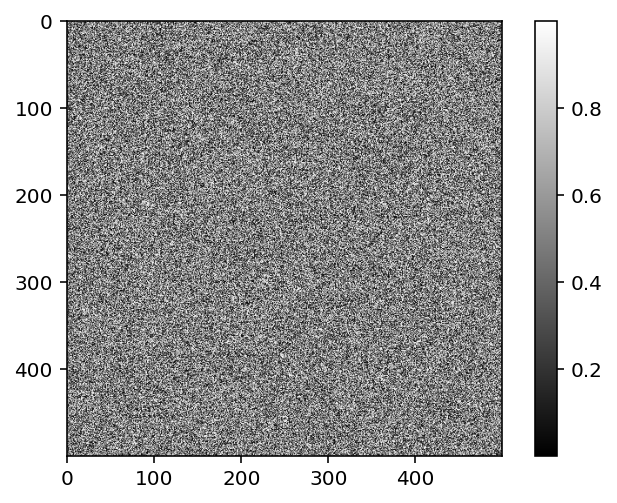

In [3]:
# imports core packages
import numpy as np
from matplotlib import pyplot as plt

# Builds a random numpy array
random_image = np.random.random([500, 500])

# plots the numpy array
plt.imshow(random_image, cmap='gray')

# Draws the colorbar 
plt.colorbar();

The same holds for "real-world" images:

Type: <class 'numpy.ndarray'>
dtype: uint8
shape: (303, 384)


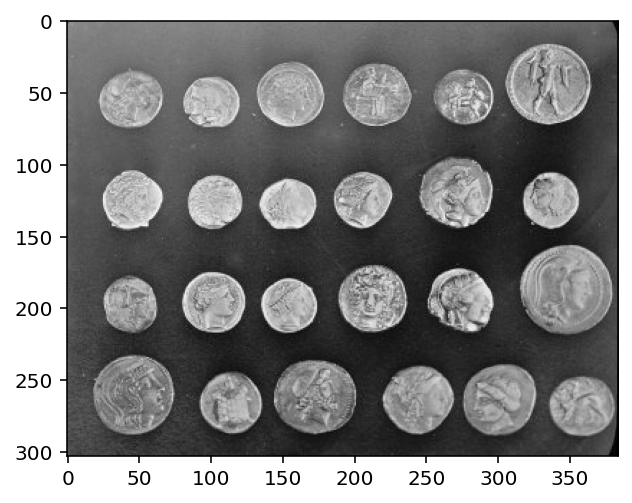

In [4]:
from skimage import data

# imports a coins image
coins = data.coins()

# displays information about the data
print('Type:', type(coins))
print('dtype:', coins.dtype)
print('shape:', coins.shape)

# plots the data
plt.imshow(coins, cmap='gray');

A color image is a 3D array, where the last dimension has size 3 and represents the red, green, and blue channels:

Shape: (300, 451, 3)
Values min/max: 0 231


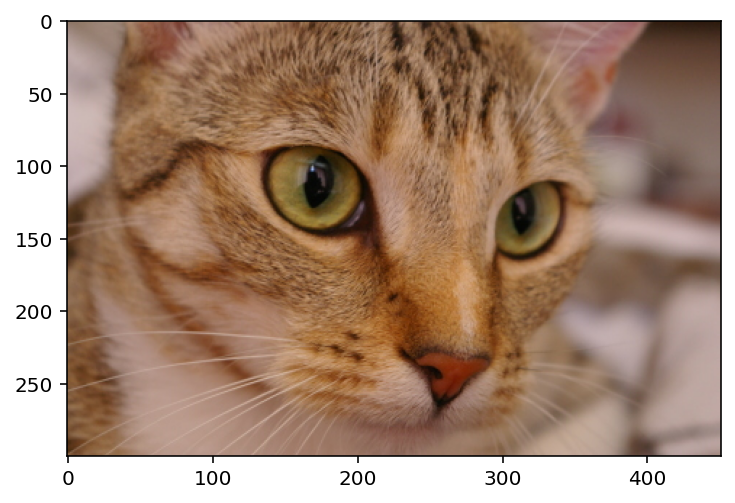

In [5]:
cat = data.chelsea()
print("Shape:", cat.shape)
print("Values min/max:", cat.min(), cat.max())

plt.imshow(cat);

These are *just NumPy arrays*. E.g., we can make a red square by using standard array slicing and manipulation:

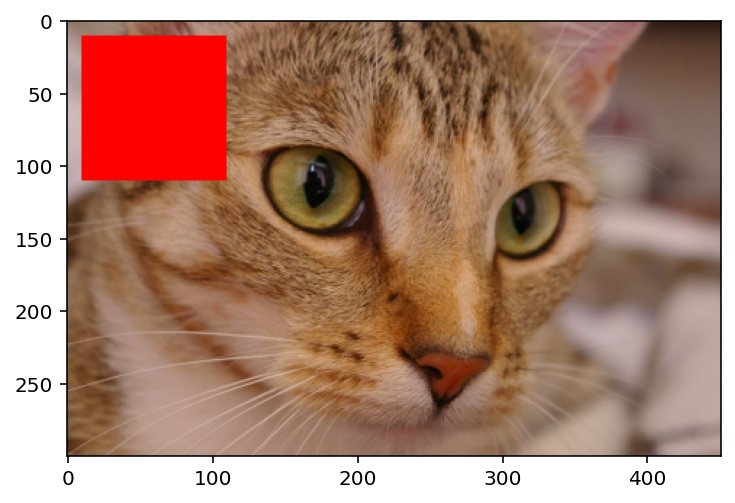

In [6]:
cat[10:110, 10:110, :] = [255, 0, 0]  # [red, green, blue]
plt.imshow(cat);

Images can also include transparent regions by adding a 4th dimension, called an *alpha layer*.

### Other shapes, and their meanings

|Image type|Coordinates|
|:---|:---|
|2D grayscale|(row, column)|
|2D multichannel|(row, column, channel)|
|3D grayscale (or volumetric) |(plane, row, column)|
|3D multichannel|(plane, row, column, channel)|

## Displaying images using matplotlib

In [7]:
from skimage import data

img0 = data.chelsea()
img1 = data.rocket()

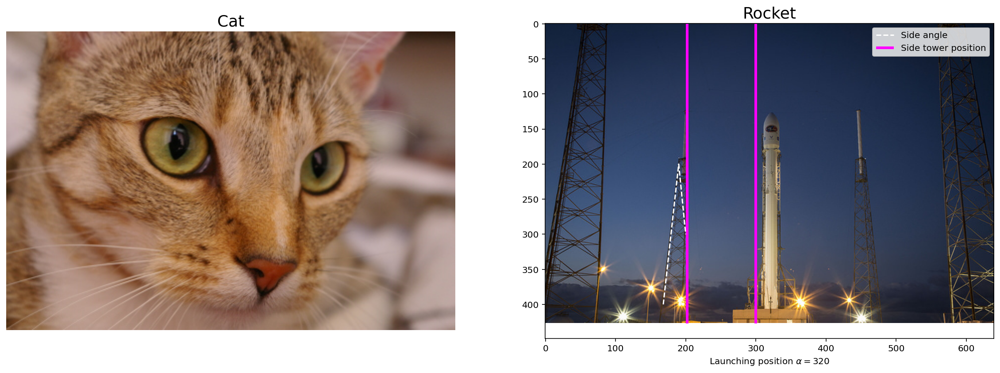

In [8]:
import matplotlib.pyplot as plt

f, (ax0, ax1) = plt.subplots(1, 2, figsize=(20, 10))

ax0.imshow(img0)
ax0.set_title('Cat', fontsize=18)
ax0.axis('off')

ax1.imshow(img1)
ax1.set_title('Rocket', fontsize=18)
ax1.set_xlabel(r'Launching position $\alpha=320$')

ax1.vlines([202, 300], 0, img1.shape[0], colors='magenta', linewidth=3, label='Side tower position')
ax1.plot([168, 190, 200], [400, 200, 300], color='white', linestyle='--', label='Side angle')

ax1.legend();

For more on plotting, see the [Matplotlib documentation](https://matplotlib.org/gallery/index.html#images-contours-and-fields) and [pyplot API](https://matplotlib.org/api/pyplot_summary.html).

## Data types and image values

In literature, one finds different conventions for representing image values:

```
  0 - 255   where  0 is black, 255 is white
  0 - 1     where  0 is black, 1 is white
```

``scikit-image`` supports both conventions--the choice is determined by the
data-type of the array.

E.g., here, I generate two valid images:

Linear0: float64 0.0 1.0
Linear1: uint8 0 255


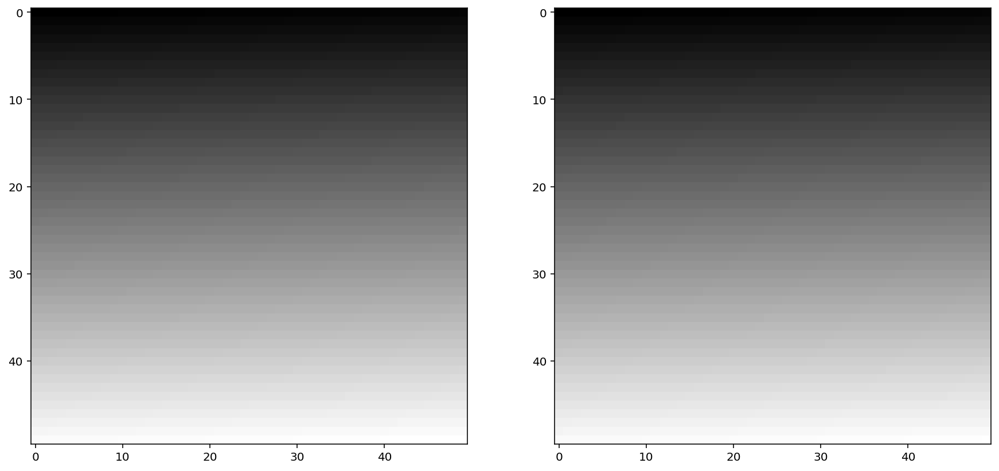

In [9]:
linear0 = np.linspace(0, 1, 2500).reshape((50, 50))
linear1 = np.linspace(0, 255, 2500).reshape((50, 50)).astype(np.uint8)

print("Linear0:", linear0.dtype, linear0.min(), linear0.max())
print("Linear1:", linear1.dtype, linear1.min(), linear1.max())

fig, (ax0, ax1) = plt.subplots(1, 2, figsize=(15, 15))
ax0.imshow(linear0, cmap='gray')
ax1.imshow(linear1, cmap='gray');

The library is designed in such a way that any data-type is allowed as input,
as long as the range is correct (0-1 for floating point images, 0-255 for unsigned bytes,
0-65535 for unsigned 16-bit integers).

You can convert images between different representations by using ``img_as_float``, ``img_as_ubyte``, etc.:

In [10]:
from skimage import img_as_float, img_as_ubyte

image = data.chelsea()

image_ubyte = img_as_ubyte(image)
image_float = img_as_float(image)

print("type, min, max:", image_ubyte.dtype, image_ubyte.min(), image_ubyte.max())
print("type, min, max:", image_float.dtype, image_float.min(), image_float.max())
print()
print("231/255 =", 231/255.)

type, min, max: uint8 0 231
type, min, max: float64 0.0 0.9058823529411765

231/255 = 0.9058823529411765


Your code would then typically look like this:

```python
def my_function(any_image):
   float_image = img_as_float(any_image)
   # Proceed, knowing image is in [0, 1]
```

We recommend using the floating point representation, given that
``scikit-image`` mostly uses that format internally.

## Image I/O

Mostly, we won't be using input images from the scikit-image example data sets.  Those images are typically stored in JPEG or PNG format.  Since scikit-image operates on NumPy arrays, *any* image reader library that provides arrays will do.  Options include imageio, matplotlib, pillow, etc.

scikit-image conveniently wraps many of these in the `io` submodule, and will use whichever of the libraries mentioned above are installed:

<class 'numpy.ndarray'>
uint8
(300, 225, 3)
0 255


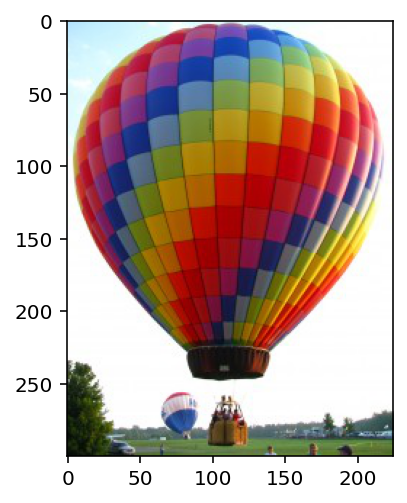

In [11]:
from skimage import io

image = io.imread('./images/balloon.jpg')

print(type(image))
print(image.dtype)
print(image.shape)
print(image.min(), image.max())

plt.imshow(image);

We also have the ability to load multiple images, or multi-layer TIFF images:

In [12]:
ic = io.ImageCollection('./images/*.png:./images/*.jpg')
# the * is a wildcard operator that takes all that match that description

print('Type:', type(ic))

ic.files

Type: <class 'skimage.io.collection.ImageCollection'>


['./images/Bells-Beach.jpg',
 './images/balloon.jpg',
 './images/bubbles.jpg',
 './images/censure_example.png',
 './images/chapel_floor.png',
 './images/chromosomes.jpg',
 './images/clock_motion.png',
 './images/color-wheel.jpg',
 './images/credit_card.jpg',
 './images/cycle_spin.png',
 './images/fingers.png',
 './images/forest.jpg',
 './images/greenscreen.jpg',
 './images/hand-coin.jpg',
 './images/microarray.jpg',
 './images/mm.jpg',
 './images/mona_lisa.jpg',
 './images/mpl_hist.png',
 './images/round_pill.jpg',
 './images/snakes.png',
 './images/spice_1.jpg',
 './images/spices.jpg',
 './images/stefan.jpg',
 './images/superprom_prev.jpg',
 './images/terminator_vision.png',
 './images/zebrafish-spinal-cord-color.png',
 './images/zebrafish-spinal-cord.png']

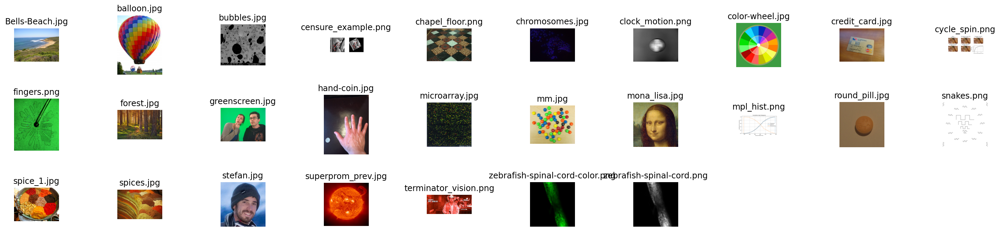

In [13]:
import os

# This is one of the many ways to make subplots
f, axes = plt.subplots(nrows=3, ncols=len(ic) // 3 + 1, figsize=(20, 5))

# subplots returns the figure and an array of axes
# we use `axes.ravel()` to turn these into a list
axes = axes.ravel()

for ax in axes:
    ax.axis('off')

for i, image in enumerate(ic):
    axes[i].imshow(image, cmap='gray')
    axes[i].set_title(os.path.basename(ic.files[i]))
    
plt.tight_layout()

### Aside: `enumerate`

`enumerate` gives us each element in a container, along with its position.

In [14]:
animals = ['cat', 'dog', 'leopard']

In [15]:
for i, animal in enumerate(animals):
    print('The animal in position {} is {}'.format(i, animal))

The animal in position 0 is cat
The animal in position 1 is dog
The animal in position 2 is leopard


## <span class="exercize">Exercise: draw the letter H</span>

Define a function that takes as input an RGB image and a pair of coordinates (row, column), and returns a copy with a green letter H overlaid at those coordinates. The coordinates point to the top-left corner of the H.

The arms and strut of the H should have a width of 3 pixels, and the H itself should have a height of 24 pixels and width of 20 pixels.

Start with the following template:

In [16]:
def draw_H(image, coords, color=(0, 255, 0)):
    out = image.copy()
    
    ...
    
    return out 

In [17]:
# %load draw_letter_H.py

from skimage import img_as_float

def draw_H(image, coords, color=(0, 255, 0)):
    # makes a copy of the image
    out = image.copy()
    
    # Defines the size of the letter H
    canvas = out[coords[0]:coords[0] + 24,
                 coords[1]:coords[1] + 20]
    
    # sets the color
    canvas[:, :3] = color
    canvas[:, -3:] = color
    canvas[11:14] = color
    
    return out


Test your function like so:

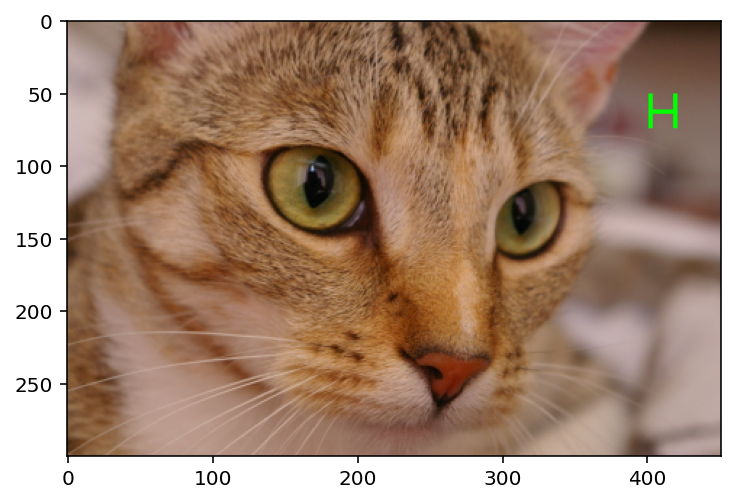

In [18]:
cat = data.chelsea()
cat_H = draw_H(cat, (50, -50))
plt.imshow(cat_H);

## <span class="exercize">Exercise: visualizing RGB channels</span>

Display the different color channels of the image along (each as a gray-scale image).  Start with the following template:

TypeError: Image data of dtype object cannot be converted to float

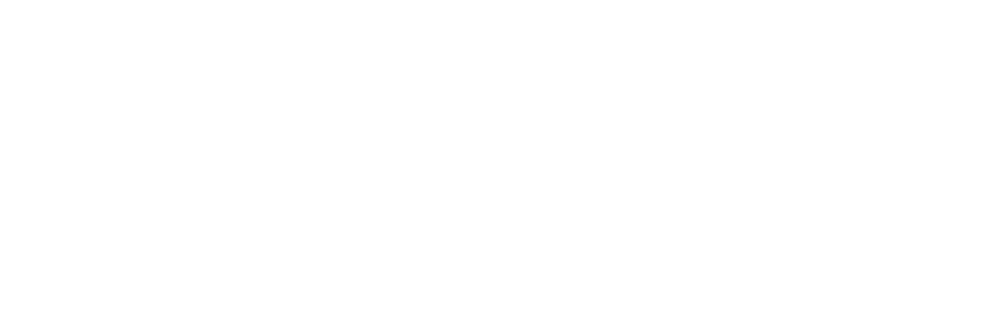

In [21]:
# --- read in the image ---

image = plt.imread('./images/Bells-Beach.jpg')

# --- assign each color channel to a different variable ---

r = ...
g = ...
b = ...

# --- display the image and r, g, b channels ---

f, axes = plt.subplots(1, 4, figsize=(16, 5))

for ax in axes:
    ax.axis('off')

(ax_r, ax_g, ax_b, ax_color) = axes
    
ax_r.imshow(r, cmap='gray')
ax_r.set_title('red channel')

ax_g.imshow(g, cmap='gray')
ax_g.set_title('green channel')

ax_b.imshow(b, cmap='gray')
ax_b.set_title('blue channel')

# --- Here, we stack the R, G, and B layers again
#     to form a color image ---
ax_color.imshow(np.stack([r, g, b], axis=2))
ax_color.set_title('all channels');

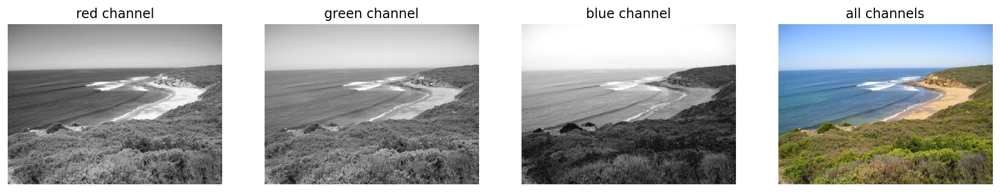

In [22]:
# %load visualizing_RGB.py

# --- read in the image ---

image = plt.imread('./images/Bells-Beach.jpg')

# --- assign each color channel to a different variable ---

r = image[..., 0]
g = image[..., 1]
b = image[..., 2]

# --- display the image and r, g, b channels ---

f, axes = plt.subplots(1, 4, figsize=(16, 5))

for ax in axes:
    ax.axis('off')

(ax_r, ax_g, ax_b, ax_color) = axes
    
ax_r.imshow(r, cmap='gray')
ax_r.set_title('red channel')

ax_g.imshow(g, cmap='gray')
ax_g.set_title('green channel')

ax_b.imshow(b, cmap='gray')
ax_b.set_title('blue channel')

# --- Here, we stack the R, G, and B layers again
#     to form a color image ---
ax_color.imshow(np.stack([r, g, b], axis=2))
ax_color.set_title('all channels');


Now, take a look at the following R, G, and B channels.  How would their combination look? (Write some code to confirm your intuition.)

/Users/joshagar/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:7: FutureWarning: circle is deprecated in favor of disk.circle will be removed in version 0.19
  import sys
/Users/joshagar/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:10: FutureWarning: circle is deprecated in favor of disk.circle will be removed in version 0.19
  # Remove the CWD from sys.path while we load stuff.
/Users/joshagar/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:13: FutureWarning: circle is deprecated in favor of disk.circle will be removed in version 0.19
  del sys.path[0]


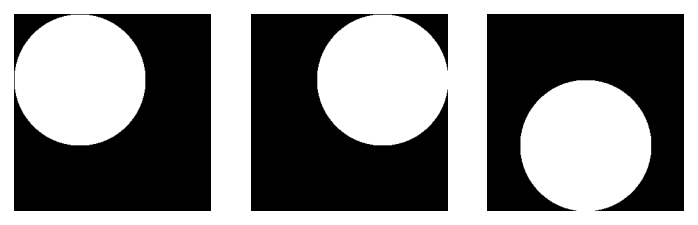

In [23]:
from skimage import draw

red = np.zeros((300, 300))
green = np.zeros((300, 300))
blue = np.zeros((300, 300))

r, c = draw.circle(100, 100, 100)
red[r, c] = 1

r, c = draw.circle(100, 200, 100)
green[r, c] = 1

r, c = draw.circle(200, 150, 100)
blue[r, c] = 1

f, axes = plt.subplots(1, 3)
for (ax, channel) in zip(axes, [red, green, blue]):
    ax.imshow(channel, cmap='gray')
    ax.axis('off')

/Users/joshagar/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: FutureWarning: circle is deprecated in favor of disk.circle will be removed in version 0.19
  if __name__ == '__main__':
/Users/joshagar/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: FutureWarning: circle is deprecated in favor of disk.circle will be removed in version 0.19
  if sys.path[0] == '':
/Users/joshagar/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: circle is deprecated in favor of disk.circle will be removed in version 0.19
  from ipykernel import kernelapp as app


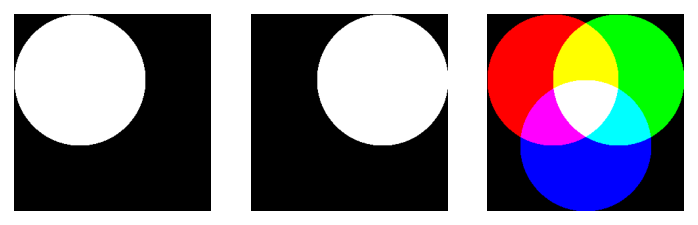

In [24]:
# %load combine_color_image.py

from skimage import draw

red = np.zeros((300, 300))
green = np.zeros((300, 300))
blue = np.zeros((300, 300))

r, c = draw.circle(100, 100, 100)
red[r, c] = 1

r, c = draw.circle(100, 200, 100)
green[r, c] = 1

r, c = draw.circle(200, 150, 100)
blue[r, c] = 1

f, axes = plt.subplots(1, 3)
for (ax, channel) in zip(axes, [red, green, blue]):
    ax.imshow(channel, cmap='gray')
    ax.axis('off')
    
plt.imshow(np.stack([red, green, blue], axis=2));


## Exercise: Convert to grayscale ("black and white")

The *relative luminance* of an image is the intensity of light coming from each point. Different colors contribute differently to the luminance: it's very hard to have a bright, pure blue, for example. So, starting from an RGB image, the luminance is given by:

$$
Y = 0.2126R + 0.7152G + 0.0722B
$$

Use Python 3.5's matrix multiplication, `@`, to convert an RGB image to a grayscale luminance image according to the formula above.

Compare your results to that obtained with `skimage.color.rgb2gray`.

Change the coefficients to 1/3 (i.e., take the mean of the red, green, and blue channels, to see how that approach compares with `rgb2gray`).

TypeError: Image data of dtype object cannot be converted to float

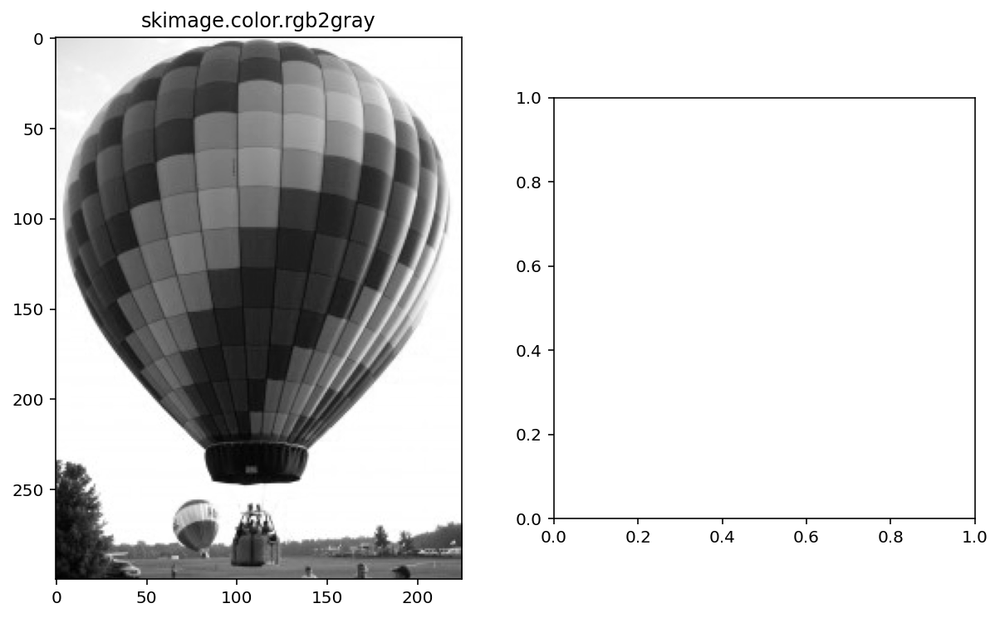

In [25]:
from skimage import color, img_as_float

image = img_as_float(io.imread('./images/balloon.jpg'))

gray = color.rgb2gray(image)
my_gray = ...

# --- display the results ---

f, (ax0, ax1) = plt.subplots(1, 2, figsize=(10, 6))

ax0.imshow(gray, cmap='gray')
ax0.set_title('skimage.color.rgb2gray')

ax1.imshow(my_gray, cmap='gray')
ax1.set_title('my rgb2gray')

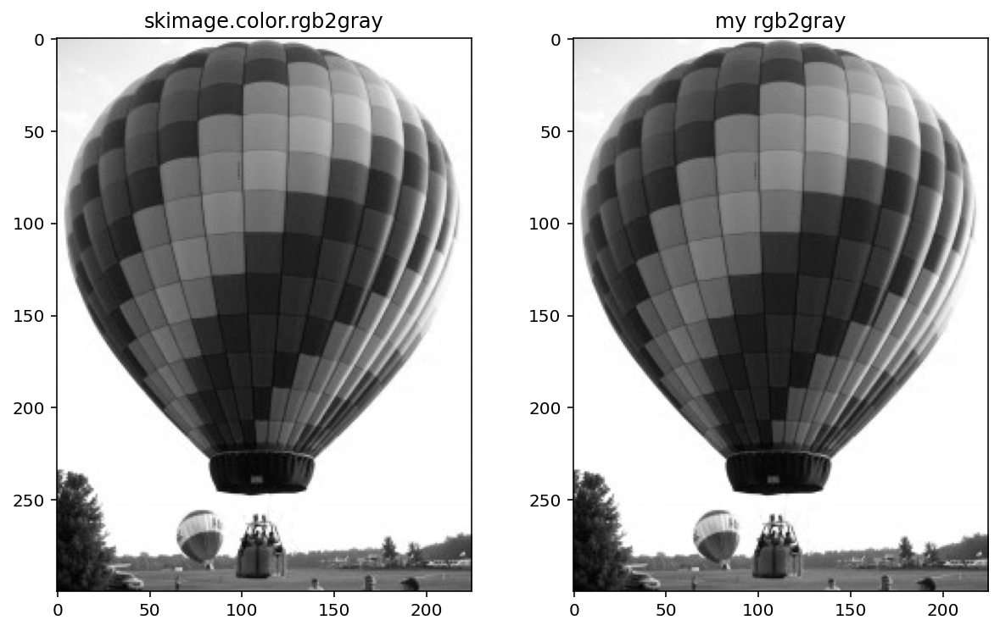

In [26]:
# %load convert_to_gray.py

from skimage import io, color, img_as_float

image = img_as_float(io.imread('././images/balloon.jpg'))

gray = color.rgb2gray(image)
my_gray = image @ [0.2126, 0.7152, 0.0722]

# --- display the results ---

f, (ax0, ax1) = plt.subplots(1, 2, figsize=(10, 6))

ax0.imshow(gray, cmap='gray')
ax0.set_title('skimage.color.rgb2gray')

ax1.imshow(my_gray, cmap='gray')
ax1.set_title('my rgb2gray');


Let's validate that these results are similar

In [27]:
# Let's calculate the mean intensity error, as compared to
# scikit-image's color.rgb2gray

import numpy as np
np.mean(np.abs(gray - my_gray))

2.2436926652161234e-05

# Image filtering

## Image filtering theory

Filtering is one of the most basic and common image operations in image processing. You can filter an image to remove noise or to enhance features; the filtered image could be the desired result or just a preprocessing step. Regardless, filtering is an important topic to understand.

### Local filtering

In [28]:
import matplotlib.pyplot as plt
import numpy as np

plt.rcParams['image.cmap'] = 'gray'

The "local" in local filtering simply means that a pixel is adjusted by values in some surrounding neighborhood. These surrounding elements are identified or weighted based on a "footprint", "structuring element", or "kernel".

Let's go to back to basics and look at a 1D step-signal

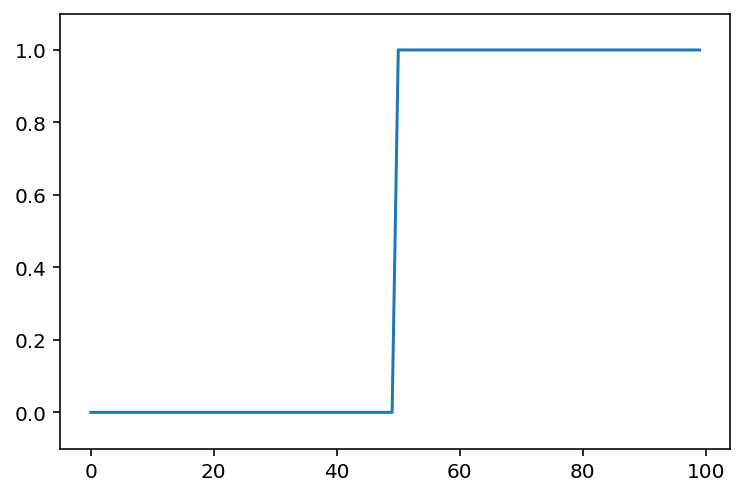

In [29]:
step_signal = np.zeros(100)
step_signal[50:] = 1
fig, ax = plt.subplots()
ax.plot(step_signal)
ax.margins(y=0.1)

Now add some noise to this signal:

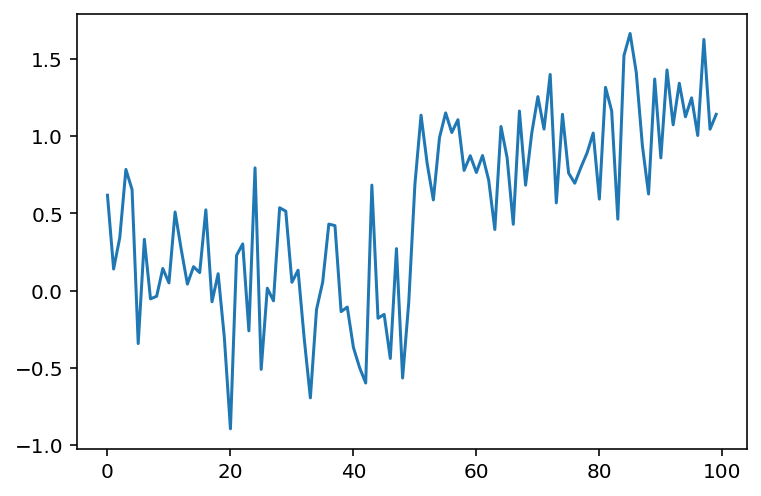

In [30]:
# Just to make sure we all see the same results
np.random.seed(0)


noisy_signal = (step_signal
                + np.random.normal(0, 0.35, step_signal.shape))
fig, ax = plt.subplots()
ax.plot(noisy_signal);

The simplest way to recover something that looks a bit more like the original signal is to take the average between neighboring "pixels":

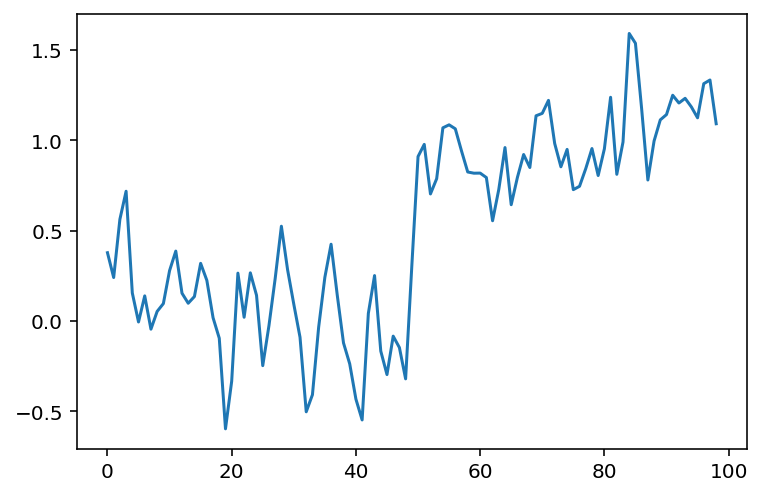

In [31]:
# Take the mean of neighboring pixels
smooth_signal = (noisy_signal[:-1] + noisy_signal[1:]) / 2.0
fig, ax = plt.subplots()
ax.plot(smooth_signal);

What happens if we want to take the *three* neighboring pixels? We can do the same thing:

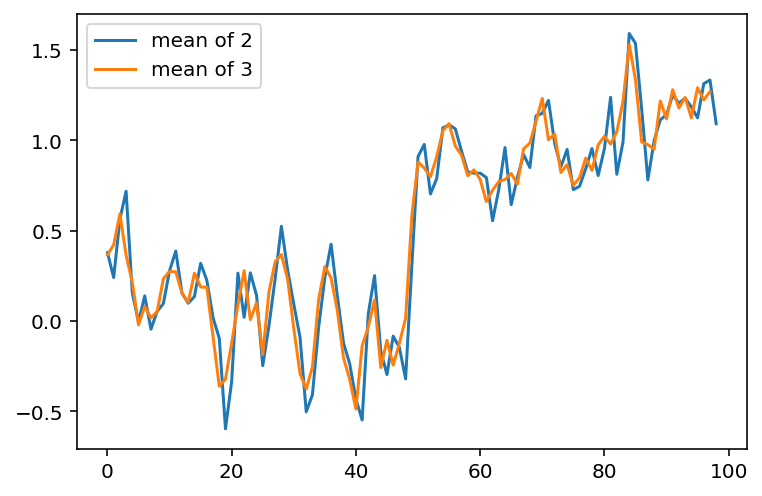

In [32]:
smooth_signal3 = (noisy_signal[:-2] + noisy_signal[1:-1]
                  + noisy_signal[2:]) / 3
fig, ax = plt.subplots()
ax.plot(smooth_signal, label='mean of 2')
ax.plot(smooth_signal3, label='mean of 3')
ax.legend(loc='upper left');

For averages of more points, the expression keeps getting hairier. And you have to worry more about what's going on in the margins. Is there a better way?

It turns out there is. This same concept, nearest-neighbor averages, can be expressed as a *convolution* with an *averaging kernel*. Note that the operation we did with `smooth_signal3` can be expressed as follows:

* Create an output array called `smooth_signal3`, of the same length as `noisy_signal`.
* At each element in `smooth_signal3` starting at point 1, and ending at point -2, place the average of the sum of: 1/3 of the element to the left of it in `noisy_signal`, 1/3 of the element at the same position, and 1/3 of the element to the right.
* discard the leftmost and rightmost elements.

This is called a *convolution* between the input image and the array `[1/3, 1/3, 1/3]`. (We'll give a more in-depth explanation of convolution in the next section).

smooth_signal3 and smooth_signal3p are equal: True


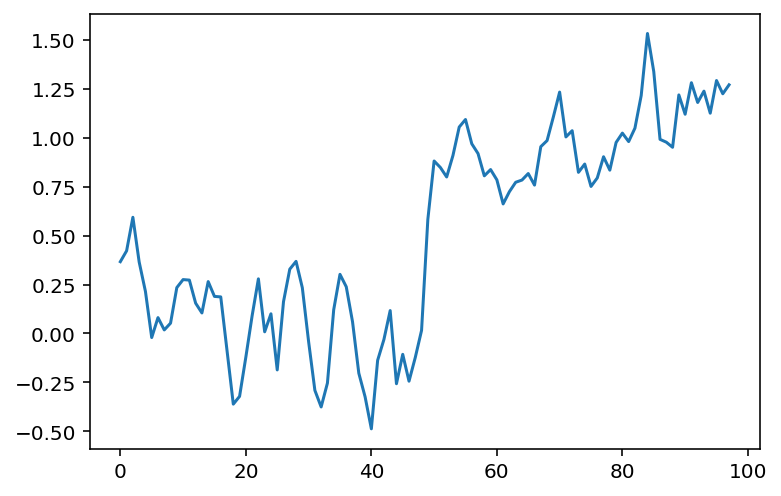

In [33]:
# Same as above, using a convolution kernel
# Neighboring pixels multiplied by 1/3 and summed
mean_kernel3 = np.full((3,), 1/3)
smooth_signal3p = np.convolve(noisy_signal, mean_kernel3,
                              mode='valid')
fig, ax = plt.subplots()
ax.plot(smooth_signal3p)

print('smooth_signal3 and smooth_signal3p are equal:',
      np.allclose(smooth_signal3, smooth_signal3p))

In [34]:
def convolve_demo(signal, kernel):
    ksize = len(kernel)
    convolved = np.correlate(signal, kernel)
    def filter_step(i):
        fig, ax = plt.subplots()
        ax.plot(signal, label='signal')
        ax.plot(convolved[:i+1], label='convolved')
        ax.legend()
        ax.scatter(np.arange(i, i+ksize),
                   signal[i : i+ksize])
        ax.scatter(i, convolved[i])
    return filter_step

from ipywidgets import interact, widgets

i_slider = widgets.IntSlider(min=0, max=len(noisy_signal) - 3,
                             value=0)

interact(convolve_demo(noisy_signal, mean_kernel3),
         i=i_slider);

interactive(children=(IntSlider(value=0, description='i', max=97), Output()), _dom_classes=('widget-interact',…

The advantage of convolution is that it's just as easy to take the average of 11 points as 3:

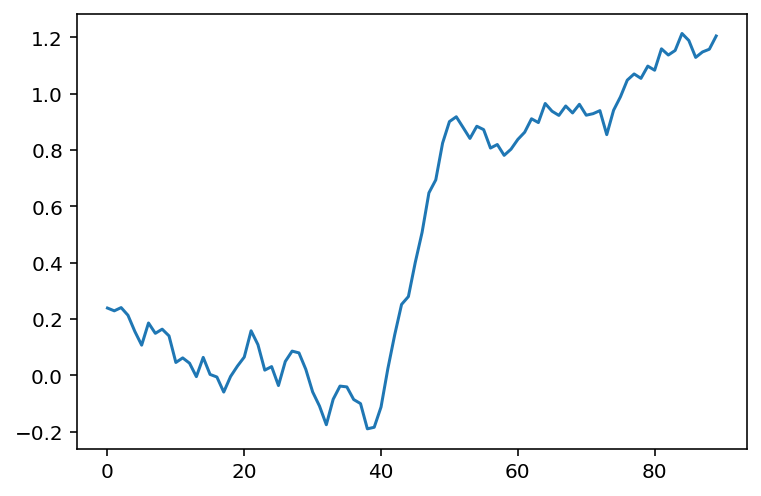

In [35]:
mean_kernel11 = np.full((11,), 1/11)
smooth_signal11 = np.convolve(noisy_signal, mean_kernel11,
                              mode='valid')
fig, ax = plt.subplots()
ax.plot(smooth_signal11);

In [36]:
i_slider = widgets.IntSlider(min=0, max=len(noisy_signal) - 11,
                             value=0)

interact(convolve_demo(noisy_signal, mean_kernel11),
         i=i_slider);

interactive(children=(IntSlider(value=0, description='i', max=89), Output()), _dom_classes=('widget-interact',…

Of course, to take the mean of 11 values, we have to move further and further away from the edges, and this starts to be noticeable. You can use `mode='same'` to pad the edges of the array and compute a result of the same size as the input:

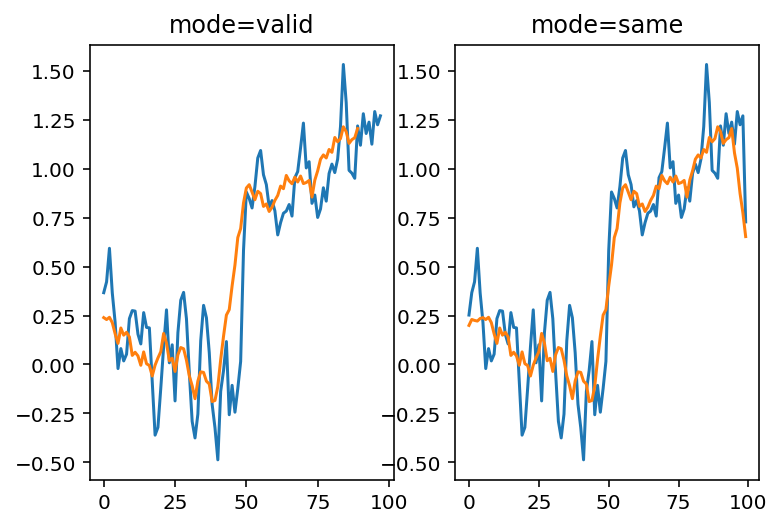

In [37]:
smooth_signal3same = np.convolve(noisy_signal, mean_kernel3,
                                 mode='same')
smooth_signal11same = np.convolve(noisy_signal, mean_kernel11,
                                  mode='same')

fig, ax = plt.subplots(1, 2)
ax[0].plot(smooth_signal3p)
ax[0].plot(smooth_signal11)
ax[0].set_title('mode=valid')
ax[1].plot(smooth_signal3same)
ax[1].plot(smooth_signal11same)
ax[1].set_title('mode=same');

But now we see edge effects on the ends of the signal...

This is because `mode='same'` actually pads the signal with 0s and then applies `mode='valid'` as before.

In [38]:
def convolve_demo_same(signal, kernel):
    ksize = len(kernel)
    padded_signal = np.pad(signal, ksize // 2,
                           mode='constant')
    convolved = np.correlate(padded_signal, kernel)
    def filter_step(i):
        fig, ax = plt.subplots()
        x = np.arange(-ksize // 2,
                      len(signal) + ksize // 2)
        ax.plot(signal, label='signal')
        ax.plot(convolved[:i+1], label='convolved')
        ax.legend()
        start, stop = i, i + ksize
        ax.scatter(x[start:stop]+1,
                   padded_signal[start : stop])
        ax.scatter(i, convolved[i])
        ax.set_xlim(-ksize // 2,
                    len(signal) + ksize // 2)
    return filter_step


i_slider = widgets.IntSlider(min=0, max=len(noisy_signal)-1,
                             value=0)

interact(convolve_demo_same(noisy_signal, mean_kernel11),
         i=i_slider);

interactive(children=(IntSlider(value=0, description='i', max=99), Output()), _dom_classes=('widget-interact',…

**Exercise** Look up the documentation of `scipy.ndimage.convolve`. Apply the same convolution, but using a different `mode=` keyword argument to avoid the edge effects we see here.

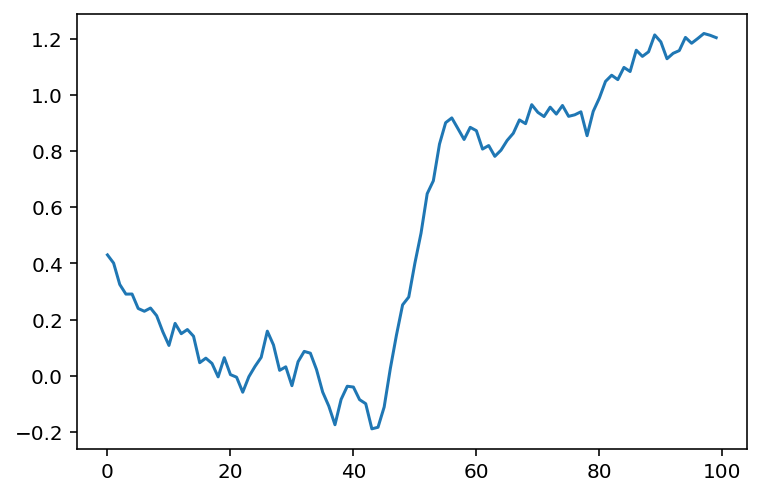

In [39]:
# %load convolve_mode.py

from scipy import ndimage as ndi

smooth_ndi = ndi.convolve(noisy_signal, mean_kernel11,
                          mode='reflect')

plt.plot(smooth_ndi)


#### A difference filter

Let's look again at our simplest signal, the step signal from before:

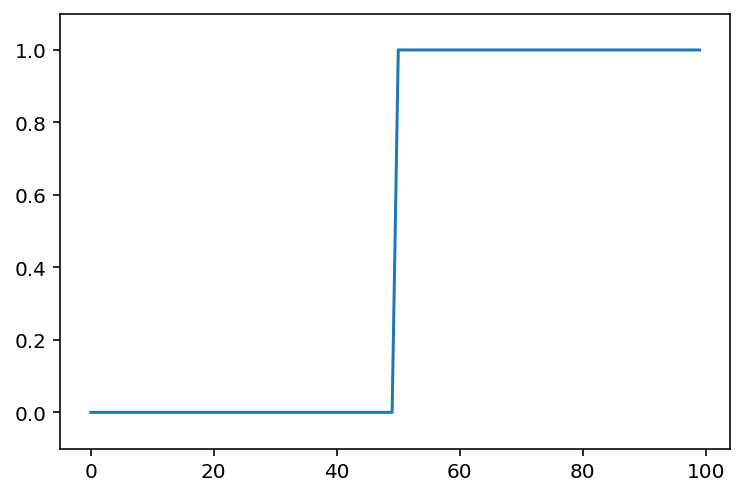

In [40]:
fig, ax = plt.subplots()
ax.plot(step_signal)
ax.margins(y=0.1) 

**Exercise:** Can you predict what a convolution with the kernel `[-1, 0, 1]` does? Try thinking about it before running the cells below.

In [41]:
result_corr = np.correlate(step_signal, np.array([-1, 0, 1]),
                           mode='valid')

In [42]:
result_conv = np.convolve(step_signal, np.array([-1, 0, 1]),
                          mode='valid')

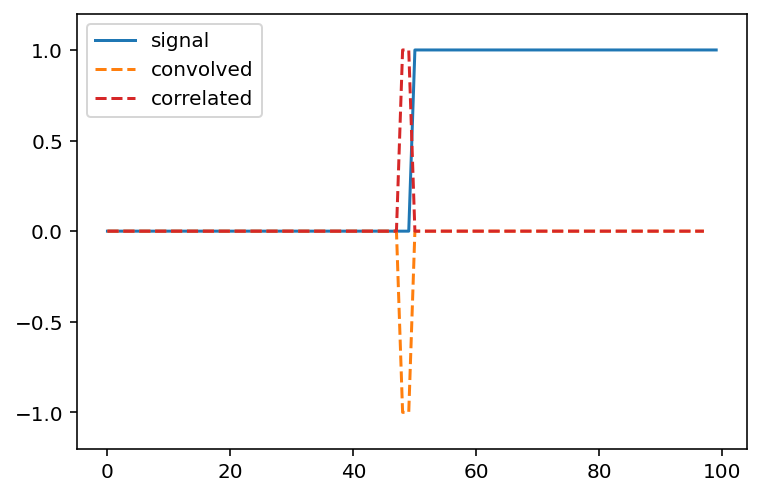

In [43]:
fig, ax = plt.subplots()
ax.plot(step_signal, label='signal')
ax.plot(result_conv, linestyle='dashed', label='convolved')
ax.plot(result_corr, linestyle='dashed', label='correlated',
        color='C3')
ax.legend(loc='upper left')
ax.margins(y=0.1) 

(For technical signal processing reasons, convolutions actually occur "back to front" between the input array and the kernel. Correlations occur in the signal order, so we'll use correlate from now on.)

Whenever neighboring values are close, the filter response is close to 0. Right at the boundary of a step, we're subtracting a small value from a large value and and get a spike in the response. This spike "identifies" our edge.

#### Commutativity and assortativity of filters

What if we try the same trick with our noisy signal?

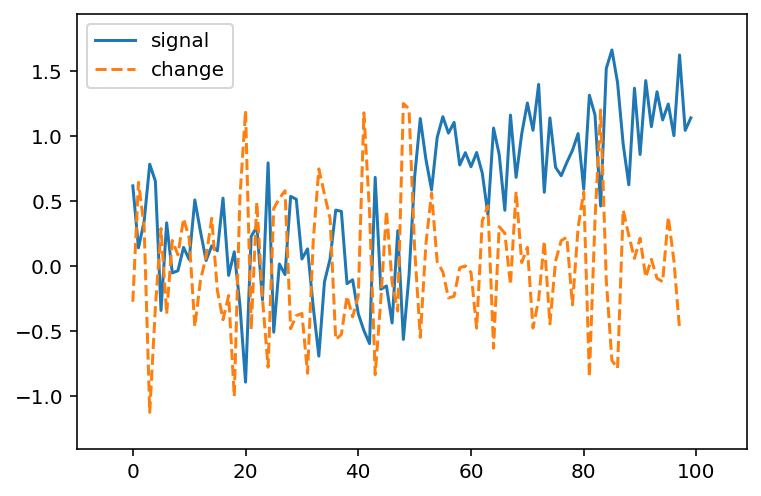

In [44]:
noisy_change = np.correlate(noisy_signal, np.array([-1, 0, 1]))
fig, ax = plt.subplots()
ax.plot(noisy_signal, label='signal')
ax.plot(noisy_change, linestyle='dashed', label='change')
ax.legend(loc='upper left')
ax.margins(0.1)

Oops! We lost our edge!

But recall that we smoothed the signal a bit by taking its neighbors. Perhaps we can do the same thing here. Actually, it turns out that we can do it *in any order*, so we can create a filter that combines both the difference and the mean:

In [45]:
mean_diff = np.correlate([-1, 0, 1], [1/3, 1/3, 1/3], mode='full')
print(mean_diff)

[-0.33333333 -0.33333333  0.          0.33333333  0.33333333]


*Note:* we use `np.convolve` here, because it has the option to output a *wider* result than either of the two inputs.

Now we can use this to find our edge even in a noisy signal:

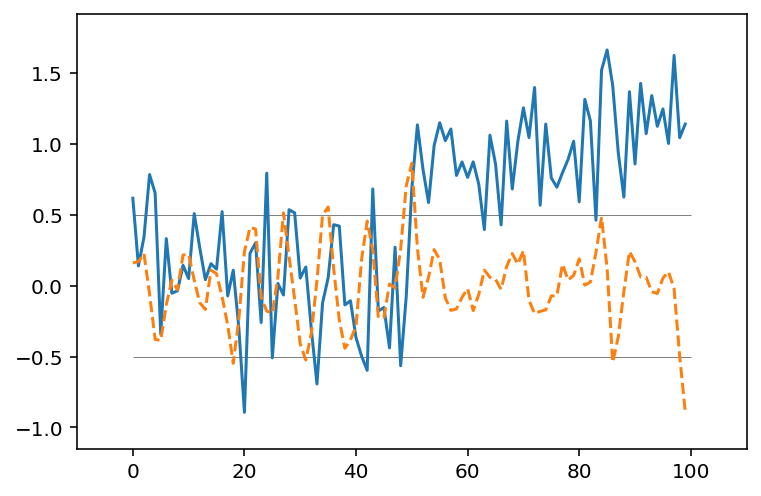

In [46]:
smooth_change = np.correlate(noisy_signal, mean_diff,
                             mode='same')
fig, ax = plt.subplots()
ax.plot(noisy_signal, label='signal')
ax.plot(smooth_change, linestyle='dashed', label='change')
ax.margins(0.1)
ax.hlines([-0.5, 0.5], 0, 100, linewidth=0.5, color='gray');

# This is an edge detector in 1D!

**Exercise:** The Gaussian filter with variance $\sigma^2$ is given by:

$$
k_i = \frac{1}{\sqrt{2\pi}\sigma}\exp{\left(-\frac{(x_i - x_0)^2}{2\sigma^2}\right)}
$$

1. Create this filter (for example, with width 9, center 4, sigma 1). (Plot it)
2. Convolve it with the difference filter (with appropriate mode). (Plot the result)
3. Convolve it with the noisy signal. (Plot the result)

In [47]:
# defines evenly spaced values within an interval
xi = np.arange(9)

# floor divide
x0 = 9 // 2  # 4
x = xi - x0
...  # complete this code

Ellipsis

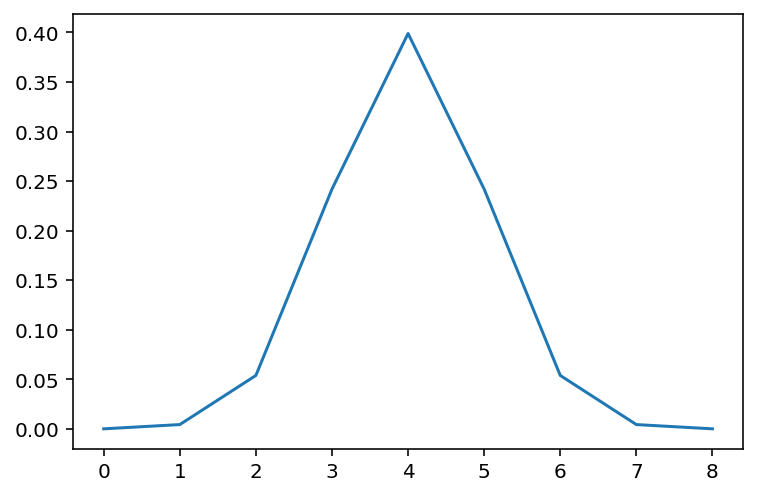

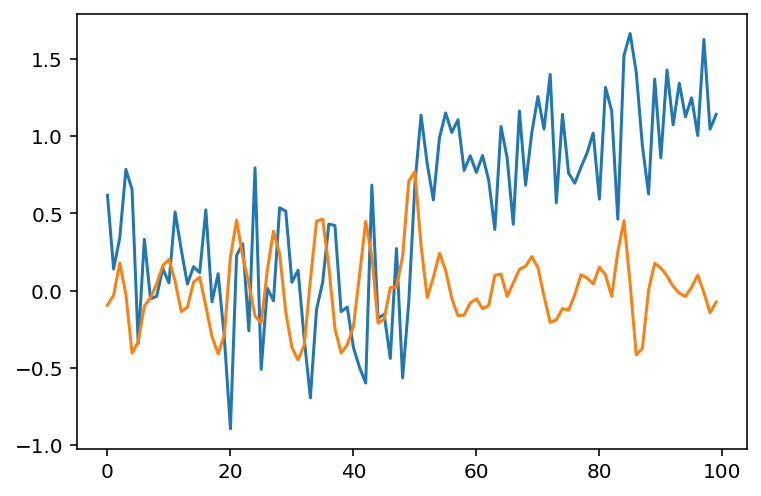

In [48]:
# %load gaussian_filter.py

xi = np.arange(9)
x0 = 9 // 2  # 4
x = xi - x0
sigma = 1
gaussian_kernel = (1/(np.sqrt(2*np.pi)*sigma) * 
                   np.exp(-(x**2) / 2*sigma**2))
fig = plt.figure()
plt.plot(gaussian_kernel)

## 2

gauss_diff = np.convolve(gaussian_kernel, [-1, 0, 1], mode='full')

## 3

smooth_diff = ndi.correlate(noisy_signal, gauss_diff, mode='reflect')

fig = plt.figure()
plt.plot(noisy_signal)
plt.plot(smooth_diff)


## Local filtering of images

Now let's apply all this knowledge to 2D images instead of a 1D signal. Let's start with an incredibly simple image:

In [49]:
import numpy as np

bright_square = np.zeros((7, 7), dtype=float)
bright_square[2:5, 2:5] = 1

This gives the values below:

In [50]:
print(bright_square)

[[0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 1. 1. 0. 0.]
 [0. 0. 1. 1. 1. 0. 0.]
 [0. 0. 1. 1. 1. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0.]]


and looks like a white square centered on a black square:

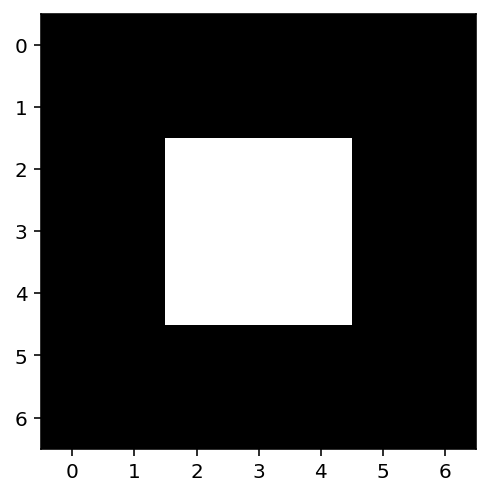

In [51]:
fig, ax = plt.subplots()
ax.imshow(bright_square);

### The mean filter

For our first example of a filter, consider the following filtering array, which we'll call a "mean kernel". For each pixel, a kernel defines which neighboring pixels to consider when filtering, and how much to weight those pixels.

In [52]:
mean_kernel = np.full((3, 3), 1/9)

print(mean_kernel)

[[0.11111111 0.11111111 0.11111111]
 [0.11111111 0.11111111 0.11111111]
 [0.11111111 0.11111111 0.11111111]]


Now, let's take our mean kernel and apply it to every pixel of the image.

Applying a (linear) filter essentially means:
* Center a kernel on a pixel
* Multiply the pixels *under* that kernel by the values *in* the kernel
* Sum all the those results
* Replace the center pixel with the summed result

This process is known as convolution.

Let's take a look at the numerical result:

In [53]:
import scipy.ndimage as ndi

%precision 2
print(bright_square)
print(ndi.correlate(bright_square, mean_kernel))

[[0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 1. 1. 0. 0.]
 [0. 0. 1. 1. 1. 0. 0.]
 [0. 0. 1. 1. 1. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0.]]
[[0.   0.   0.   0.   0.   0.   0.  ]
 [0.   0.11 0.22 0.33 0.22 0.11 0.  ]
 [0.   0.22 0.44 0.67 0.44 0.22 0.  ]
 [0.   0.33 0.67 1.   0.67 0.33 0.  ]
 [0.   0.22 0.44 0.67 0.44 0.22 0.  ]
 [0.   0.11 0.22 0.33 0.22 0.11 0.  ]
 [0.   0.   0.   0.   0.   0.   0.  ]]


The meaning of "mean kernel" should be clear now: Each pixel was replaced with the mean value within the 3x3 neighborhood of that pixel. When the kernel was over `n` bright pixels, the pixel in the kernel's center was changed to n/9 (= n * 0.111). When no bright pixels were under the kernel, the result was 0.

This filter is a simple smoothing filter and produces two important results:
1. The intensity of the bright pixel decreased.
2. The intensity of the region near the bright pixel increased.

Let's see a convolution in action.

(Execute the following cell, but don't try to read it; its purpose is to generate an example.)

In [54]:
#--------------------------------------------------------------------------
#  Convolution Demo
#--------------------------------------------------------------------------
from skimage import color
from scipy import ndimage as ndi
from matplotlib import patches

def mean_filter_demo(image, vmax=1):
    mean_factor = 1.0 / 9.0  # This assumes a 3x3 kernel.
    iter_kernel_and_subimage = iter_kernel(image)

    image_cache = []

    def mean_filter_step(i_step):
        while i_step >= len(image_cache):
            filtered = image if i_step == 0 else image_cache[-1][-1][-1]
            filtered = filtered.copy()

            (i, j), mask, subimage = next(iter_kernel_and_subimage)
            filter_overlay = color.label2rgb(mask, image, bg_label=0,
                                             colors=('cyan', 'red'))
            filtered[i, j] = np.sum(mean_factor * subimage)
            image_cache.append(((i, j), (filter_overlay, filtered)))

        (i, j), images = image_cache[i_step]
        fig, axes = plt.subplots(1, len(images), figsize=(10, 5))
        
        for ax, imc in zip(axes, images):
            ax.imshow(imc, vmax=vmax)
            rect = patches.Rectangle([j - 0.5, i - 0.5], 1, 1, color='yellow', fill=False)
            ax.add_patch(rect)
            
        plt.show()
    return mean_filter_step


def mean_filter_interactive_demo(image):
    from ipywidgets import IntSlider, interact
    mean_filter_step = mean_filter_demo(image)
    step_slider = IntSlider(min=0, max=image.size-1, value=0)
    interact(mean_filter_step, i_step=step_slider)


def iter_kernel(image, size=1):
    """ Yield position, kernel mask, and image for each pixel in the image.

    The kernel mask has a 2 at the center pixel and 1 around it. The actual
    width of the kernel is 2*size + 1.
    """
    width = 2*size + 1
    for (i, j), pixel in iter_pixels(image):
        mask = np.zeros(image.shape, dtype='int16')
        mask[i, j] = 1
        mask = ndi.grey_dilation(mask, size=width)
        #mask[i, j] = 2
        subimage = image[bounded_slice((i, j), image.shape[:2], size=size)]
        yield (i, j), mask, subimage


def iter_pixels(image):
    """ Yield pixel position (row, column) and pixel intensity. """
    height, width = image.shape[:2]
    for i in range(height):
        for j in range(width):
            yield (i, j), image[i, j]


def bounded_slice(center, xy_max, size=1, i_min=0):
    slices = []
    for i, i_max in zip(center, xy_max):
        slices.append(slice(max(i - size, i_min), min(i + size + 1, i_max)))
    return tuple(slices)



In [55]:
mean_filter_interactive_demo(bright_square)

interactive(children=(IntSlider(value=0, description='i_step', max=48), Output()), _dom_classes=('widget-inter…

Incidentally, the above filtering is the exact same principle behind the *convolutional neural networks*, or CNNs, that you might have heard much about over the past few years. The only difference is that while above, the simple mean kernel is used, in CNNs, the values inside the kernel are *learned* to find a specific feature, or accomplish a specific task. Time permitting, we'll demonstrate this in an exercise at the end of the notebook.

Slight aside:

In [56]:
print(np.sum(mean_kernel))

1.0


Note that all the values of the kernel sum to 1. Why might that be important?

### Downsampled image

Let's consider a real image now. It'll be easier to see some of the filtering we're doing if we downsample the image a bit. We can slice into the image using the "step" argument to sub-sample it (don't scale images using this method for real work; use `skimage.transform.rescale`):

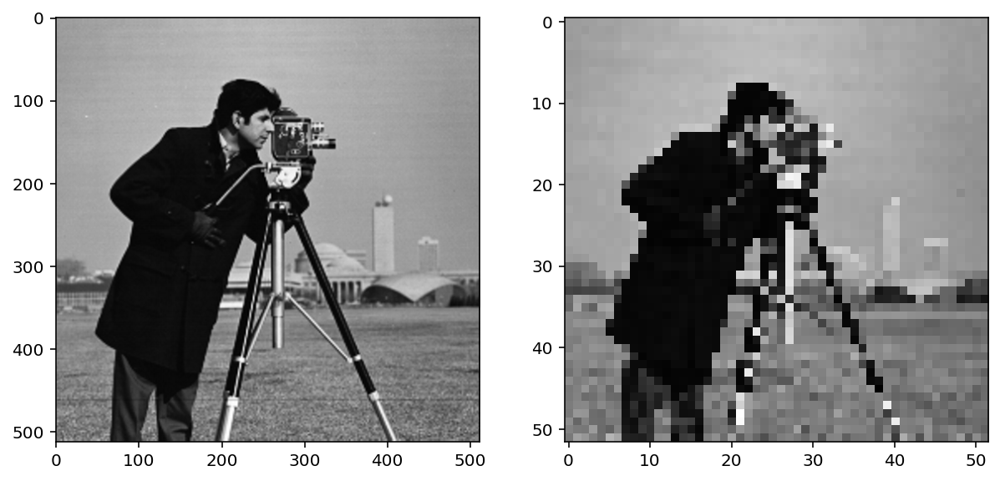

In [57]:
from skimage import data

image = data.camera()
pixelated = image[::10, ::10]
fig, (ax0, ax1) = plt.subplots(1, 2, figsize=(10, 5))
ax0.imshow(image)
ax1.imshow(pixelated) ;

Here we use a step of 10, giving us every tenth column and every tenth row of the original image. You can see the highly pixelated result on the right.

We are actually going to be using the pattern of plotting multiple images side by side quite often, so we are going to make the following helper function:

In [58]:
from skimage import img_as_float

def imshow_all(*images, titles=None):
    images = [img_as_float(img) for img in images]

    if titles is None:
        titles = [''] * len(images)
    vmin = min(map(np.min, images))
    vmax = max(map(np.max, images))
    ncols = len(images)
    height = 5
    width = height * len(images)
    fig, axes = plt.subplots(nrows=1, ncols=ncols,
                             figsize=(width, height))
    for ax, img, label in zip(axes.ravel(), images, titles):
        ax.imshow(img, vmin=vmin, vmax=vmax)
        ax.set_title(label)


### Mean filter on a real image

Now we can apply the filter to this downsampled image:

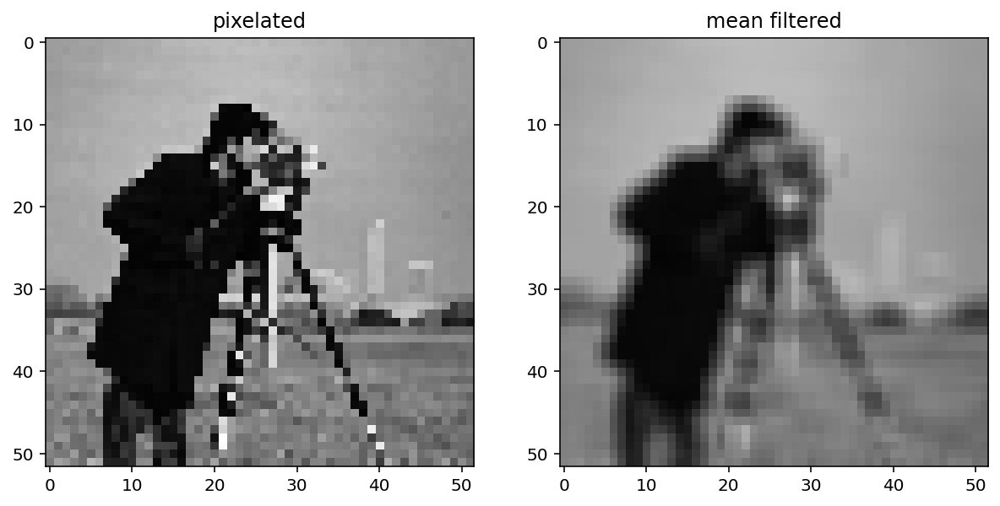

In [59]:
filtered = ndi.correlate(pixelated, mean_kernel)
imshow_all(pixelated, filtered, titles=['pixelated', 'mean filtered'])

Comparing the filtered image to the pixelated image, we can see that this filtered result is smoother: Sharp edges (which are just borders between dark and bright pixels) are smoothed because dark pixels reduce the intensity of neighboring pixels and bright pixels do the opposite.

## Essential filters

If you read through the last section, you're already familiar with the essential concepts of image filtering. But, of course, you don't have to create custom filter kernels for all of your filtering needs. There are many standard filter kernels pre-defined from half a century of image and signal processing.

### Gaussian filter

The classic image filter is the Gaussian filter. This is similar to the mean filter, in that it tends to smooth images. The Gaussian filter, however, doesn't weight all values in the neighborhood equally. Instead, pixels closer to the center are weighted more than those farther away.

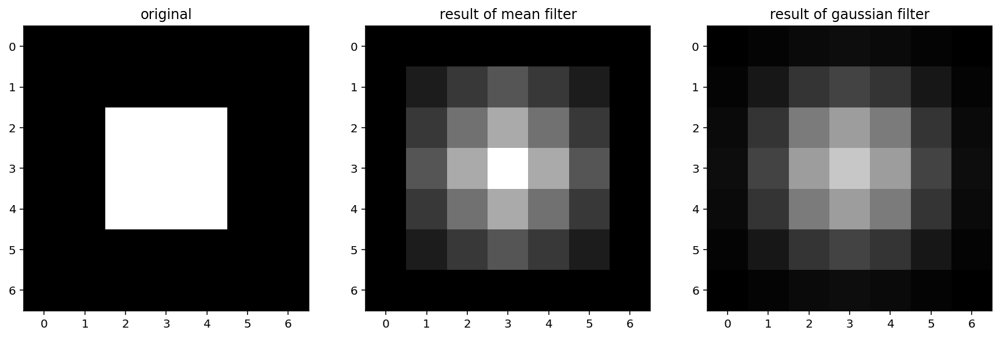

In [60]:
# Rename module so we don't shadow the builtin function
from skimage import filters

smooth_mean = ndi.correlate(bright_square, mean_kernel)
sigma = 1
smooth = filters.gaussian(bright_square, sigma)
imshow_all(bright_square, smooth_mean, smooth,
           titles=['original', 'result of mean filter', 'result of gaussian filter'])

For the Gaussian filter, `sigma`, the standard deviation, defines the size of the neighborhood.

For a real image, we get the following:

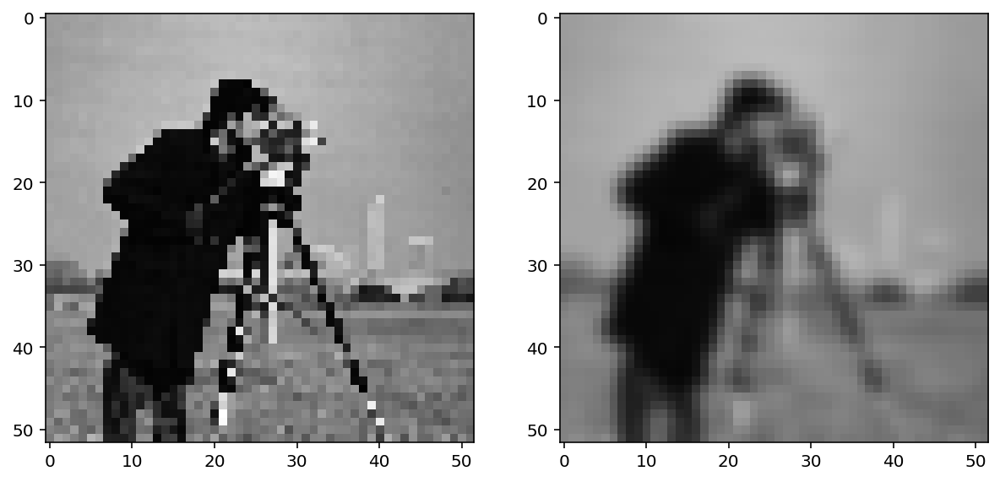

In [61]:
from skimage import img_as_float
# The Gaussian filter returns a float image, regardless of input.
# Cast to float so the images have comparable intensity ranges.
pixelated_float = img_as_float(pixelated)
smooth = filters.gaussian(pixelated_float, sigma=1)
imshow_all(pixelated_float, smooth)

This doesn't look drastically different than the mean filter, but the Gaussian filter is typically preferred because of the distance-dependent weighting, and because it does not have any sharp transitions (consider what happens in the Fourier domain!). For a more detailed image and a larger filter, you can see artifacts in the mean filter since it doesn't take distance into account:

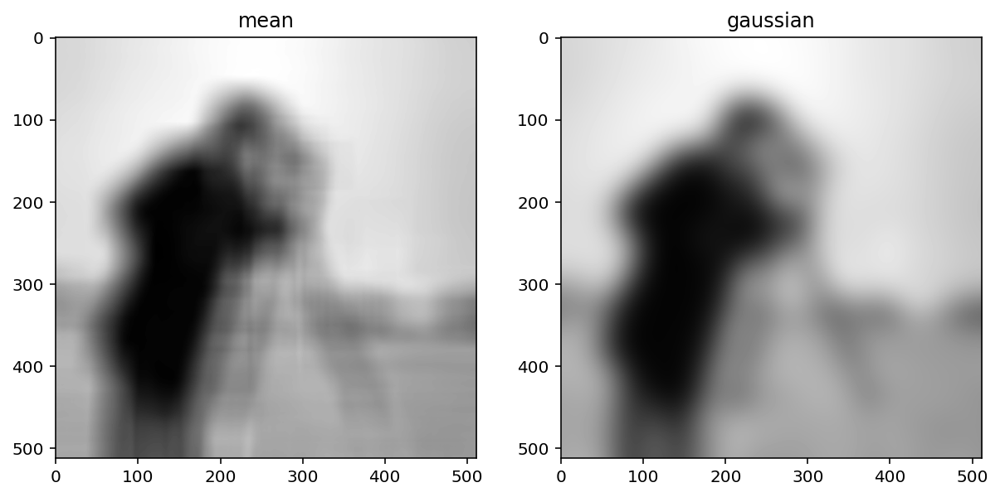

In [62]:
size = 20
structuring_element = np.ones((3*size, 3*size))
smooth_mean = filters.rank.mean(image, structuring_element)
smooth_gaussian = filters.gaussian(image, size)
titles = ['mean', 'gaussian']
imshow_all(smooth_mean, smooth_gaussian, titles=titles)

(Above, we've tweaked the size of the structuring element used for the mean filter and the standard deviation of the Gaussian filter to produce an approximately equal amount of smoothing in the two results.)

Incidentally, for reference, let's have a look at what the Gaussian filter actually looks like. Technically, the value of the kernel at a pixel that is $r$ rows and $c$ cols from the center is:

$$
k_{r, c} = \frac{1}{2\pi \sigma^2} \exp{\left(-\frac{r^2 + c^2}{2\sigma^2}\right)}
$$

Practically speaking, this value is pretty close to zero for values more than $4\sigma$ away from the center, so practical Gaussian filters are truncated at about $4\sigma$:

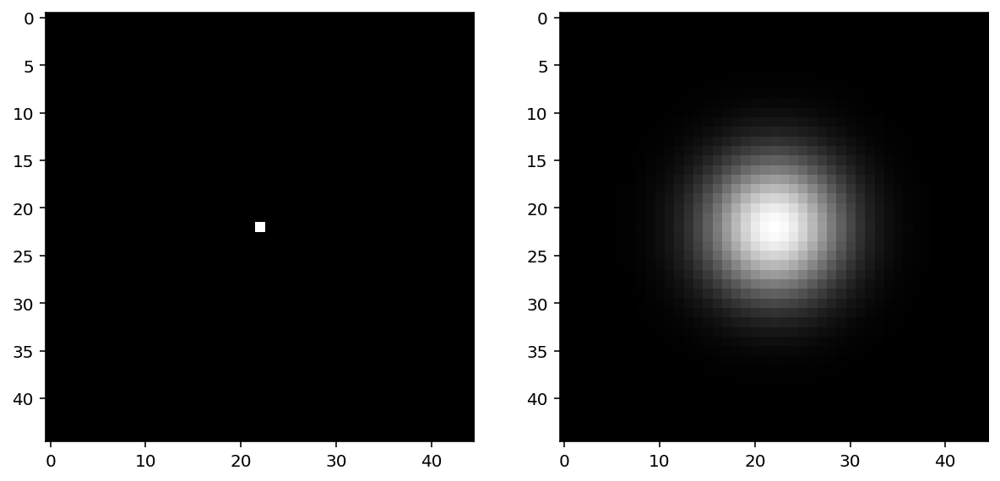

In [63]:
sidelen = 45
sigma = (sidelen - 1) // 2 // 4
spot = np.zeros((sidelen, sidelen), dtype=float)
spot[sidelen // 2, sidelen // 2] = 1
kernel = filters.gaussian(spot, sigma=sigma)

imshow_all(spot, kernel / np.max(kernel))

**Exercise** (Chapter 0 reminder!) Plot the profile of the gaussian kernel at its midpoint, i.e. the values under the line shown here:

(44.00, 0.00)

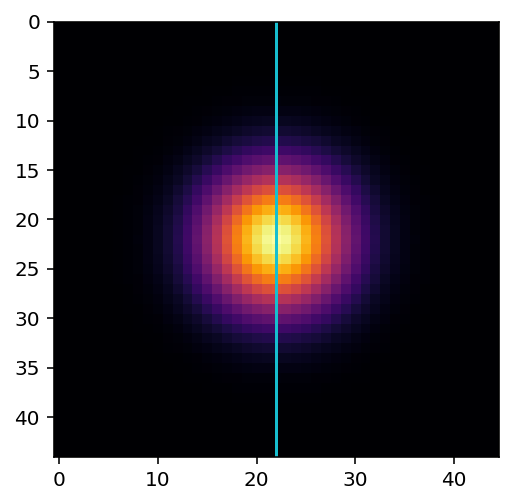

In [64]:
fig, ax = plt.subplots()

ax.imshow(kernel, cmap='inferno')
ax.vlines(22, -100, 100, color='C9')
ax.set_ylim((sidelen - 1, 0))

In [65]:
...  # add your plotting code here

Ellipsis

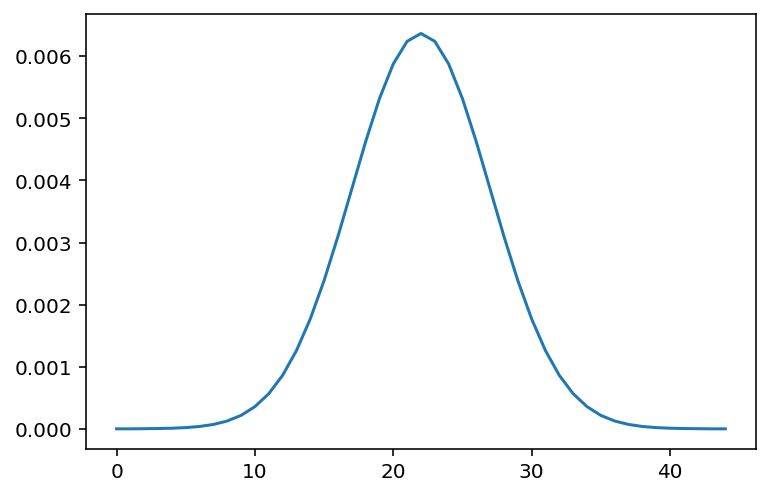

In [66]:
# %load line_extraction.py

profile = kernel[:, kernel.shape[1] // 2]
plt.plot(profile)


### Basic edge filtering

For images, edges are boundaries between light and dark values. The detection of edges can be useful on its own, or it can be used as preliminary step in other algorithms (which we'll see later).

#### Difference filters in 2D

For images, you can think of an edge as points where the gradient is large in one direction. We can approximate gradients with difference filters.

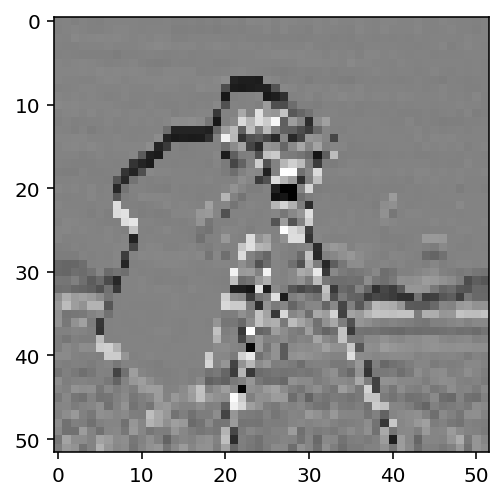

In [67]:
vertical_kernel = np.array([
    [-1],
    [ 0],
    [ 1],
])

gradient_vertical = ndi.correlate(pixelated.astype(float),
                                  vertical_kernel)
fig, ax = plt.subplots()
ax.imshow(gradient_vertical);

## <span style="color:cornflowerblue">Exercise:</span>

- Add a horizontal kernel to the above example to also compute the horizontal gradient, $g_y$
- Compute the magnitude of the image gradient at each point: $\left|g\right| = \sqrt{g_x^2 + g_y^2}$

In [68]:
...  # add your horizontal and gradient magnitude code here

Ellipsis

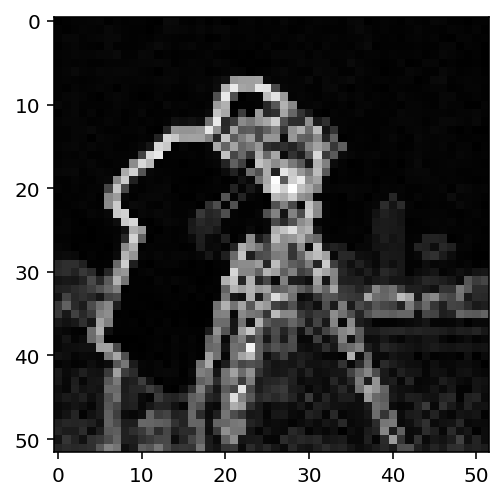

In [69]:
# %load vertical_edge_filter.py

horizontal_kernel = vertical_kernel.T

gradient_horizontal = ndi.correlate(pixelated.astype(float), horizontal_kernel,
                                    mode='reflect')

gradient_mag = np.sqrt(gradient_vertical**2 + gradient_horizontal**2)
plt.imshow(gradient_mag)


### Sobel edge filter

The Sobel filter, the most commonly used edge filter, should look pretty similar to what you developed above. Take a look at the vertical and horizontal components of the Sobel kernel to see how they differ from your earlier implementation:

* http://scikit-image.org/docs/dev/api/skimage.filters.html#skimage.filters.sobel_v
* http://scikit-image.org/docs/dev/api/skimage.filters.html#skimage.filters.sobel_h

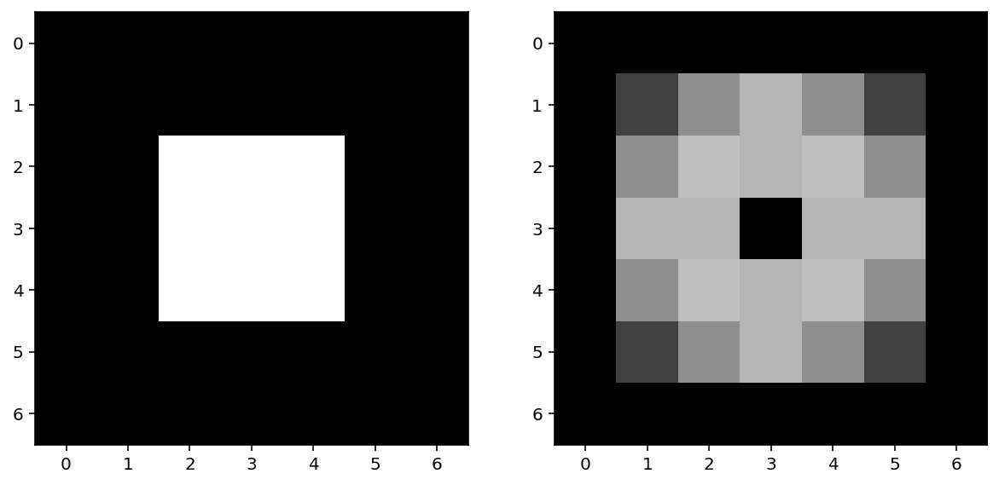

In [70]:
imshow_all(bright_square, filters.sobel(bright_square))

Notice that the size of the output matches the input, and the edges aren't preferentially shifted to a corner of the image. Furthermore, the weights used in the Sobel filter produce diagonal edges with reponses that are comparable to horizontal or vertical edges.

Like any derivative, noise can have a strong impact on the result:

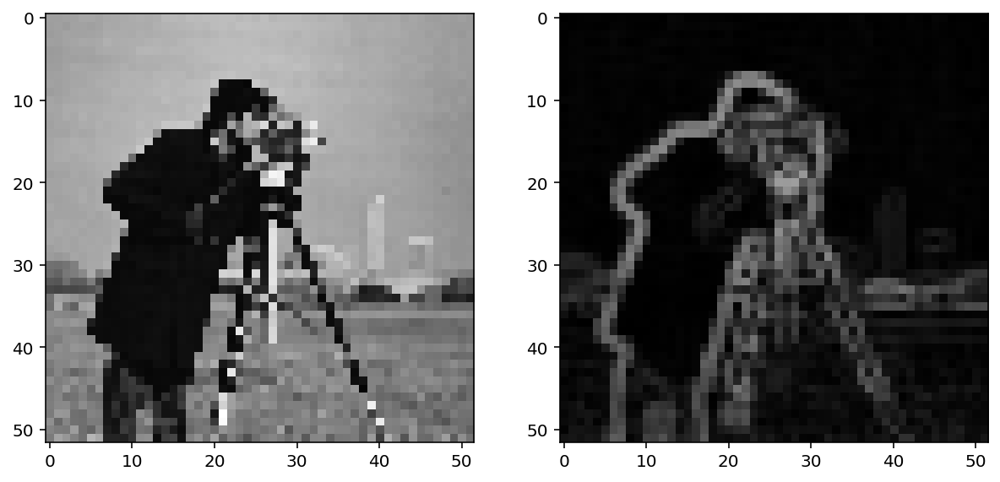

In [71]:
pixelated_gradient = filters.sobel(pixelated)
imshow_all(pixelated, pixelated_gradient)

Smoothing is often used as a preprocessing step in preparation for feature detection and image-enhancement operations because sharp features can distort results.

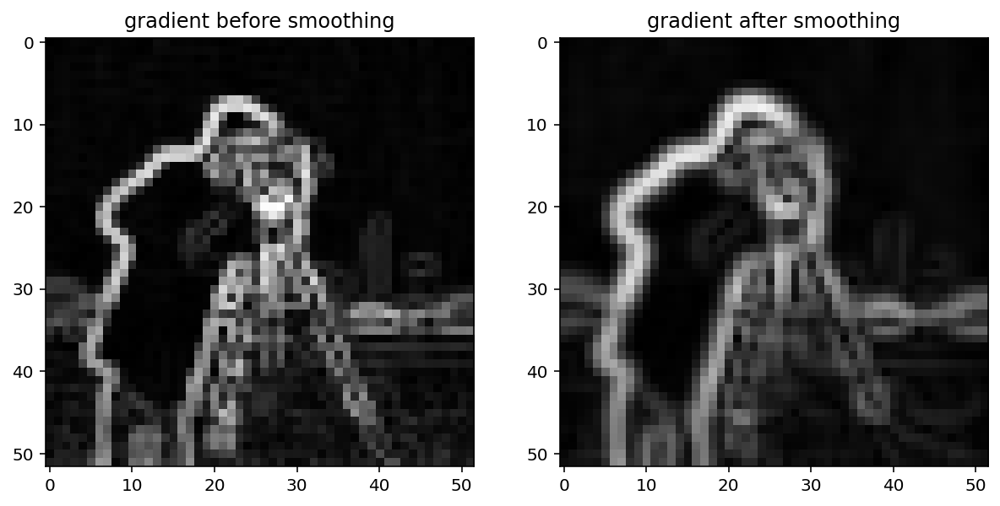

In [72]:
gradient = filters.sobel(smooth)
titles = ['gradient before smoothing', 'gradient after smoothing']
# Scale smoothed gradient up so they're of comparable brightness.
imshow_all(pixelated_gradient, gradient*1.8, titles=titles)

Notice how the edges look more continuous in the smoothed image.

The simplest neural network.** Let's pretend we have an image and a "ground truth" image of what we want to detect:

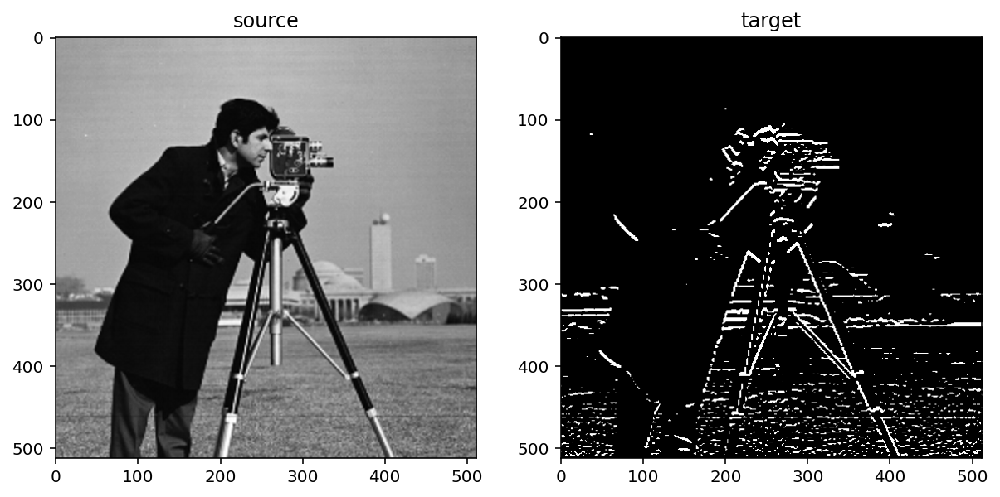

In [73]:
target = (filters.sobel_h(image) > 0.07)
imshow_all(image, target, titles=['source', 'target'])

Can we use machine learning to find a 3x3 convolutional filter that recovers this target?

- use `skimage.util.view_as_windows` and `np.reshape` to view the image as a set of (approximately) `npixels` 3x3 patches. (Hint: why is it only approximate? Think of `mode=valid` convolutions.)
- use `np.reshape` again to see it as `npixels` "linear" patches of 9 pixels.
- Now you have an `(npixels, 9)` "feature" matrix, `X`.
- Use slicing and `np.ravel` to get an `npixels`-length array of target values.
- Use `sklearn.linear_model.LogisticRegression` to learn the relationship between our pixel neighborhoods (of size 9) and the target.
- Look at your `model.coef_`. How do they compare to the Sobel coefficients?

In [74]:
# prints the size of the image
print(image.shape)

(512, 512)


In [75]:
from skimage import util

# converts image into convolution windows
windows = util.view_as_windows(image, (3, 3))
print(windows.shape)

(510, 510, 3, 3)


In [76]:
# reshapes the input for use in logistic regression
X = windows.reshape((510*510, 9))

In [77]:
# sets the target value for the logistic regression
y = target[1:-1, 1:-1].reshape((510*510,))

In [78]:
from sklearn.linear_model import LogisticRegression

# instantiates the logistic regression model
clf = LogisticRegression()

# fits the logistic regression model
clf.fit(X, y)

/Users/joshagar/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:764: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


LogisticRegression()

In [79]:
# outputs the coefficents from the learned logistic regression model
clf.coef_.reshape((3, 3))

array([[-0.59,  0.01, -0.8 ],
       [ 0.44, -1.19,  0.83],
       [ 0.09,  1.28, -0.1 ]])

## This looks just like sobel_h

---

## Denoising filters

At this point, we make a distinction. The earlier filters were implemented as a *linear dot-product* of values in the filter kernel and values in the image. The following kernels implement an *arbitrary* function of the local image neighborhood. Denoising filters in particular are filters that preserve the sharpness of edges in the image.

As you can see from our earlier examples, mean and Gaussian filters smooth an image rather uniformly, including the edges of objects in an image. When denoising, however, you typically want to preserve features and just remove noise. The distinction between noise and features can, of course, be highly situation-dependent and subjective.

### Median Filter

The median filter is the classic edge-preserving filter. As the name implies, this filter takes a set of pixels (i.e. the pixels within a kernel or "structuring element") and returns the median value within that neighborhood. Because regions near a sharp edge will have many dark values and many light values (but few values in between) the median at an edge will most likely be either light or dark, rather than some value in between. In that way, we don't end up with edges that are smoothed.

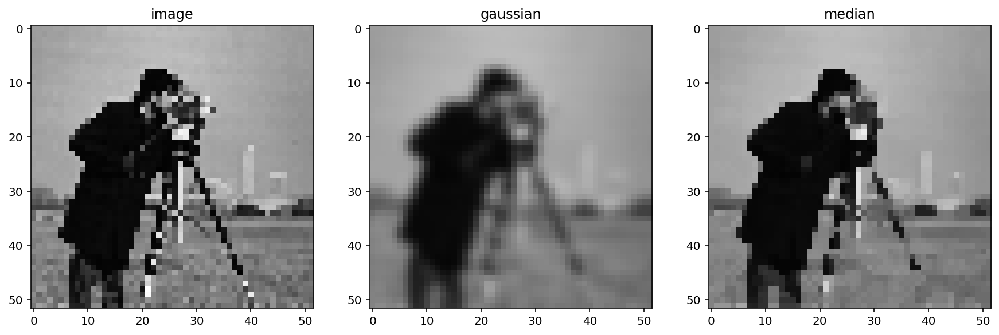

In [80]:
from skimage.morphology import disk
neighborhood = disk(radius=1)  # "selem" is often the name used for "structuring element"
median = filters.rank.median(pixelated, neighborhood)
titles = ['image', 'gaussian', 'median']
imshow_all(pixelated, smooth, median, titles=titles)

This difference is more noticeable with a more detailed image.

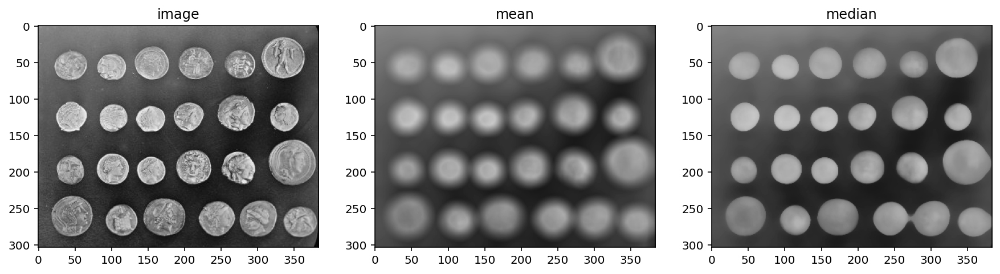

In [81]:
neighborhood = disk(10)
coins = data.coins()
mean_coin = filters.rank.mean(coins, neighborhood)
median_coin = filters.rank.median(coins, neighborhood)
titles = ['image', 'mean', 'median']
imshow_all(coins, mean_coin, median_coin, titles=titles)

Notice how the edges of coins are preserved after using the median filter.

## Further reading

`scikit-image` also provides more sophisticated denoising filters:

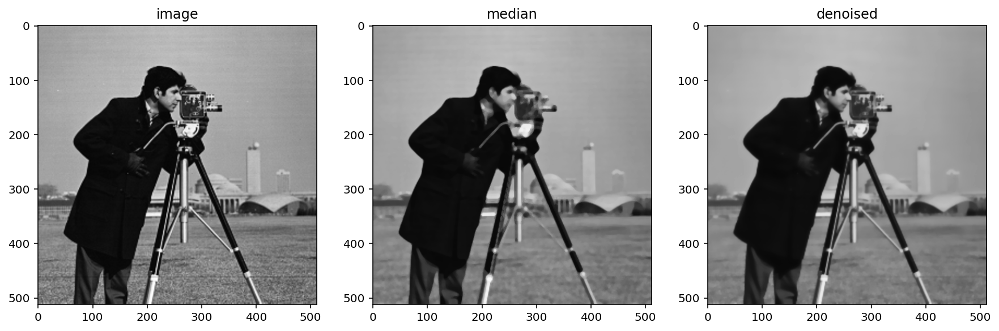

In [82]:
from skimage.restoration import denoise_tv_bregman
denoised = denoise_tv_bregman(image, 4)
d = disk(4)
median = filters.rank.median(image, d)
titles = ['image', 'median', 'denoised']
imshow_all(image, median, denoised, titles=titles)

---

<div style="height: 400px;"></div>

In [ ]:
%reload_ext load_style
%load_style ../themes/tutorial.css

* [Denoising examples](http://scikit-image.org/docs/dev/auto_examples/plot_denoise.html)
* [Rank filters example](http://scikit-image.org/docs/dev/auto_examples/applications/plot_rank_filters.html)
* [Restoration API](http://scikit-image.org/docs/stable/api/skimage.restoration.html)

Take a look at this [neat feature](https://github.com/scikit-image/scikit-image/pull/2647) merged last year:

![cycle spinning](./images/cycle_spin.png)

In [83]:
from __future__ import division, print_function
%matplotlib inline

# Feature detection

Feature detection is often the end result of image processing. We'll detect some basic features (edges, points, and circles) in this section, but there are a wealth of feature detectors that are available.

## Edge detection

Before we start, let's set the default colormap to grayscale and turn off pixel interpolation.

In [84]:
import matplotlib.pyplot as plt
import numpy as np

plt.rcParams['image.cmap'] = 'gray'
plt.rcParams['image.interpolation'] = 'none'

We've already discussed edge filtering, using the Sobel filter, in the last section.

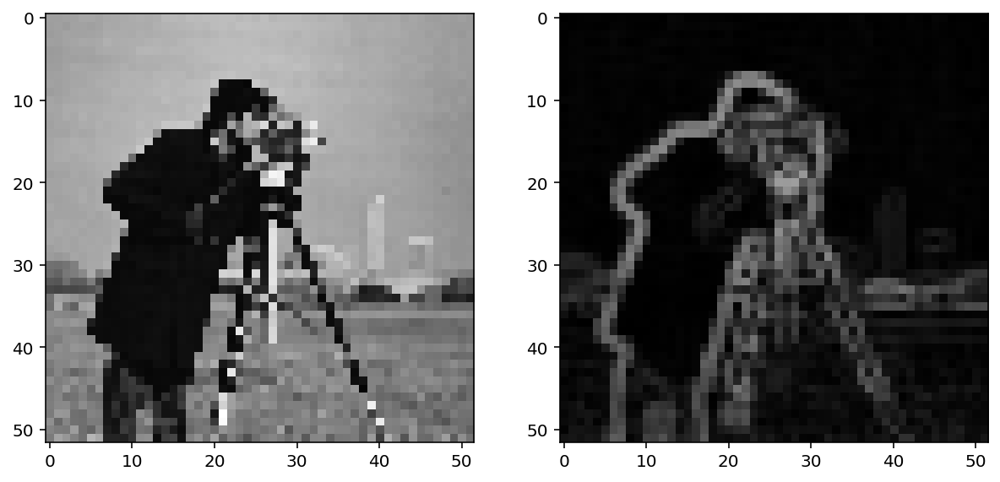

In [85]:
import skdemo
from skimage import data
# Rename module so we don't shadow the builtin function
import skimage.filters as filters

image = data.camera()
pixelated = image[::10, ::10]
gradient = filters.sobel(pixelated)
skdemo.imshow_all(pixelated, gradient)

With the Sobel filter, however, we get back a grayscale image, which essentially tells us the likelihood that a pixel is on the edge of an object.

We can apply a bit more logic to *detect* an edge; i.e. we can use that filtered image to make a *decision* whether or not a pixel is on an edge. The simplest way to do that is with thresholding:

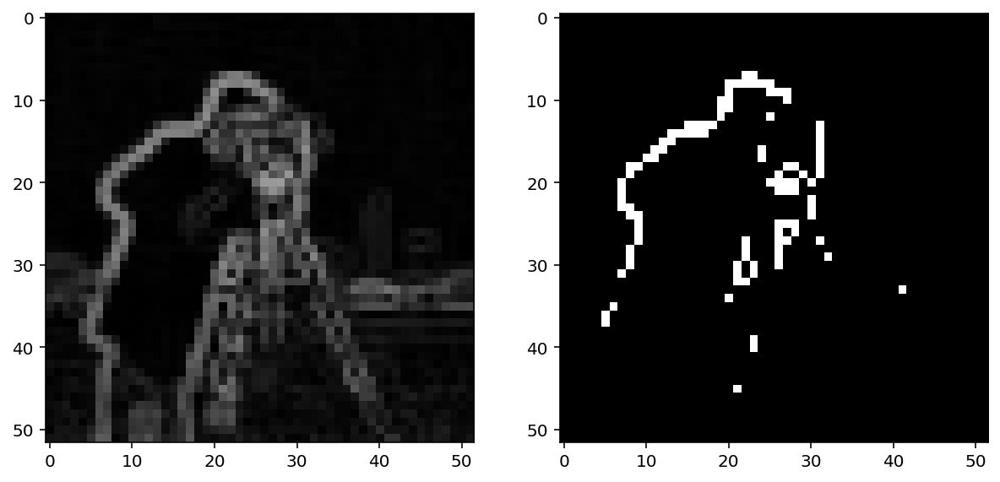

In [86]:
skdemo.imshow_all(gradient, gradient > 0.4)

That approach doesn't do a great job. It's noisy and produces thick edges. Furthermore, it doesn't use our *knowledge* of how edges work: They should be thin and tend to be connected along the direction of the edge.

### Canny edge detector

The Canny edge detector combines the Sobel filter with a few other steps to give a binary edge image. The steps are as follows:
* Gaussian filter
* Sobel filter
* Non-maximal suppression
* Hysteresis thresholding

Let's go through these steps one at a time.

### Step 1: Gaussian filter

As discussed earlier, gradients tend to enhance noise. To combat this effect, we first smooth the image using a gradient filter:

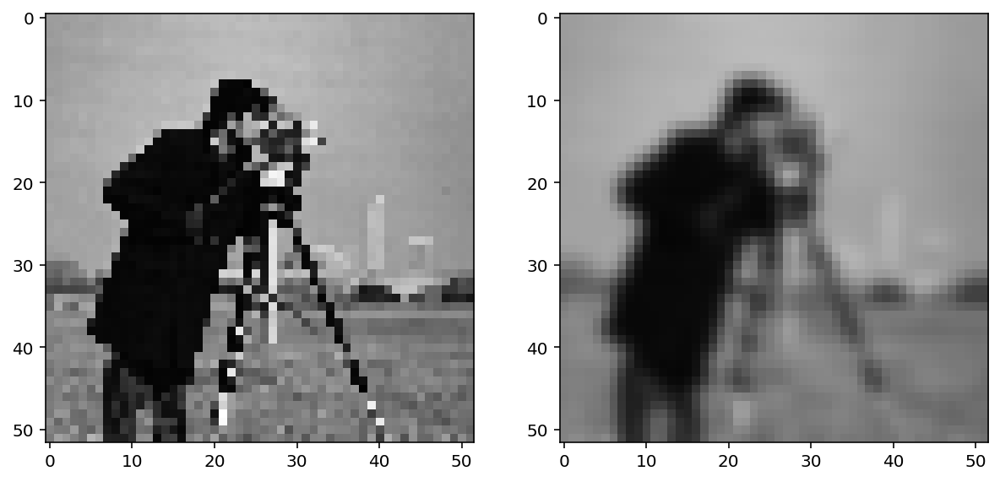

In [87]:
from skimage import img_as_float

sigma = 1  # Standard-deviation of Gaussian; larger smooths more.
pixelated_float = img_as_float(pixelated)
pixelated_float = pixelated
smooth = filters.gaussian(pixelated_float, sigma)
skdemo.imshow_all(pixelated_float, smooth)

### Step 2: Sobel filter

Next, we apply our edge filter:

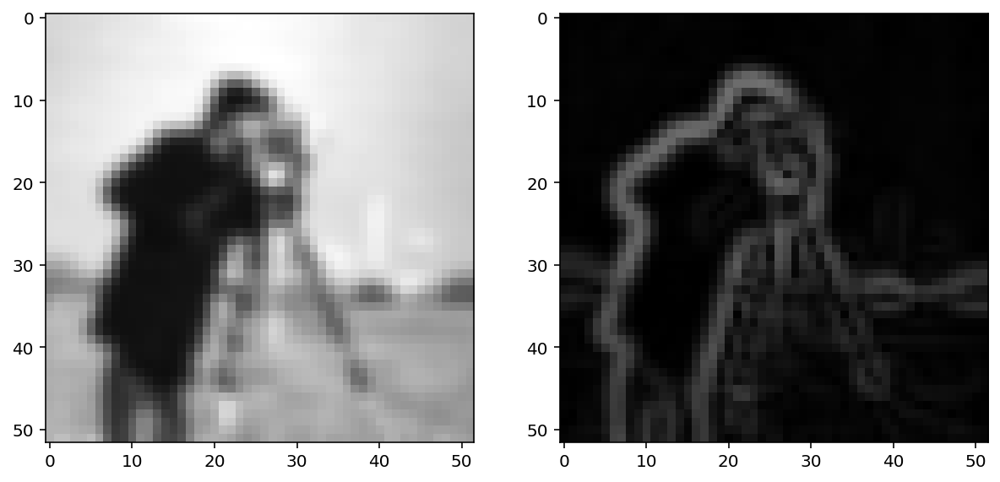

In [88]:
gradient_magnitude = filters.sobel(smooth)
skdemo.imshow_all(smooth, gradient_magnitude)

### Step 3: Non-maximal suppression

Goal: Suppress gradients that aren't on an edge

Ideally, an edge is thin: In some sense, an edge is infinitely thin, but images are discrete so we want edges to be a single pixel wide. To accomplish this, we thin the image using "non-maximal suppression". This takes the edge-filtered image and thins the response *across* the edge direction; i.e. in the direction of the maximum gradient:

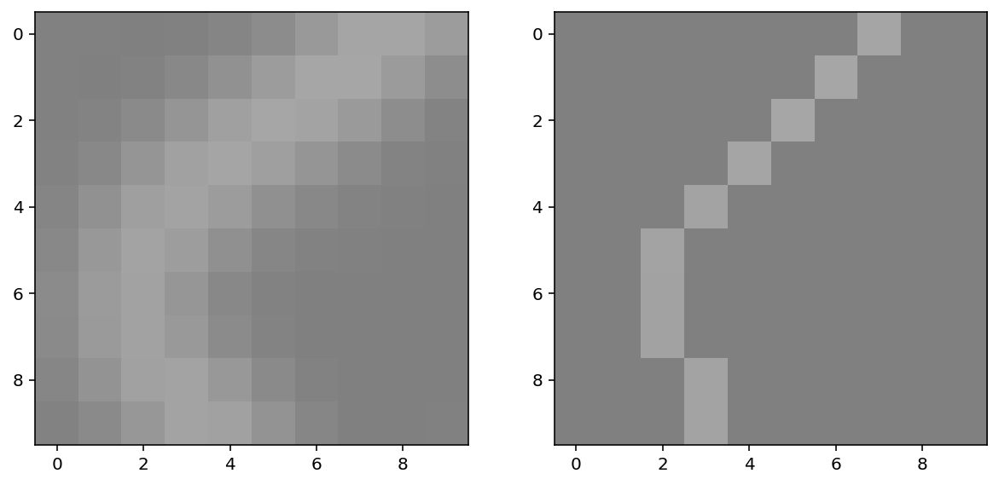

In [89]:
zoomed_grad = gradient_magnitude[15:25, 5:15]
maximal_mask = np.zeros_like(zoomed_grad)
# This mask is made up for demo purposes
maximal_mask[range(10), (7, 6, 5, 4, 3, 2, 2, 2, 3, 3)] = 1
grad_along_edge = maximal_mask * zoomed_grad
skdemo.imshow_all(zoomed_grad, grad_along_edge, limits='dtype')

Obviously, this is a faked version of non-maximal suppression: Pixels are *manually* masked here. The actual algorithm detects the direction of edges, and keeps a pixel only if it has a locally maximal gradient-magnitude in the direction *normal to the edge direction*. It doesn't mask pixels *along* the edge direction since an adjacent edge pixel will be of comparable magnitude.

The result of the filter is that an edge is only possible if there are no better edges near it.

### Step 4: Hysteresis thresholding

Goal: Prefer pixels that are connected to edges

The final step is the actual decision-making process. Here, we have two parameters: The low threshold and the high threshold. The high threshold sets the gradient value that you *know* is definitely an edge. The low threshold sets the gradient value that could be an edge, but only if it's connected to a pixel that we know is an edge.

These two thresholds are displayed below:

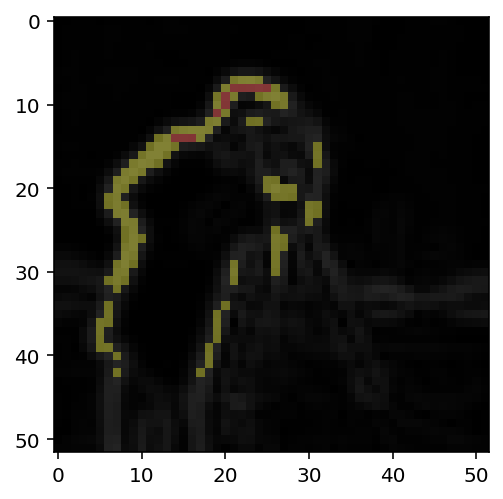

In [90]:
from skimage import color

low_threshold = 0.2
high_threshold = 0.3
label_image = np.zeros_like(pixelated)
# This uses `gradient_magnitude` which has NOT gone through non-maximal-suppression.
label_image[gradient_magnitude > low_threshold] = 1
label_image[gradient_magnitude > high_threshold] = 2
demo_image = color.label2rgb(label_image, gradient_magnitude,
                             bg_label=0, colors=('yellow', 'red'))
plt.imshow(demo_image)

The **red points** here are above `high_threshold` and are seed points for edges. The **yellow points** are edges if connected (possibly by other yellow points) to seed points; i.e. isolated groups of yellow points will not be detected as edges.

Note that the demo above is on the edge image *before* non-maximal suppression, but in reality, this would be done on the image *after* non-maximal suppression. There isn't currently an easy way to get at the intermediate result.

### The Canny edge detector

Now we're ready to look at the actual result:

In [91]:
from IPython.html import widgets
from skimage import data
from skimage import feature

image = data.coins()

def canny_demo(**kwargs):
    edges = feature.canny(image, **kwargs)
    plt.imshow(edges)
    plt.show()
    
# As written, the following doesn't actually interact with the
# `canny_demo` function. Figure out what you need to add.
widgets.interact(canny_demo);  # <-- add keyword arguments for `canny`

#, sigma=4, low_threshold=0, high_threshold=4

/Users/joshagar/anaconda3/lib/python3.7/site-packages/IPython/html.py:14: ShimWarning: The `IPython.html` package has been deprecated since IPython 4.0. You should import from `notebook` instead. `IPython.html.widgets` has moved to `ipywidgets`.
  "`IPython.html.widgets` has moved to `ipywidgets`.", ShimWarning)


interactive(children=(Output(),), _dom_classes=('widget-interact',))

Play around with the demo above. Make sure to add any keyword arguments to `interact` that might be necessary. (Note that keyword arguments passed to `interact` are passed to `canny_demo` and forwarded to `filter.canny`. So you should be looking at the docstring for `filter.canny` or the discussion above to figure out what to add.)

Can you describe how the low threshold makes a decision about a potential edge, as compared to the high threshold?

## Aside: Feature detection in research

When taking image data for an experiment, the end goal is often to detect some sort of feature. Here are a few examples from some of my own research.

### Feature detection: case study

I got started with image processing when I needed to detect the position of a device I built to study swimming in viscous environments (low-Reynolds numbers):

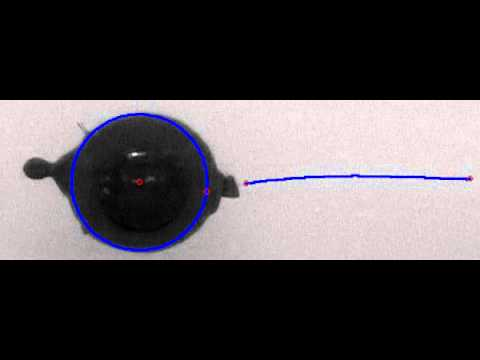

In [92]:
from IPython.display import Image, YouTubeVideo

YouTubeVideo('1Pjlj9Pymx8')

## Hough transforms

Hough transforms are a general class of operations that make up a step in feature detection. Just like we saw with edge detection, Hough transforms produce a result that we can use to detect a feature. (The distinction between the "filter" that we used for edge detection and the "transform" that we use here is a bit arbitrary.)

### Circle detection

To explore the Hough transform, let's take the *circular* Hough transform as our example. Let's grab an image with some circles:

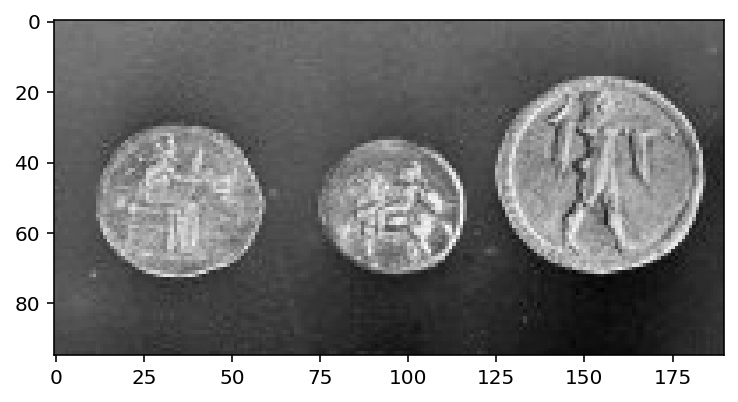

In [93]:
image = data.coins()[0:95, 180:370]
plt.imshow(image);

We can use the Canny edge filter to get a pretty good representation of these circles:

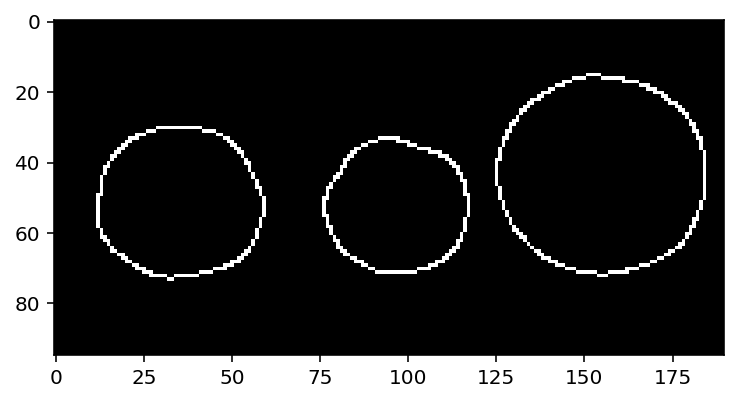

In [94]:
edges = feature.canny(image, sigma=3, low_threshold=10, high_threshold=60)
plt.imshow(edges);

While it looks like we've extracted circles, this doesn't give us much if what we want to do is *measure* these circles. For example, what are the size and position of the circles in the above image? The edge image doesn't really tell us much about that.

We'll use the Hough transform to extract circle positions and radii:

In [95]:
from skimage.transform import hough_circle
 
hough_radii = np.arange(15, 30, 2)
hough_response = hough_circle(edges, hough_radii)

Here, the circular Hough transform actually uses the edge image from before. We also have to define the radii that we want to search for in our image.

So... what's the actual result that we get back?

In [96]:
print(edges.shape,)
print(hough_response.shape)

(95, 190)
(8, 95, 190)


We can see that the last two dimensions of the response are exactly the same as the original image, so the response is image-like. Then what does the first dimension correspond to?

As always, you can get a better feel for the result by plotting it:

In [97]:
# Use max value to intelligently rescale the data for plotting.
h_max = hough_response.max()

def hough_responses_demo(i):
    # Use `plt.title` to add a meaningful title for each index.
    plt.imshow(hough_response[i, :, :], vmax=h_max*0.5)
    plt.show()
widgets.interact(hough_responses_demo, i=(0, len(hough_response)-1));

interactive(children=(IntSlider(value=3, description='i', max=7), Output()), _dom_classes=('widget-interact',)…

Playing around with the slider should give you a pretty good feel for the result.

This Hough transform simply counts the pixels in a thin (as opposed to filled) circular mask. Since the input is an edge image, the response is strongest when the center of the circular mask lies at the center of a circle with the same radius.

---

## <span style="color:cornflowerblue">Exercise:</span>

Use the response from the Hough transform to **detect the position and radius of each coin**.

In [98]:
from skimage.feature import peak_local_max
from skimage.draw import circle_perimeter

centers = []
likelihood = []
# Your code here

The same concept described in this section can be applied to line detection, ellipse detection, and various other features of interest.

---

## Further reading

* [Probabilistic Hough transform](http://scikit-image.org/docs/dev/auto_examples/plot_line_hough_transform.html)
* [Circular and elliptical Hough transforms](http://scikit-image.org/docs/dev/auto_examples/plot_circular_elliptical_hough_transform.html)
* [Template matching](http://scikit-image.org/docs/dev/auto_examples/plot_template.html)
* [Histogram of Oriented Gradients](http://scikit-image.org/docs/dev/auto_examples/plot_hog.html)
* [BRIEF](http://scikit-image.org/docs/dev/auto_examples/plot_brief.html), [CENSURE](http://scikit-image.org/docs/dev/auto_examples/plot_censure.html), and [ORB](http://scikit-image.org/docs/dev/auto_examples/plot_orb.html) feature detectors/descriptors
* [Robust matching using RANSAC](http://scikit-image.org/docs/dev/auto_examples/plot_matching.html)

### Interest point detection

We've only skimmed the surface of what might be classified as "feature detection". One major area that we haven't covered is called [interest point detection](http://en.wikipedia.org/wiki/Interest_point_detection). Here, we don't even need to know what we're looking for, we just identify small patches (centered on a pixel) that are "distinct". (The definition of "distinct" varies by algorithm; e.g., the Harris corner detector defines interest points as corners.) These distinct points can then be used to, e.g., compare with distinct points in other images.

One common use of interest point detection is for image registration, in which we align (i.e. "register") images based on interest points. Here's an example of the [CENSURE feature detector from the gallery](http://scikit-image.org/docs/dev/auto_examples/plot_censure.html):

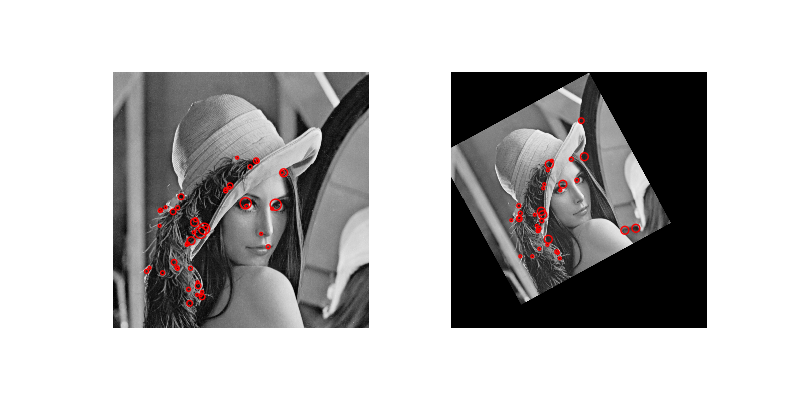

In [99]:
Image(filename='images/censure_example.png')

In [100]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

# Segmentation

--------------

## Separating an image into one or more regions of interest.

Everyone has heard or seen Photoshop or a similar graphics editor take a person from one image and place them into another.  The first step of doing this is *identifying where that person is in the source image*.

In popular culture, the Terminator's vision segments humans:

<img src="./images/terminator_vision.png" width="700px"/>

### Segmentation contains two major sub-fields

* **Supervised** segmentation: Some prior knowledge, possibly from human input, is used to guide the algorithm.  Supervised algorithms currently included in scikit-image include
  *  Thresholding algorithms which require user input (`skimage.filters.threshold_*`)
  * `skimage.segmentation.random_walker`
  * `skimage.segmentation.active_contour`
  * `skimage.segmentation.watershed`
* **Unsupervised** segmentation: No prior knowledge.  These algorithms attempt to subdivide into meaningful regions automatically.  The user may be able to tweak settings like number of regions.
  *  Thresholding algorithms which require no user input.
  *  `skimage.segmentation.slic`
  * `skimage.segmentation.chan_vese`
  * `skimage.segmentation.felzenszwalb`
  * `skimage.segmentation.quickshift`


First, some standard imports and a helper function to display our results

In [101]:
import numpy as np
import matplotlib.pyplot as plt

import skimage.data as data
import skimage.segmentation as seg
from skimage import filters
from skimage import draw
from skimage import color
from skimage import exposure


def image_show(image, nrows=1, ncols=1, cmap='gray', **kwargs):
    fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(16, 16))
    ax.imshow(image, cmap='gray')
    ax.axis('off')
    return fig, ax

## Thresholding

In some images, global or local contrast may be sufficient to separate regions of interest.  Simply choosing all pixels above or below a certain *threshold* may be sufficient to segment such an image.

Let's try this on an image of a textbook.

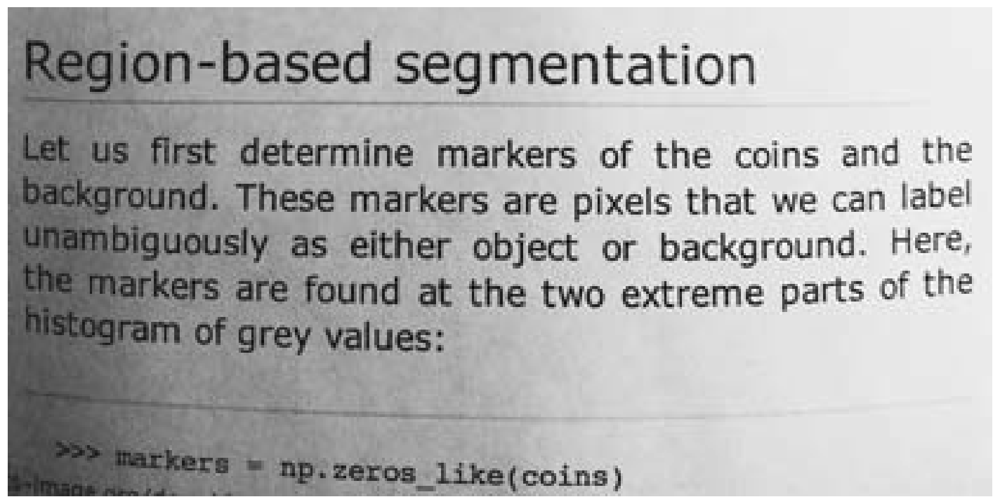

In [102]:
text = data.page()

image_show(text);

### Histograms

A histogram simply plots the frequency (number of times) values within a certain range appear against the data values themselves.  It is a powerful tool to get to know your data - or decide where you would like to threshold.

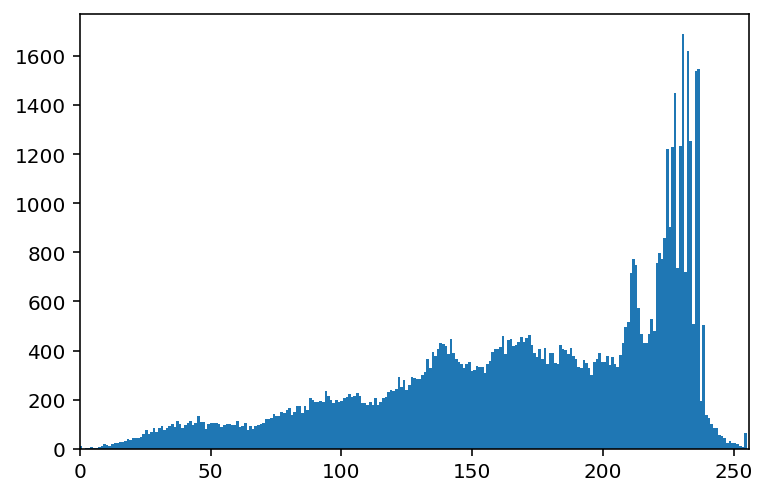

In [103]:
fig, ax = plt.subplots(1, 1)
ax.hist(text.ravel(), bins=256, range=[0, 255])
ax.set_xlim(0, 256);

### Experimentation: supervised thresholding

Try simple NumPy methods and a few different thresholds on this image.  Because *we* are setting the threshold, this is *supervised* segmentation.

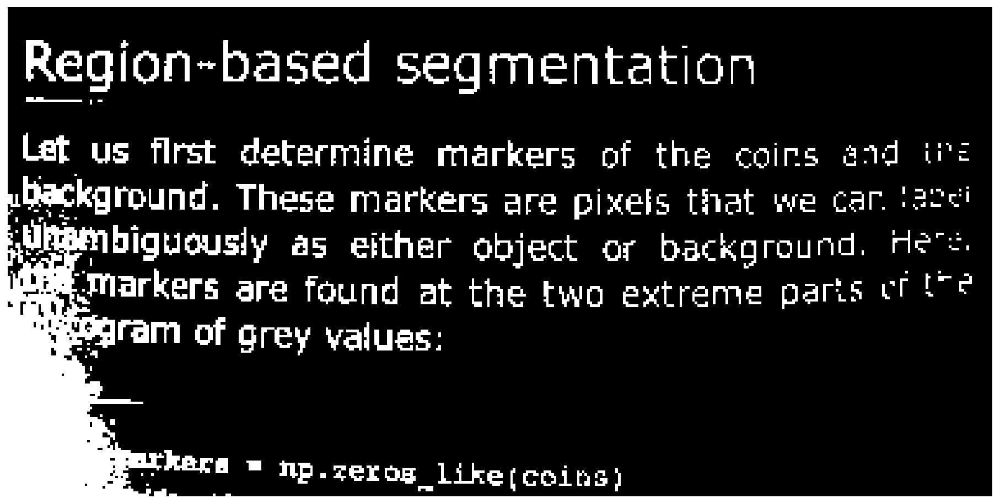

In [104]:
text_segmented = text < 100 # Your code here

image_show(text_segmented);

Not ideal results!  The shadow on the left creates problems; no single global value really fits.

What if we don't want to set the threshold every time?  There are several published methods which look at the histogram and choose what should be an optimal threshold without user input.  These are unsupervised.  

### Experimentation: unsupervised thresholding

Here we will experiment with a number of automatic thresholding methods available in scikit-image.  Because these require no input beyond the image itself, this is *unsupervised* segmentation.

These functions generally return the threshold value(s), rather than applying it to the image directly.

Try `otsu` and `li`, then take a look at `local` or `sauvola`.

In [106]:
text_threshold = filters.threshold_  # Hit tab with the cursor after the underscore, try several methods

image_show(text < text_threshold);

AttributeError: module 'skimage.filters' has no attribute 'threshold_'

## Supervised segmentation

Thresholding can be useful, but is rather basic and a high-contrast image will often limit its utility.  For doing more fun things - like removing part of an image - we need more advanced tools.

For this section, we will use the `astronaut` image and attempt to segment Eileen Collins' head using supervised segmentation.

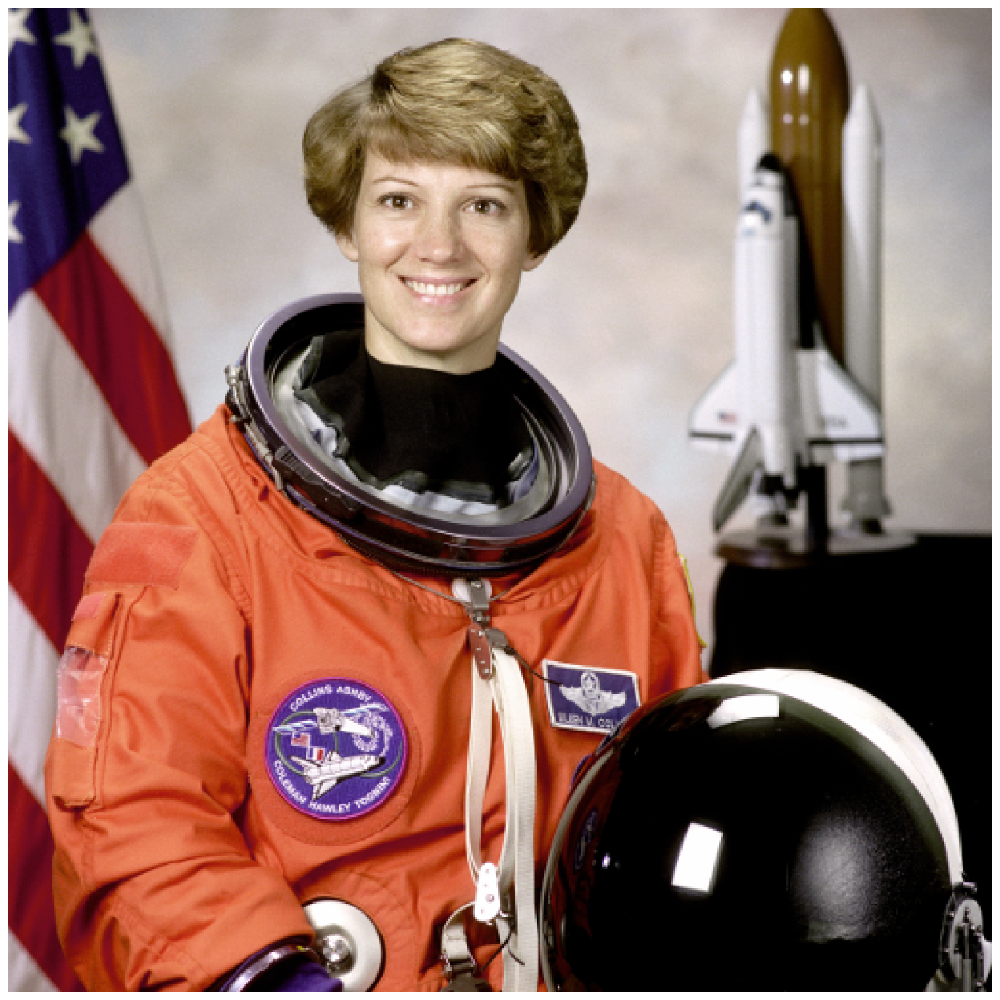

In [107]:
# Our source image
astronaut = data.astronaut()
image_show(astronaut);

The contrast is pretty good in this image for her head against the background, so we will simply convert to grayscale with `rgb2gray`.

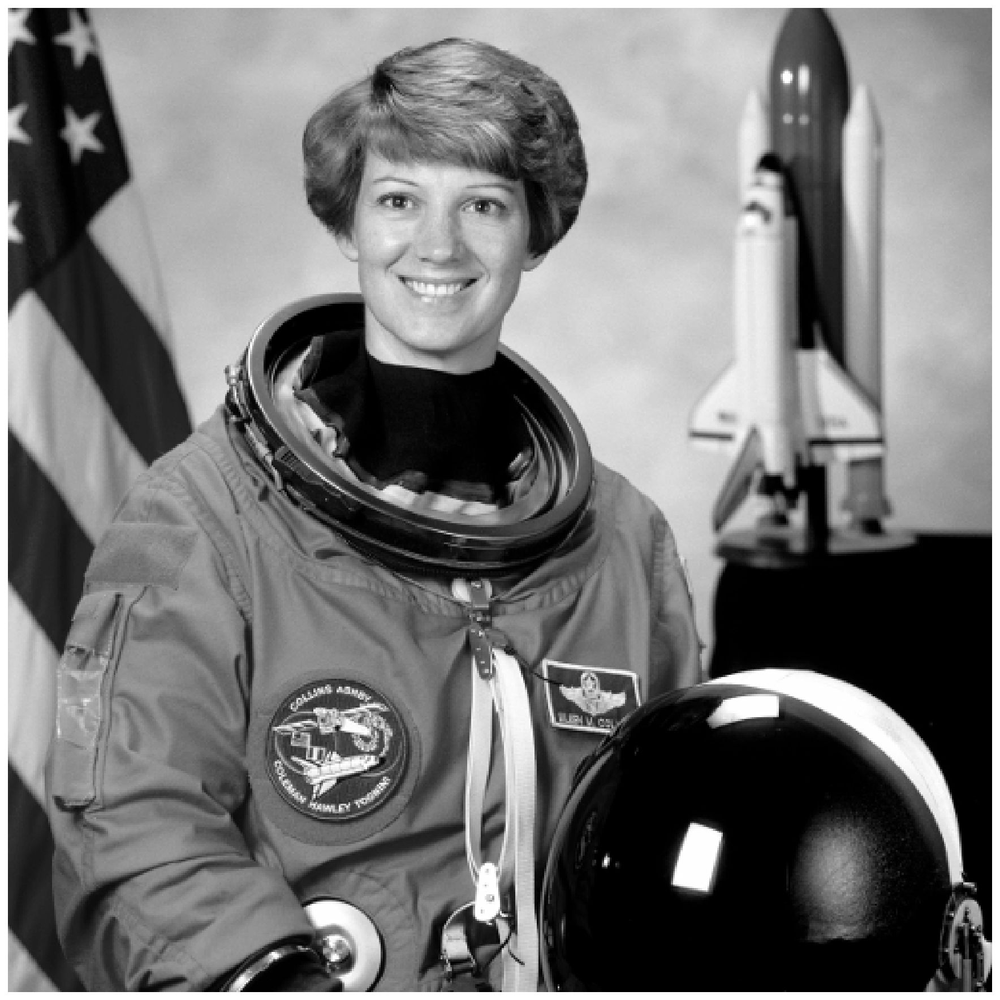

In [108]:
astronaut_gray = color.rgb2gray(astronaut)
image_show(astronaut_gray);

We will use two methods, which segment using very different approaches:

* **Active Contour**: Initializes using a user-defined contour or line, which then is attracted to edges and/or brightness.  Can be tweaked for many situations, but mixed contrast may be problematic.
* **Random walker**: Initialized using any labeled points, fills the image with the label that seems least distant from the origin point (on a path weighted by pixel differences).  Tends to respect edges or step-offs, and is surprisingly robust to noise.  Only one parameter to tweak.

### Active contour segmentation

We must have a set of initial parameters to 'seed' our segmentation this.  Let's draw a circle around the astronaut's head to initialize the snake.

This could be done interactively, with a GUI, but for simplicity we will start at the point [100, 220] and use a radius of 100 pixels.  Just a little trigonometry in this helper function...

In [109]:
def circle_points(resolution, center, radius):
    """
    Generate points defining a circle on an image.
    """
    radians = np.linspace(0, 2*np.pi, resolution)

    c = center[1] + radius*np.cos(radians)
    r = center[0] + radius*np.sin(radians)
    
    return np.array([c, r]).T

# Exclude last point because a closed path should not have duplicate points
points = circle_points(200, [100, 220], 100)[:-1]

In [110]:
snake = seg.active_contour(astronaut_gray, points, alpha=0.1, w_edge=1.3)

/Users/joshagar/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: The coordinates used by `active_contour` will change from xy coordinates (transposed from image dimensions) to rc coordinates in scikit-image 0.18. Set `coordinates='rc'` to silence this warning. `coordinates='xy'` will restore the old behavior until 0.18, but will stop working thereafter.
  """Entry point for launching an IPython kernel.


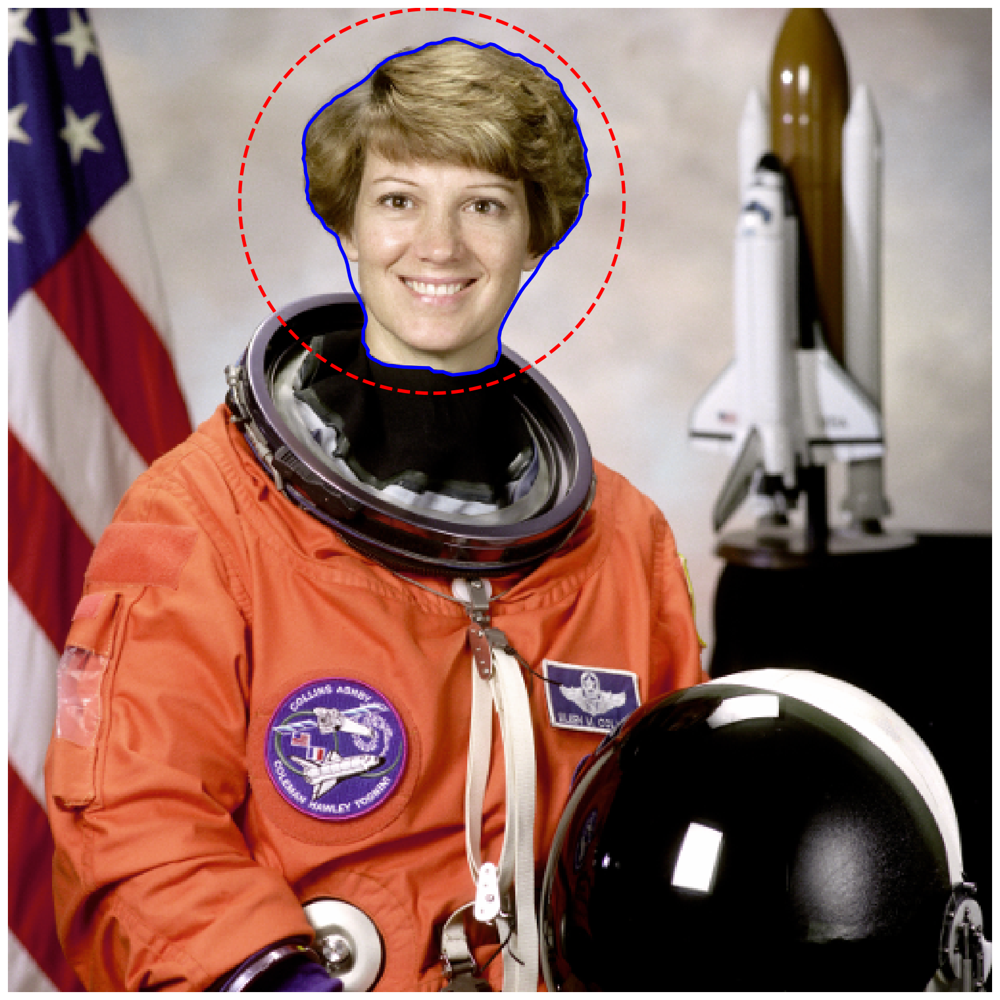

In [111]:
fig, ax = image_show(astronaut)
ax.plot(points[:, 0], points[:, 1], '--r', lw=3)
ax.plot(snake[:, 0], snake[:, 1], '-b', lw=3);

### Random walker

One good analogy for random walker uses graph theory.  

* The distance from each pixel to its neighbors is weighted by how similar their values are; the more similar, the lower the cost is to step from one to another
* The user provides some seed points
* The algorithm finds the cheapest paths from each point to each seed value.  
* Pixels are labeled with the cheapest/lowest path.

We will re-use the seed values from our previous example.

In [112]:
astronaut_labels = np.zeros(astronaut_gray.shape, dtype=np.uint8)

The random walker algorithm expects a label image as input.  Any label above zero will be treated as a seed; all zero-valued locations will be filled with labels from the positive integers available.

There is also a masking feature where anything labeled -1 will never be labeled or traversed, but we will not use it here.

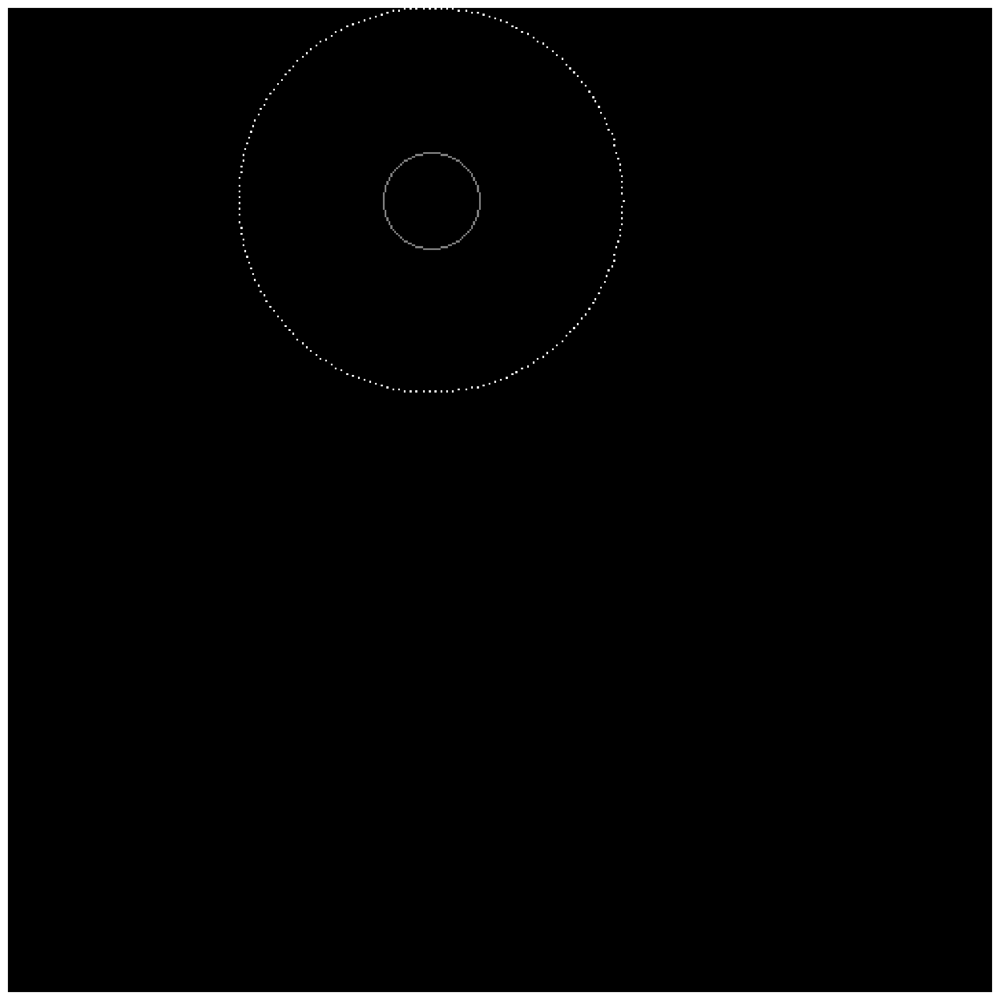

In [113]:
indices = draw.circle_perimeter(100, 220, 25)

astronaut_labels[indices] = 1
astronaut_labels[points[:, 1].astype(np.int), points[:, 0].astype(np.int)] = 2

image_show(astronaut_labels);

In [114]:
astronaut_segmented = seg.random_walker(astronaut_gray, astronaut_labels, beta =2500)

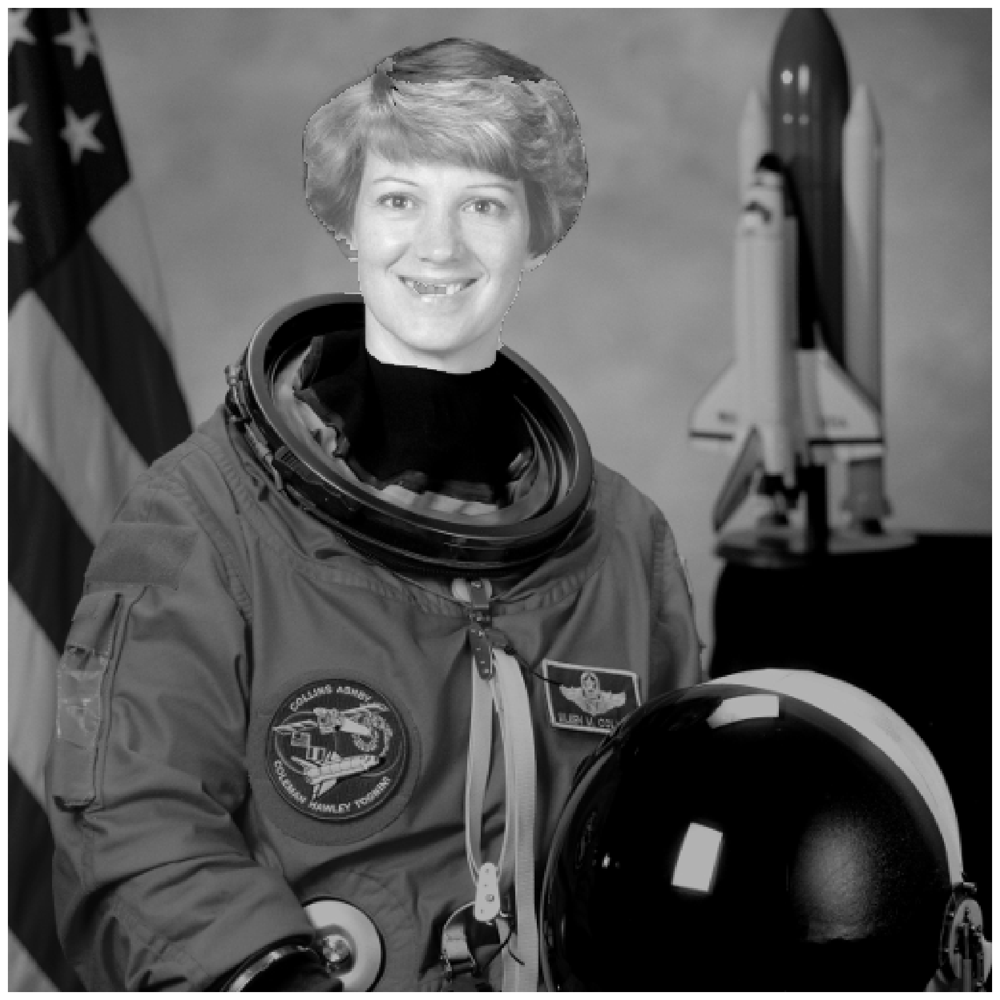

In [115]:
# Check our results
fig, ax = image_show(astronaut_gray)
ax.imshow(astronaut_segmented == 1, alpha=0.3);

## Flood fill

A basic but effective segmentation technique was recently added to scikit-image: `segmentation.flood` and `segmentation.flood_fill`.  These algorithms take a seed point and iteratively find and fill adjacent points which are equal to or within a tolerance of the initial point.  `flood` returns the region; `flood_fill` returns a modified image with those points changed to a new value.

This approach is most suited for areas which have a relatively uniform color or gray value, and/or high contrast relative to adjacent structures.

Can we accomplish the same task with flood fill?

In [116]:
seed_point = (100, 220)  # Experiment with the seed point
flood_mask = seg.flood(astronaut_gray, seed_point, tolerance=0.1)  # Experiment with tolerance

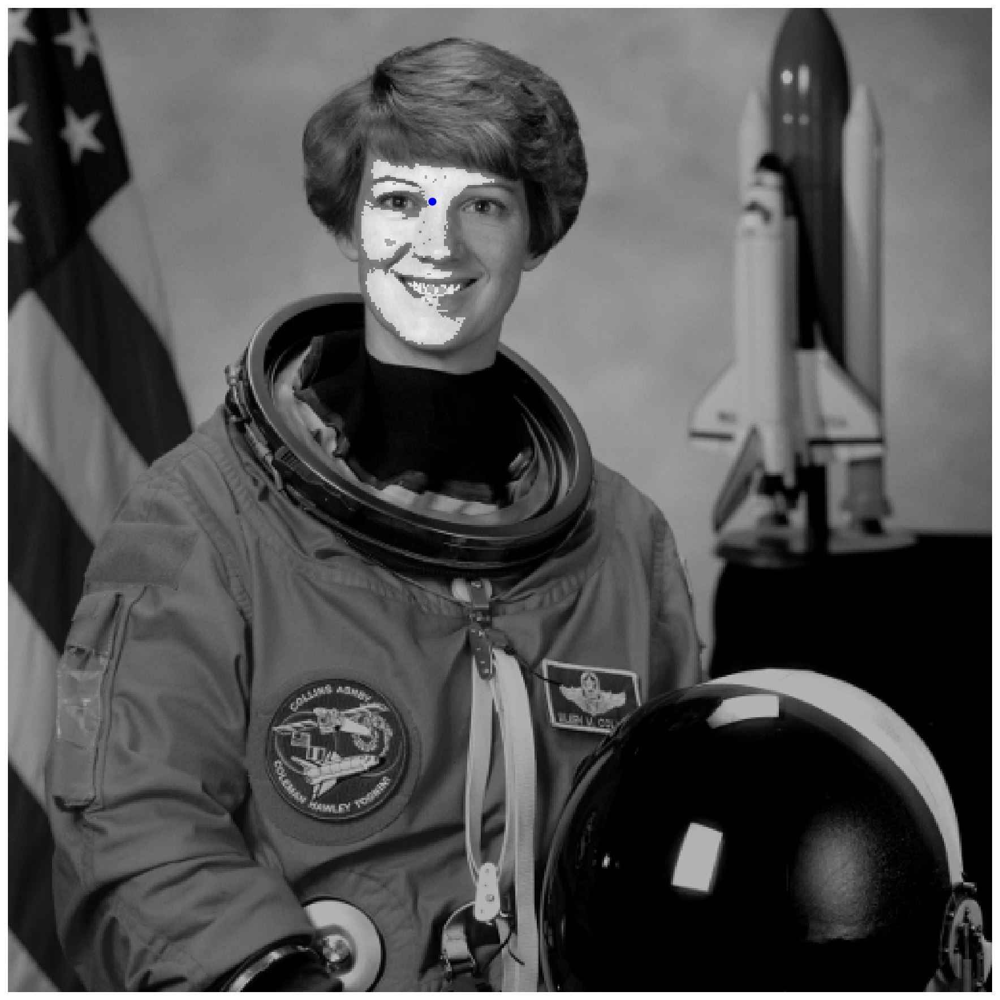

In [117]:
fig, ax = image_show(astronaut_gray)
ax.imshow(flood_mask, alpha=0.3);
ax.plot(220, 100, 'bo')

Not ideal! The flood runs away into the background through the right earlobe.

Let's think outside the box.  
* What if instead of segmenting the head, we segmented the background around it and the collar?
* Is there any way to increase the contrast between the background and skin?

In [118]:
seed_bkgnd = (100, 350)  # Background
seed_collar = (200, 220)  # Collar

better_contrast = astronaut_gray*10  # Your idea to improve contrast here
tol_bkgnd = 3   # Experiment with tolerance for background
tol_collar = 3  # Experiment with tolerance for the collar

flood_background = seg.flood(better_contrast, seed_bkgnd, tolerance=tol_bkgnd)
flood_collar = seg.flood(better_contrast, seed_collar, tolerance=tol_collar)

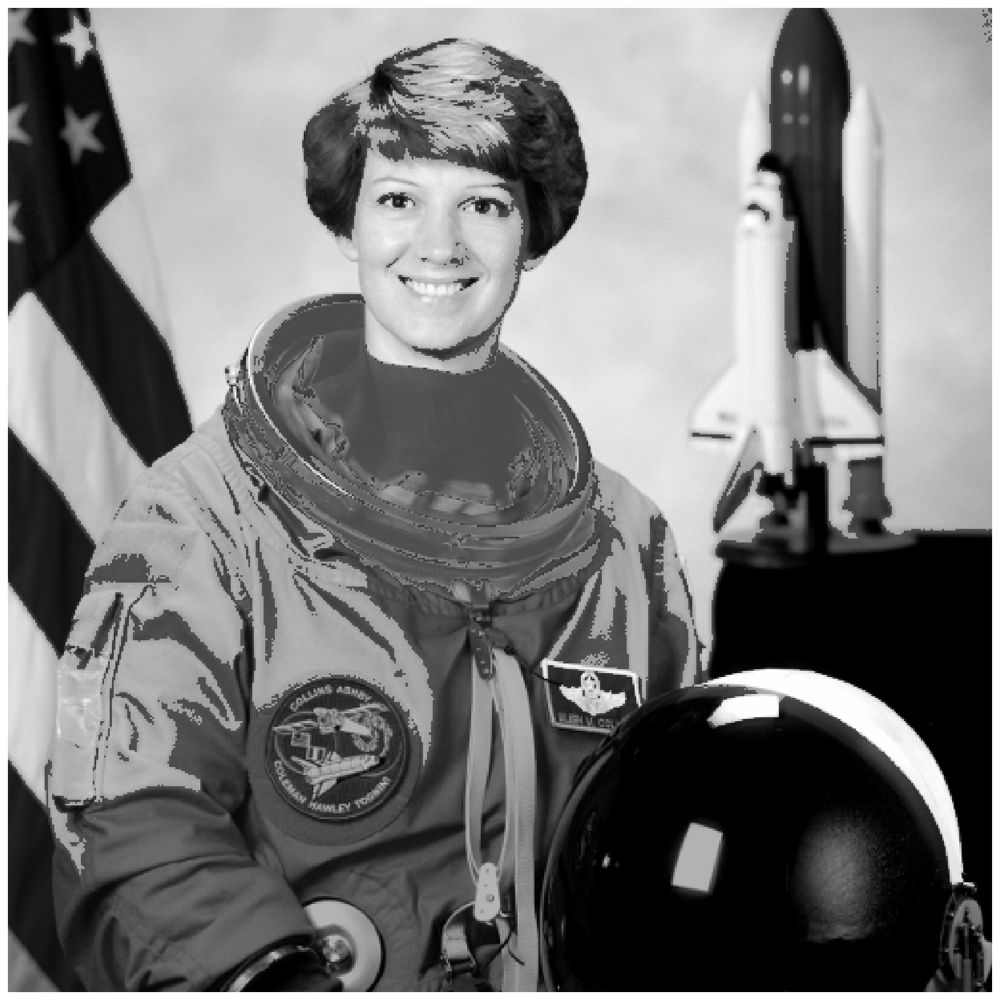

In [119]:
fig, ax = image_show(better_contrast)

# Combine the two floods with binary OR operator
ax.imshow(flood_background | flood_collar, alpha=0.3);

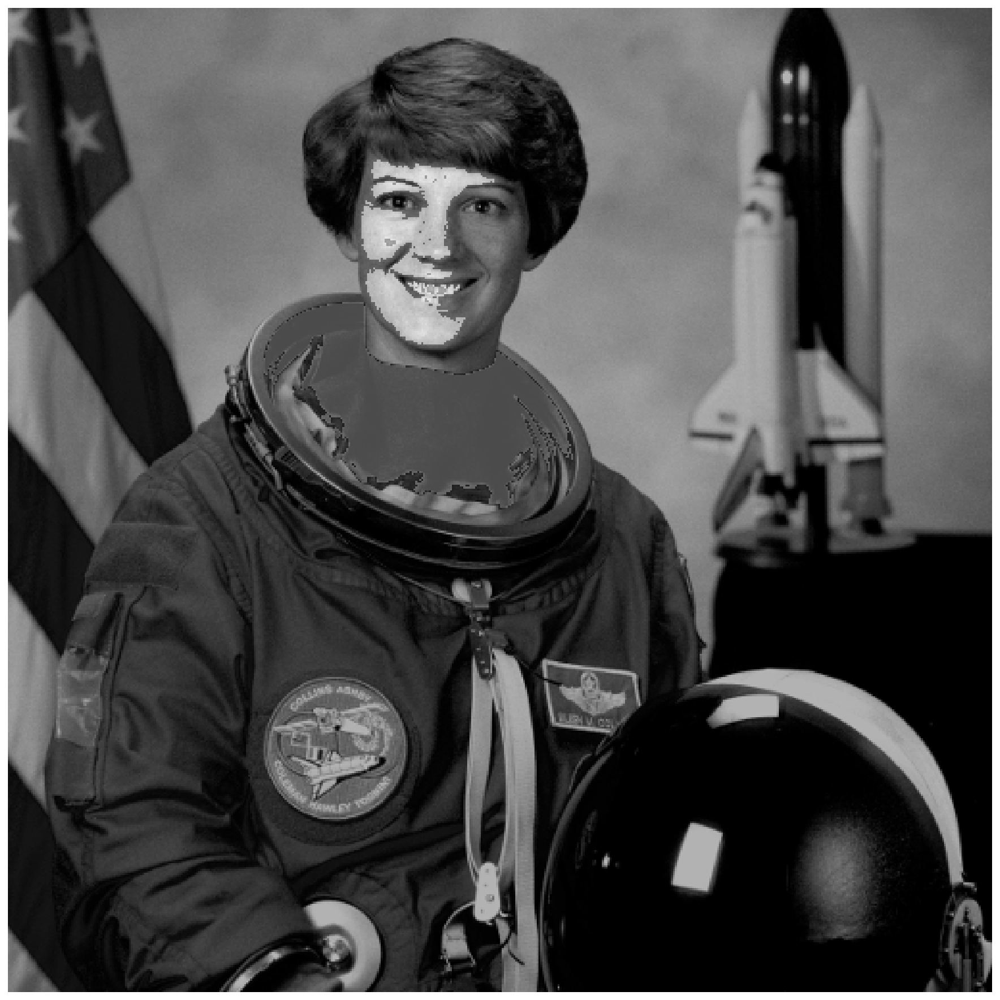

In [120]:
flood_mask2 = seg.flood(astronaut[..., 2], (200, 220), tolerance=40)
fig, ax = image_show(astronaut[..., 2])
ax.imshow(flood_mask | flood_mask2, alpha=0.3);

## Unsupervised segmentation

Sometimes, human input is not possible or feasible - or, perhaps your images are so large that it is not feasible to consider all pixels simultaneously.  Unsupervised segmentation can then break the image down into several sub-regions, so instead of millions of pixels you have tens to hundreds of regions.

### SLIC

There are many analogies to machine learning in unsupervised segmentation.  Our first example directly uses a common machine learning algorithm under the hood - K-Means.

In [121]:
# SLIC works in color, so we will use the original astronaut
astronaut_slic = seg.slic(astronaut)

/Users/joshagar/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.
  


/Users/joshagar/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  


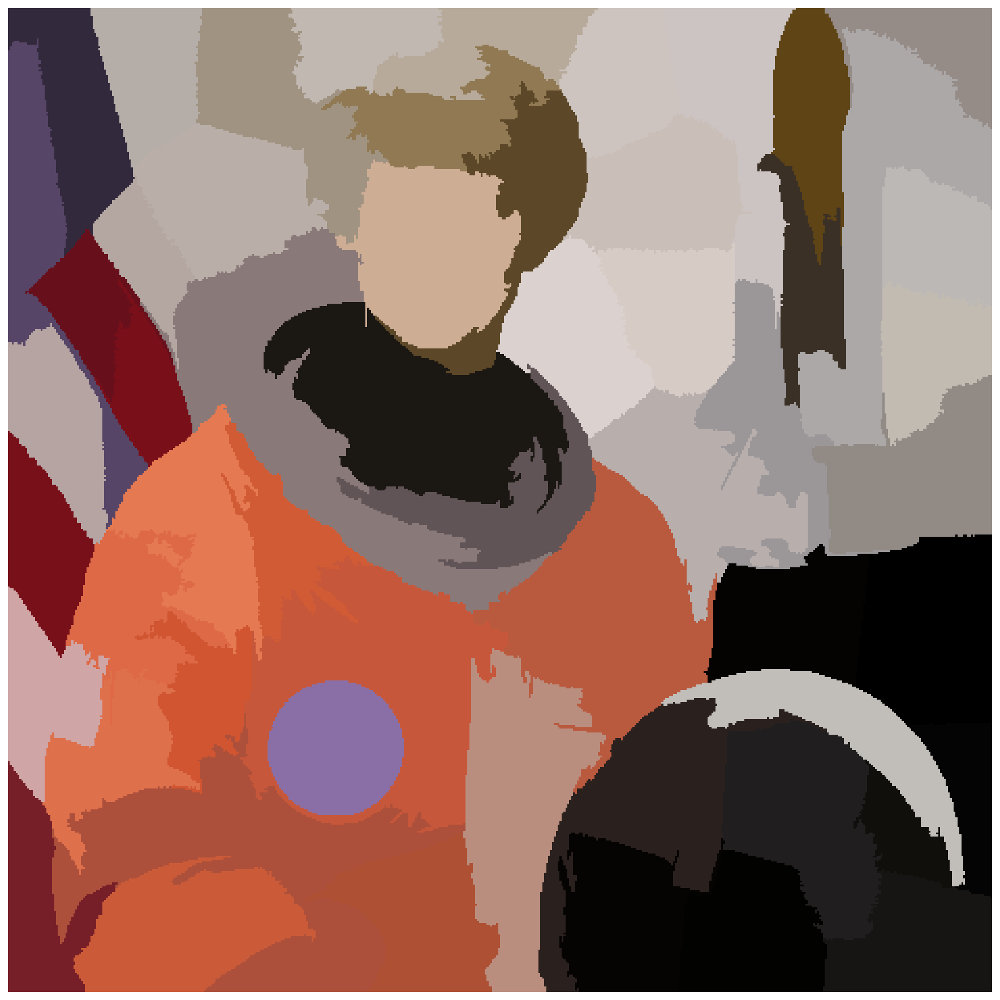

In [122]:
# label2rgb replaces each discrete label with the average interior color
image_show(color.label2rgb(astronaut_slic, astronaut, kind='avg'));

We've reduced this image from 512*512 = 262,000 pixels down to 100 regions!

And most of these regions make some logical sense.

### Chan-Vese

This algorithm iterates a level set, which allows it to capture complex and even disconnected features.  However, its result is binary - there will only be one region - and it requires a grayscale image.

This algorithm takes a few seconds to run.

In [123]:
chan_vese = seg.chan_vese(astronaut_gray)

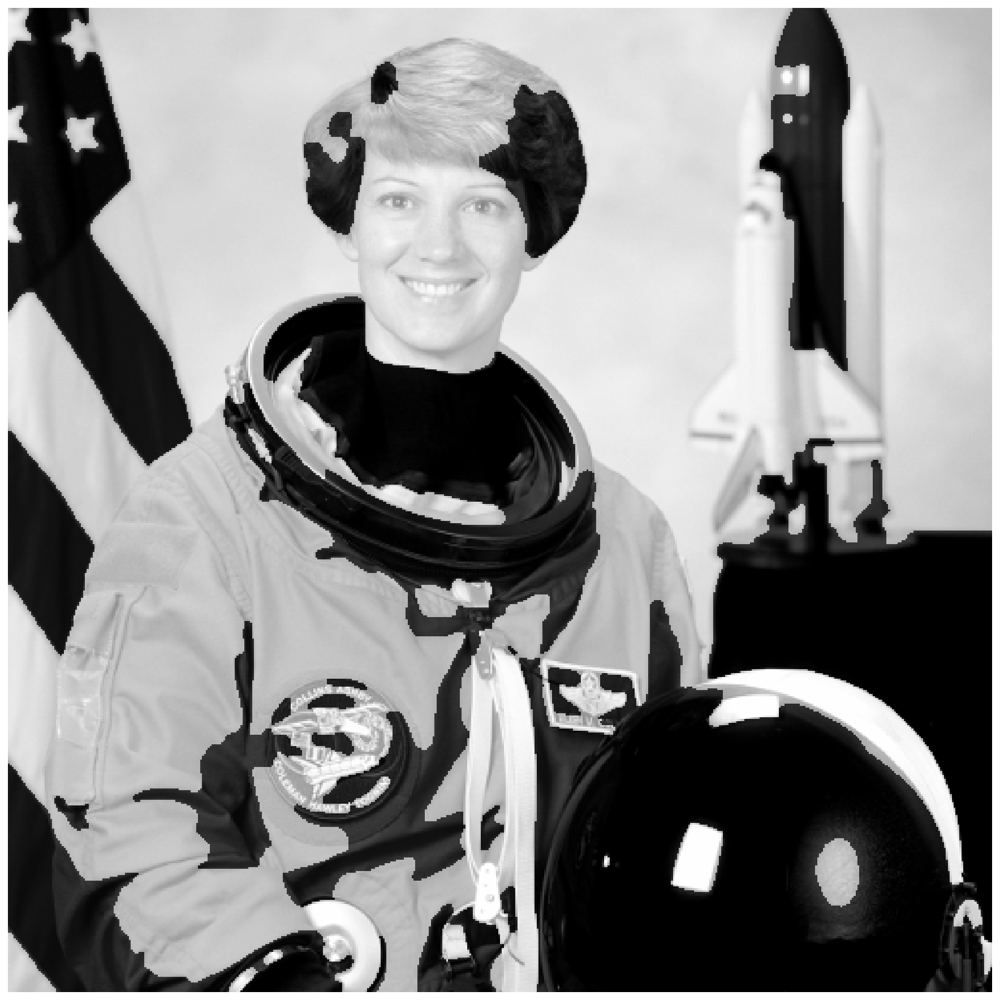

In [133]:
fig, ax = image_show(astronaut_gray)
ax.imshow(chan_vese == 0, alpha=.5);

Chan-Vese has a number of paremeters, which you can try out!  In the interest of time, we may move on.

### Felzenszwalb

This method oversegments an RGB image (requires color, unlike Chan-Vese) using another machine learning technique, a minimum-spanning tree clustering.  The number of segments is not guaranteed and can only be indirectly controlled via `scale` parameter.

In [129]:
astronaut_felzenszwalb = seg.felzenszwalb(astronaut)  # Color required

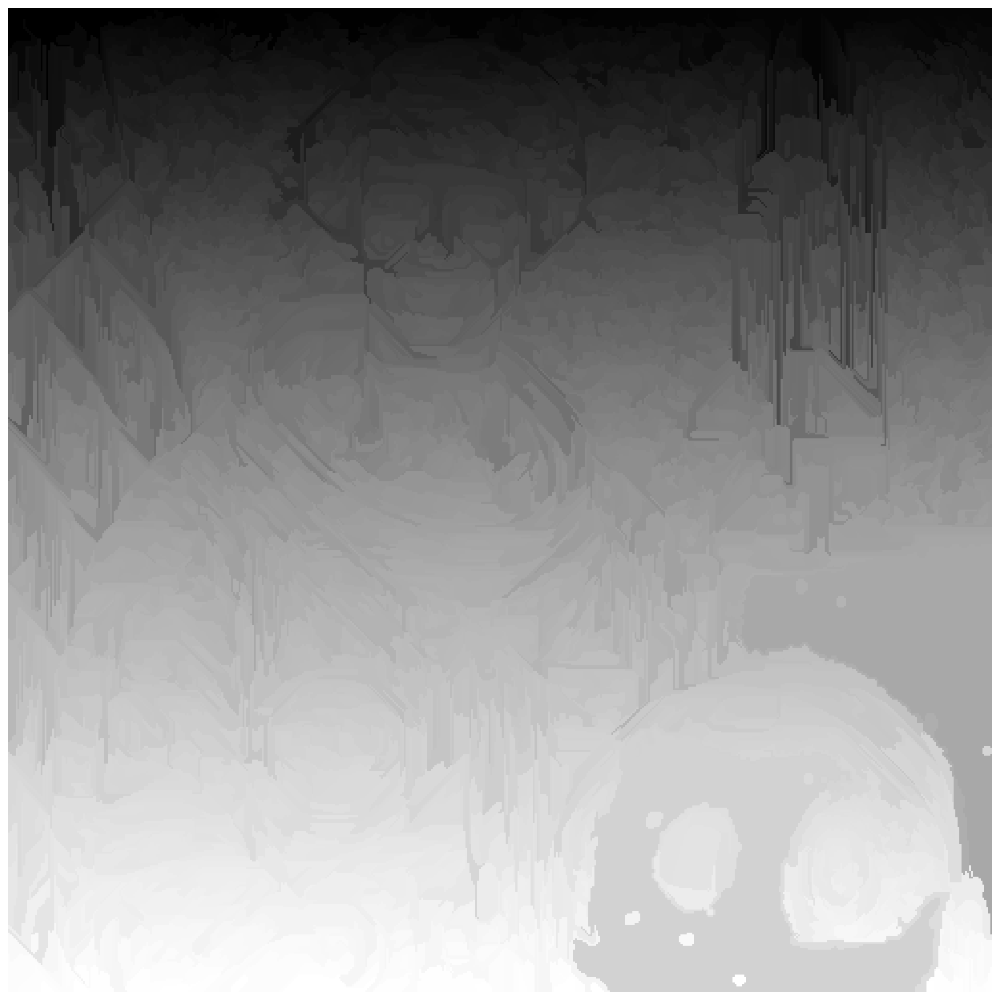

In [130]:
image_show(astronaut_felzenszwalb);

Whoa, lots of regions!  How many is that?

In [134]:
# Find the number of unique labels
np.unique(astronaut_felzenszwalb).size

3295

Let's see if they make sense; label them with the region average (see above with SLIC)

/Users/joshagar/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  """Entry point for launching an IPython kernel.


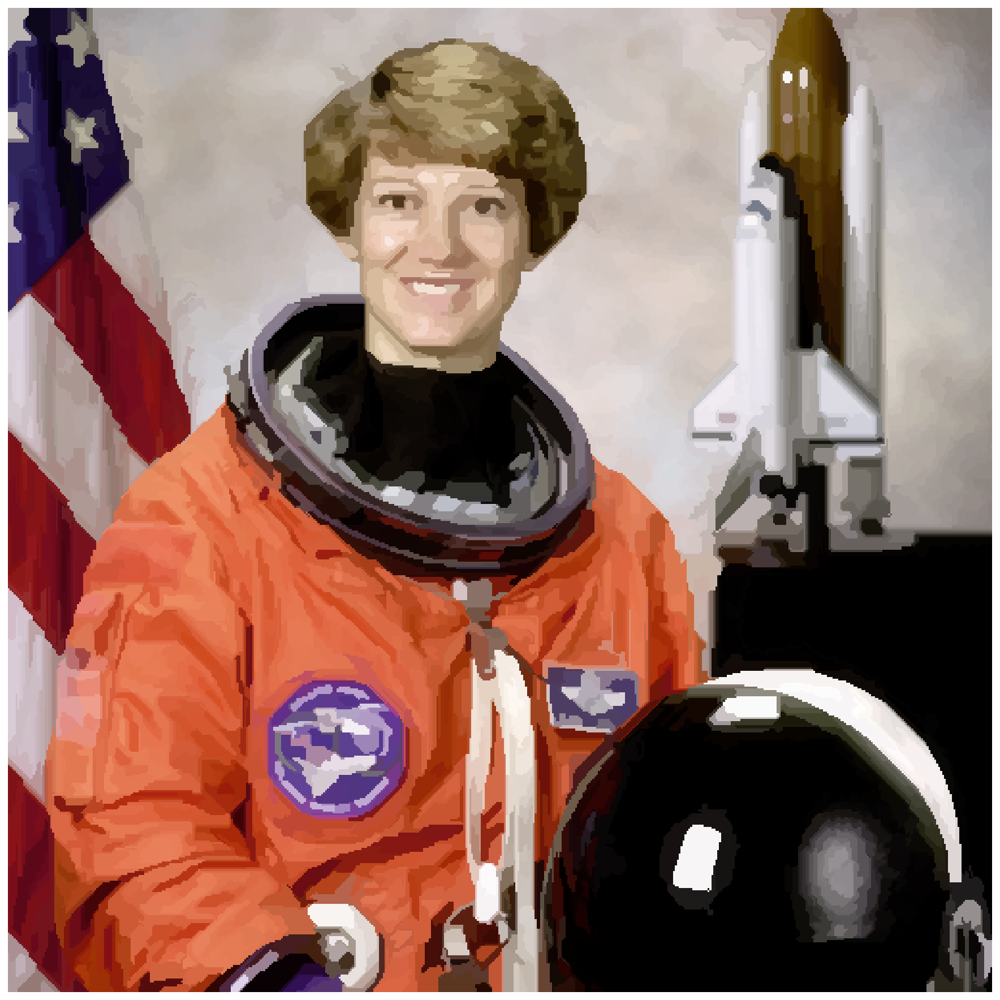

In [135]:
astronaut_felzenszwalb_colored = color.label2rgb(astronaut_felzenszwalb, astronaut, kind='avg')  # Your code here

image_show(astronaut_felzenszwalb_colored);

Actually reasonable small regions.  If we wanted fewer regions, we could change the `scale` parameter (try it!) or start here and combine them.

This approach is sometimes called **oversegmentation**.

But when there are too many regions, they must be combined somehow.

## Combining regions with a Region Adjacency Graph (RAG)

Remember how the concept behind random walker was functionally looking at the difference between each pixel and its neighbors, then figuring out which were most alike?  A RAG is essentially the same, except between regions.

We have RAGs now in scikit-image, but we have to import *from the future*; this functionality is exposed in the `future.graph` submodule meaning it is stable and robust enough to ship, but the API may change.

In [136]:
import skimage.future.graph as graph

rag = graph.rag_mean_color(astronaut, astronaut_felzenszwalb + 1)

Now we show just one application of a very useful tool - `skimage.measure.regionprops` - to determine the centroid of each labeled region and pass that to the graph.  

`regionprops` has many, many other uses; see the API documentation for all of the features that can be quantified per-region!  
http://scikit-image.org/docs/dev/api/skimage.measure.html#skimage.measure.regionprops

In [137]:
import skimage.measure as measure

# Regionprops ignores zero, but we want to include it, so add one
regions = measure.regionprops(astronaut_felzenszwalb + 1)  

# Pass centroid data into the graph
for region in regions:
    rag.nodes[region['label']]['centroid'] = region['centroid']

`display_edges` is a helper function to assist in visualizing the graph.

In [138]:
def display_edges(image, g, threshold):
    """Draw edges of a RAG on its image
 
    Returns a modified image with the edges drawn.Edges are drawn in green
    and nodes are drawn in yellow.
 
    Parameters
    ----------
    image : ndarray
        The image to be drawn on.
    g : RAG
        The Region Adjacency Graph.
    threshold : float
        Only edges in `g` below `threshold` are drawn.
 
    Returns:
    out: ndarray
        Image with the edges drawn.
    """
    image = image.copy()
    for edge in g.edges():
        n1, n2 = edge
 
        r1, c1 = map(int, rag.nodes[n1]['centroid'])
        r2, c2 = map(int, rag.nodes[n2]['centroid'])
 
        line  = draw.line(r1, c1, r2, c2)
        circle = draw.circle(r1,c1,2)
 
        if g[n1][n2]['weight'] < threshold :
            image[line] = 0,255,0
        image[circle] = 255,255,0
 
    return image

/Users/joshagar/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:28: FutureWarning: circle is deprecated in favor of disk.circle will be removed in version 0.19


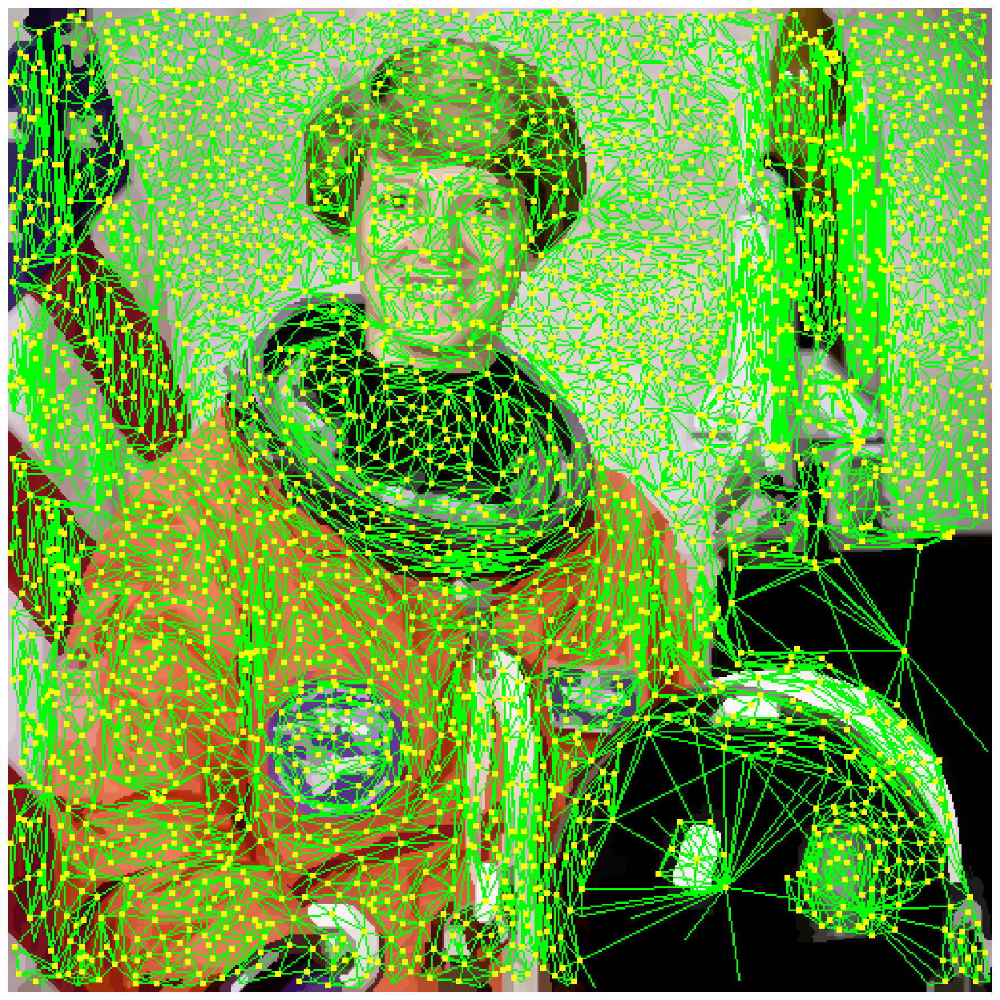

In [139]:
# All edges are drawn with threshold at infinity
edges_drawn_all = display_edges(astronaut_felzenszwalb_colored, rag, np.inf)
image_show(edges_drawn_all);

Try a range of thresholds out, see what happens.

/Users/joshagar/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:28: FutureWarning: circle is deprecated in favor of disk.circle will be removed in version 0.19


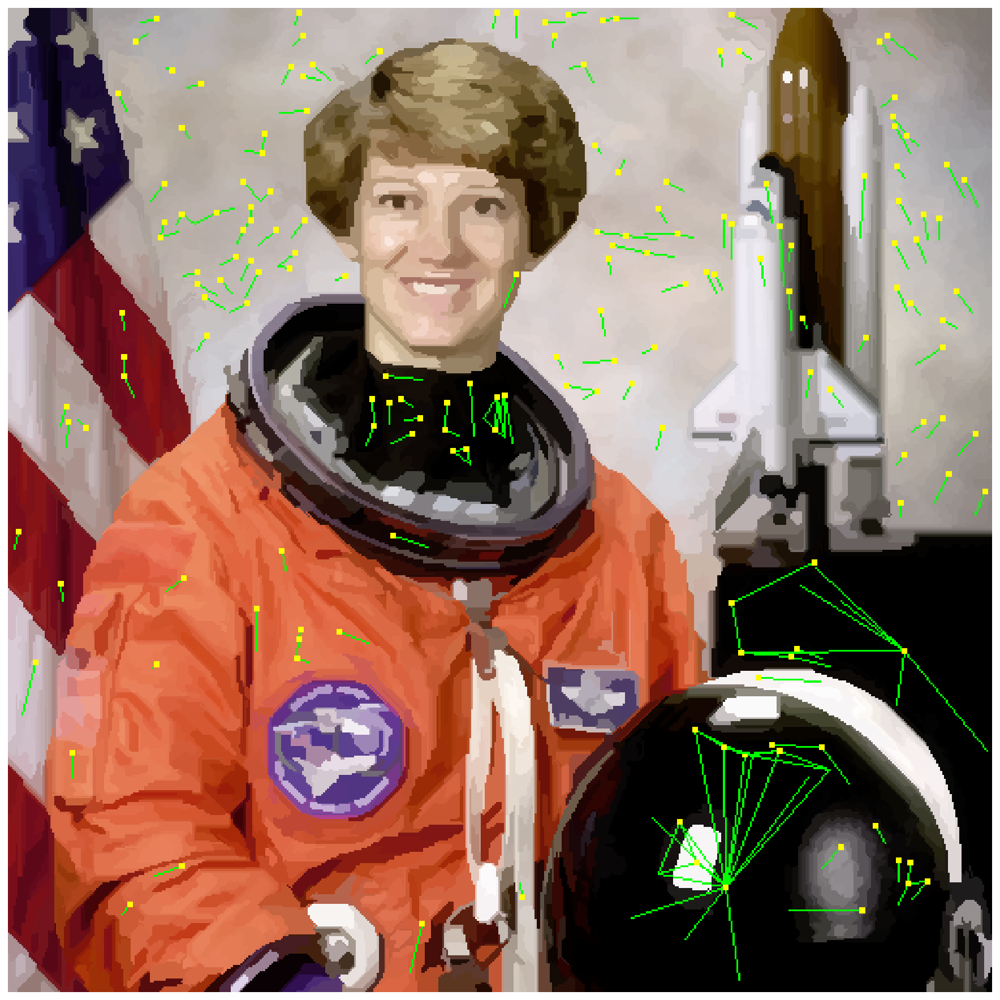

In [161]:
threshold = 5000  # Experiment

edges_drawn_few = display_edges(astronaut_felzenszwalb_colored, rag, threshold)
image_show(edges_drawn_few);

#### Finally, cut the graph

Once you are happy with the (dis)connected regions above, the graph can be cut to merge the regions which are still connected.

/Users/joshagar/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: FutureWarning: The new recommended value for bg_label is 0. Until version 0.19, the default bg_label value is -1. From version 0.19, the bg_label default value will be 0. To avoid this warning, please explicitly set bg_label value.
  This is separate from the ipykernel package so we can avoid doing imports until


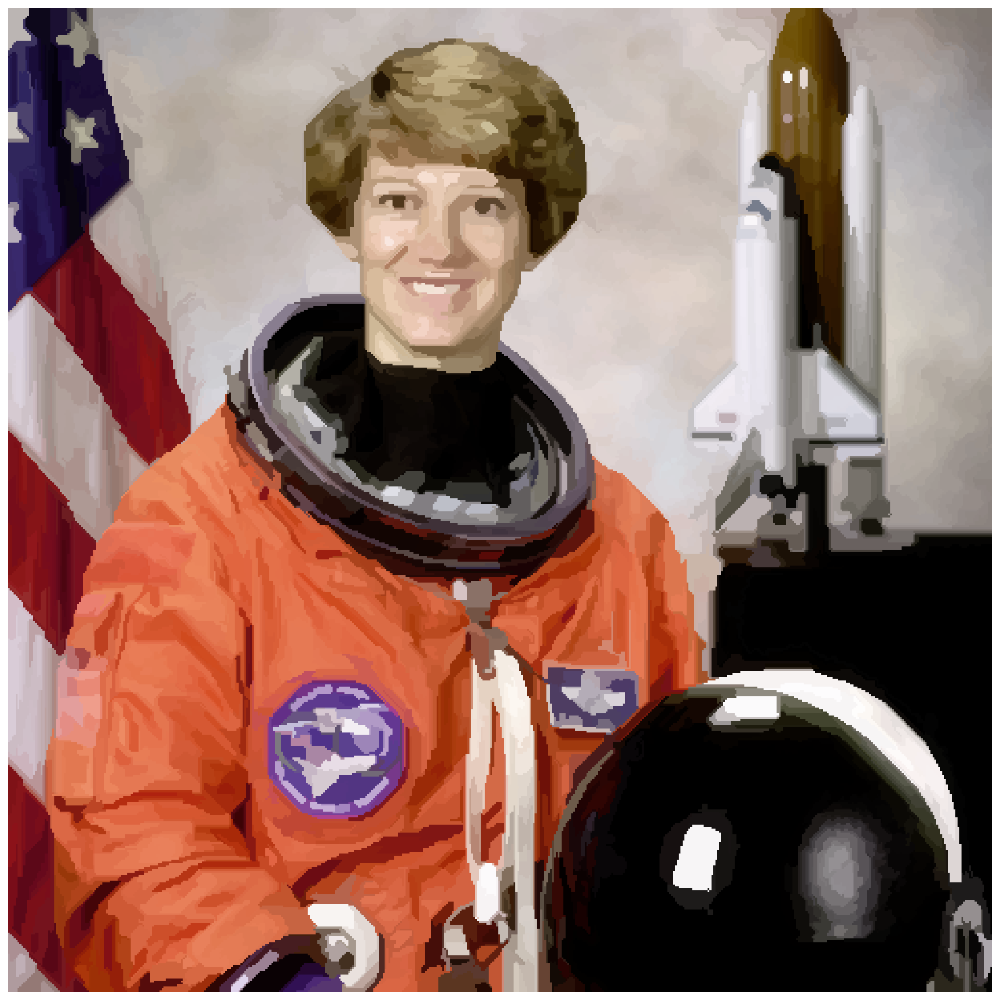

In [162]:
final_labels=[]
final_labels = graph.cut_threshold(astronaut_felzenszwalb + 1, rag, threshold)
final_label_rgb = color.label2rgb(final_labels, astronaut, kind='avg')

image_show(final_label_rgb);

How many regions exist now?

In [163]:
np.unique(final_labels).size

3105

In [166]:
%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt

# scikit-image: a tour

There are many tools and utilities in the package, far too many to cover in a tutorial.  This notebook is designed as a road map, to guide you as you explore or search for additional tools for your applications.  *This is intended as a guide, not an exhaustive list*.

Each submodule of scikit-image has its own section, which you can navigate to below in the table of contents.

## Table of Contents

* [skimage.color](#color)
* [skimage.data](#data)
* [skimage.draw](#draw)
* [skimage.exposure](#exposure)
* [skimage.feature](#feature)
* [skimage.filters](#filters)
* [skiamge.future](#future)
* [skimage.graph](#graph)
* [skimage.io](#io)
* [skimage.measure](#measure)
* [skimage.morphology](#morphology)
* [skimage.restoration](#restoration)
* [skimage.segmentation](#segmentation)
* [skimage.transform](#transform)
* [skimage.util](#util)

## [skimage.color](https://scikit-image.org/docs/stable/api/skimage.color.html) - color conversion<a id='color'></a>

The `color` submmodule includes routines to convert to and from common color representations.  For example, RGB (Red, Green, and Blue) can be converted into many other representations.

In [167]:
import skimage.color as color

In [168]:
# Tab complete to see available functions in the color submodule
color.rgb2
color.

SyntaxError: invalid syntax (<ipython-input-168-03cf11c2310c>, line 3)

### Example: conversion to grayscale

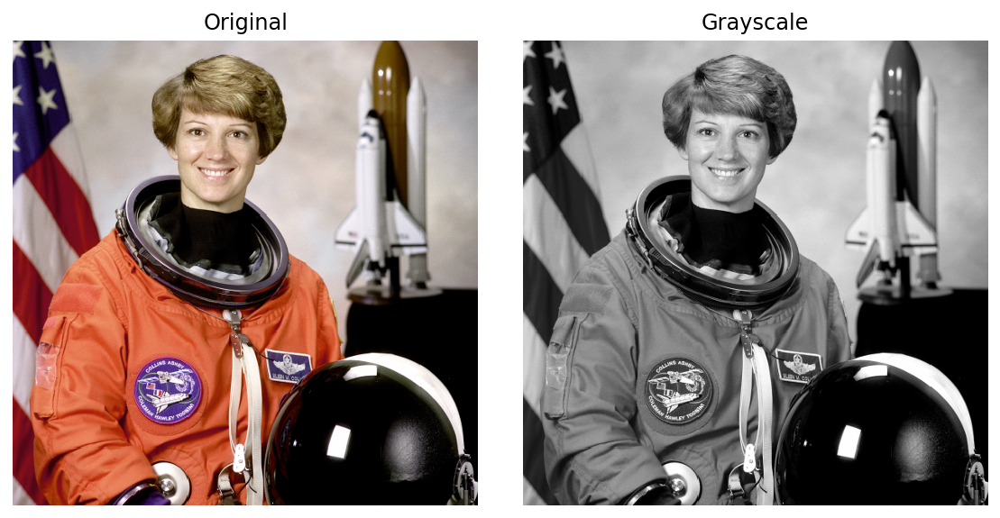

In [169]:
from skimage import data
from skimage import color

original = data.astronaut()
grayscale = color.rgb2gray(original)

# Plot the results
fig, axes = plt.subplots(1, 2, figsize=(8, 4))
ax = axes.ravel()

ax[0].imshow(original)
ax[0].set_title("Original")
ax[0].axis('off')
ax[1].imshow(grayscale, cmap='gray')
ax[1].set_title("Grayscale")
ax[1].axis('off')

fig.tight_layout()
plt.show();

### Example: conversion to HSV

Usually, objects in images have distinct colors (hues) and luminosities, so that these features can be used to separate different areas of the image. In the RGB representation the hue and the luminosity are expressed as a linear combination of the R,G,B channels, whereas they correspond to single channels of the HSV image (the Hue and the Value channels). A simple segmentation of the image can then be effectively performed by a mere thresholding of the HSV channels.  See below link for additional details.

https://en.wikipedia.org/wiki/HSL_and_HSV

We first load the RGB image and extract the Hue and Value channels:

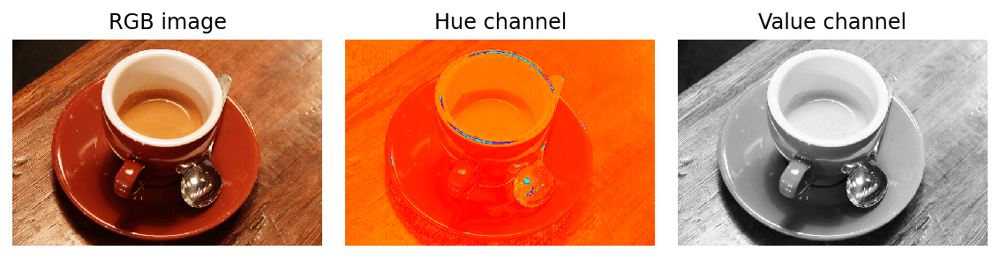

In [170]:
from skimage import data
from skimage.color import rgb2hsv

rgb_img = data.coffee()
hsv_img = rgb2hsv(rgb_img)
hue_img = hsv_img[:, :, 0]
value_img = hsv_img[:, :, 2]

fig, (ax0, ax1, ax2) = plt.subplots(ncols=3, figsize=(8, 2))

ax0.imshow(rgb_img)
ax0.set_title("RGB image")
ax0.axis('off')
ax1.imshow(hue_img, cmap='hsv')
ax1.set_title("Hue channel")
ax1.axis('off')
ax2.imshow(value_img)
ax2.set_title("Value channel")
ax2.axis('off')

fig.tight_layout();

The cup and saucer have a Hue distinct from the remainder of the image, which can be isolated by thresholding

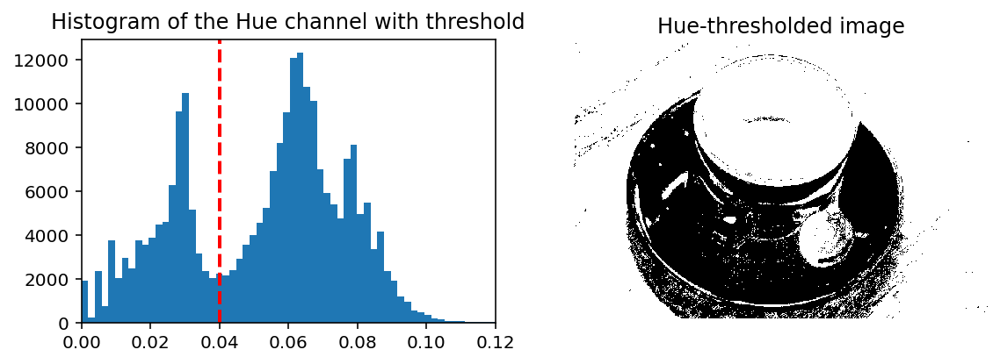

In [171]:
hue_threshold = 0.04
binary_img = hue_img > hue_threshold

fig, (ax0, ax1) = plt.subplots(ncols=2, figsize=(8, 3))

ax0.hist(hue_img.ravel(), 512)
ax0.set_title("Histogram of the Hue channel with threshold")
ax0.axvline(x=hue_threshold, color='r', linestyle='dashed', linewidth=2)
ax0.set_xbound(0, 0.12)
ax1.imshow(binary_img)
ax1.set_title("Hue-thresholded image")
ax1.axis('off')

fig.tight_layout();

An additional threshold in the value channel can remote most of the shadow

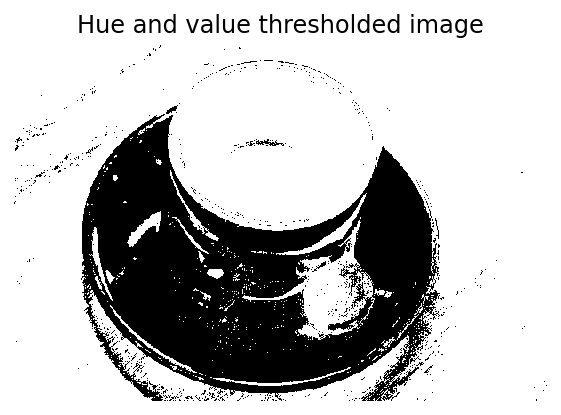

In [172]:
fig, ax0 = plt.subplots(figsize=(4, 3))

value_threshold = 0.10
binary_img = (hue_img > hue_threshold) | (value_img < value_threshold)

ax0.imshow(binary_img)
ax0.set_title("Hue and value thresholded image")
ax0.axis('off')

fig.tight_layout()
plt.show();

#### Additional color conversion examples available in the [online gallery](https://scikit-image.org/docs/stable/auto_examples/#manipulating-exposure-and-color-channels).

#### [Back to the Table of Contents](#Table-of-Contents)

## [skimage.data](https://scikit-image.org/docs/stable/api/skimage.data.html) - test images<a id='data'></a>

The `data` submodule includes standard test images useful for examples and testing the package.  These images are shipped with the package.

There are scientific images, general test images, and a stereoscopic image.

In [173]:
from skimage import data

In [174]:
# Explore with tab completion
example_image = data.camera()

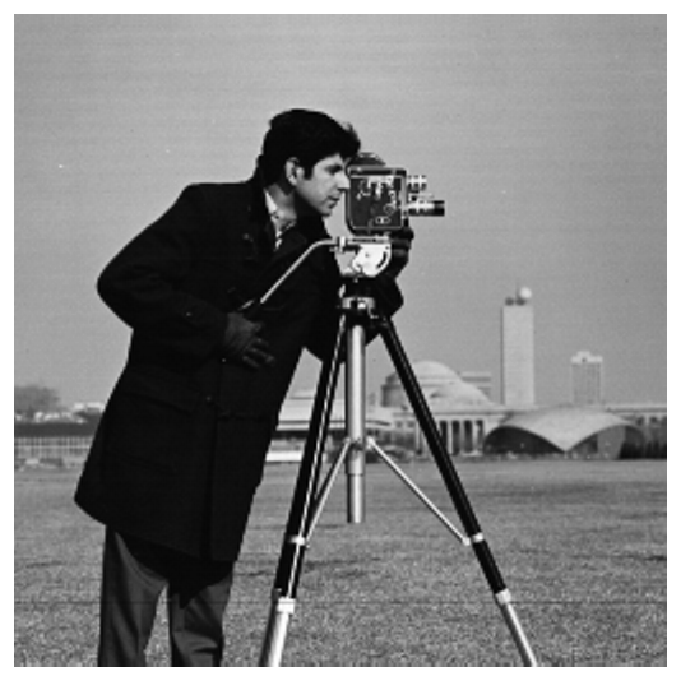

In [175]:
fig, ax = plt.subplots(figsize=(6, 6))
ax.imshow(example_image)
ax.axis('off');

In [ ]:
# Room for experimentation


-----------------------

## [skimage.draw](https://scikit-image.org/docs/stable/api/skimage.draw.html) - drawing primitives on an image<a id='draw'></a>

The majority of functions in this submodule return the *coordinates* of the specified shape/object in the image, rather than drawing it on the image directly.  The coordinates can then be used as a mask to draw on the image, or you pass the image as well as those coordinates into the convenience function `draw.set_color`.

Lines and circles can be drawn with antialiasing (these functions end in the suffix *_aa).

At the current time text is not supported; other libraries including matplotlib have robust support for overlaying text.

In [176]:
from skimage import draw

In [177]:
# Tab complete to see available options
draw.

SyntaxError: invalid syntax (<ipython-input-177-de9764663472>, line 2)

In [178]:
# Room for experimentation


## Example: drawing shapes

/Users/joshagar/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:21: FutureWarning: circle is deprecated in favor of disk.circle will be removed in version 0.19


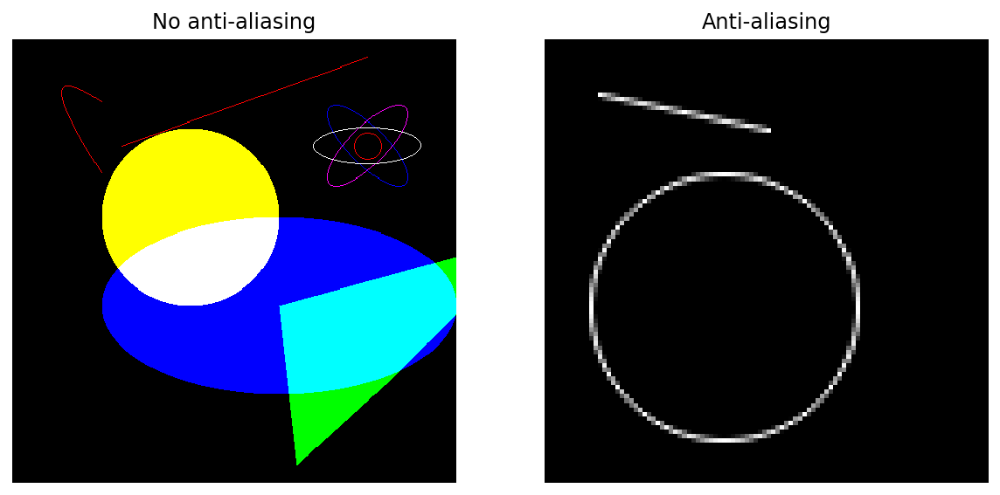

In [179]:
fig, (ax1, ax2) = plt.subplots(ncols=2, nrows=1, figsize=(10, 6))

img = np.zeros((500, 500, 3), dtype=np.float64)

# draw line
rr, cc = draw.line(120, 123, 20, 400)
img[rr, cc, 0] = 255

# fill polygon
poly = np.array((
    (300, 300),
    (480, 320),
    (380, 430),
    (220, 590),
    (300, 300),
))
rr, cc = draw.polygon(poly[:, 0], poly[:, 1], img.shape)
img[rr, cc, 1] = 1

# fill circle
rr, cc = draw.circle(200, 200, 100, img.shape)
img[rr, cc, :] = (1, 1, 0)

# fill ellipse
rr, cc = draw.ellipse(300, 300, 100, 200, img.shape)
img[rr, cc, 2] = 1

# circle
rr, cc = draw.circle_perimeter(120, 400, 15)
img[rr, cc, :] = (1, 0, 0)

# Bezier curve
rr, cc = draw.bezier_curve(70, 100, 10, 10, 150, 100, 1)
img[rr, cc, :] = (1, 0, 0)

# ellipses
rr, cc = draw.ellipse_perimeter(120, 400, 60, 20, orientation=np.pi / 4.)
img[rr, cc, :] = (1, 0, 1)
rr, cc = draw.ellipse_perimeter(120, 400, 60, 20, orientation=-np.pi / 4.)
img[rr, cc, :] = (0, 0, 1)
rr, cc = draw.ellipse_perimeter(120, 400, 60, 20, orientation=np.pi / 2.)
img[rr, cc, :] = (1, 1, 1)

ax1.imshow(img)
ax1.set_title('No anti-aliasing')
ax1.axis('off')


img = np.zeros((100, 100), dtype=np.double)

# anti-aliased line
rr, cc, val = draw.line_aa(12, 12, 20, 50)
img[rr, cc] = val

# anti-aliased circle
rr, cc, val = draw.circle_perimeter_aa(60, 40, 30)
img[rr, cc] = val


ax2.imshow(img, cmap=plt.cm.gray, interpolation='nearest')
ax2.set_title('Anti-aliasing')
ax2.axis('off');

#### [Back to the Table of Contents](#Table-of-Contents)

-----------------------------------------

## [skimage.exposure](https://scikit-image.org/docs/stable/api/skimage.exposure.html) - evaluating or changing the exposure of an image<a id='exposure'></a>

One of the most common tools to evaluate exposure is the *histogram*, which plots the number of points which have a certain value against the values in order from lowest (dark) to highest (light).  The function `exposure.histogram` differs from `numpy.histogram` in that there is no rebinnning; each value along the x-axis is preserved.

### Example: Histogram equalization

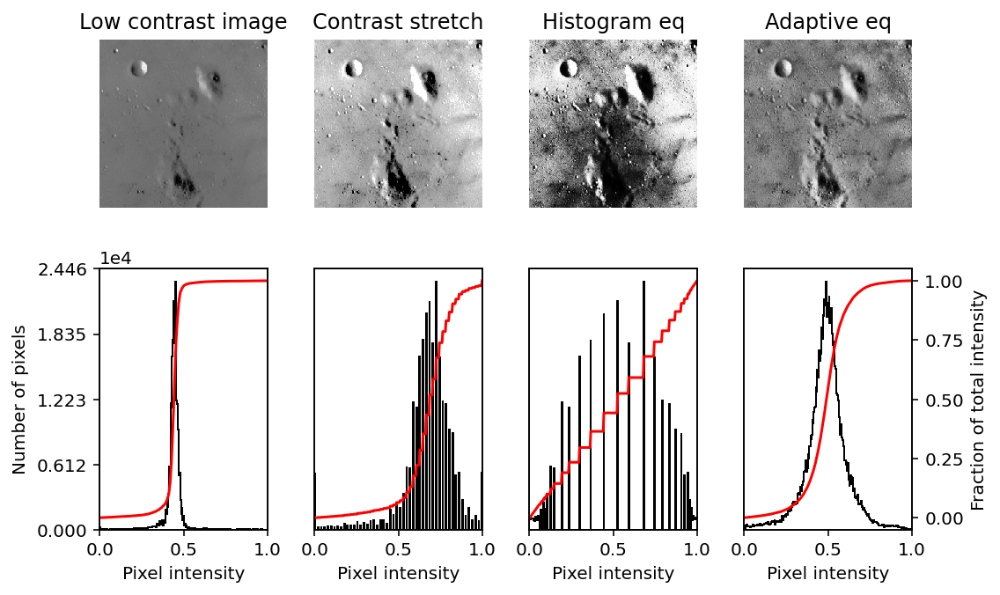

In [180]:
from skimage import data, img_as_float
from skimage import exposure


def plot_img_and_hist(image, axes, bins=256):
    """Plot an image along with its histogram and cumulative histogram.

    """
    image = img_as_float(image)
    ax_img, ax_hist = axes
    ax_cdf = ax_hist.twinx()

    # Display image
    ax_img.imshow(image, cmap=plt.cm.gray)
    ax_img.set_axis_off()

    # Display histogram
    ax_hist.hist(image.ravel(), bins=bins, histtype='step', color='black')
    ax_hist.ticklabel_format(axis='y', style='scientific', scilimits=(0, 0))
    ax_hist.set_xlabel('Pixel intensity')
    ax_hist.set_xlim(0, 1)
    ax_hist.set_yticks([])

    # Display cumulative distribution
    img_cdf, bins = exposure.cumulative_distribution(image, bins)
    ax_cdf.plot(bins, img_cdf, 'r')
    ax_cdf.set_yticks([])

    return ax_img, ax_hist, ax_cdf


# Load an example image
img = data.moon()

# Contrast stretching
p2, p98 = np.percentile(img, (2, 98))
img_rescale = exposure.rescale_intensity(img, in_range=(p2, p98))

# Equalization
img_eq = exposure.equalize_hist(img)

# Adaptive Equalization
img_adapteq = exposure.equalize_adapthist(img, clip_limit=0.03)

# Display results
fig = plt.figure(figsize=(8, 5))
axes = np.zeros((2, 4), dtype=np.object)
axes[0, 0] = fig.add_subplot(2, 4, 1)
for i in range(1, 4):
    axes[0, i] = fig.add_subplot(2, 4, 1+i, 
                                 sharex=axes[0,0], sharey=axes[0,0])
for i in range(0, 4):
    axes[1, i] = fig.add_subplot(2, 4, 5+i)

ax_img, ax_hist, ax_cdf = plot_img_and_hist(img, axes[:, 0])
ax_img.set_title('Low contrast image')

y_min, y_max = ax_hist.get_ylim()
ax_hist.set_ylabel('Number of pixels')
ax_hist.set_yticks(np.linspace(0, y_max, 5))

ax_img, ax_hist, ax_cdf = plot_img_and_hist(img_rescale, axes[:, 1])
ax_img.set_title('Contrast stretch')

ax_img, ax_hist, ax_cdf = plot_img_and_hist(img_eq, axes[:, 2])
ax_img.set_title('Histogram eq')

ax_img, ax_hist, ax_cdf = plot_img_and_hist(img_adapteq, axes[:, 3])
ax_img.set_title('Adaptive eq')

ax_cdf.set_ylabel('Fraction of total intensity')
ax_cdf.set_yticks(np.linspace(0, 1, 5))

# prevent overlap of y-axis labels
fig.tight_layout();

In [181]:
# Explore with tab completion
exposure.

SyntaxError: invalid syntax (<ipython-input-181-4fbcddd737bf>, line 2)

In [182]:
# Room for experimentation


#### Additional examples available in the [example gallery](https://scikit-image.org/docs/stable/auto_examples/#manipulating-exposure-and-color-channels)

#### [Back to the Table of Contents](#Table-of-Contents)

----------------------

## [skimage.feature](https://scikit-image.org/docs/stable/api/skimage.feature.html) - extract features from an image<a id='feature'></a>

This submodule presents a diverse set of tools to identify or extract certain features from images, including tools for

* Edge detection
  * `feature.canny`
* Corner detection
  * `feature.corner_kitchen_rosenfeld`
  * `feature.corner_harris`
  * `feature.corner_shi_tomasi`
  * `feature.corner_foerstner`
  * `feature.subpix`
  * `feature.corner_moravec`
  * `feature.corner_fast`
  * `feature.corner_orientations`
* Blob detection
  * `feature.blob_dog`
  * `feature.blob_doh`
  * `feature.blob_log`
* Texture
  * `feature.greycomatrix`
  * `feature.greycoprops`
  * `feature.local_binary_pattern`
  * `feature.multiblock_lbp`
* Peak finding
  * `feature.peak_local_max`
* Object detction
  * `feature.hog`
  * `feature.match_template`
* Stereoscopic depth estimation
  * `feature.daisy`
* Feature matching
  * `feature.ORB`
  * `feature.BRIEF`
  * `feature.CENSURE`
  * `feature.match_descriptors`
  * `feature.plot_matches`


In [183]:
from skimage import feature

In [184]:
# Explore with tab completion
feature.

SyntaxError: invalid syntax (<ipython-input-184-ba02b7ba67d2>, line 2)

In [185]:
# Room for experimentation


This is a large submodule.  For brevity here is a short example illustrating ORB feature matching, and additional examples can be explored in the [online gallery](https://scikit-image.org/docs/stable/auto_examples/index.html#detection-of-features-and-objects).

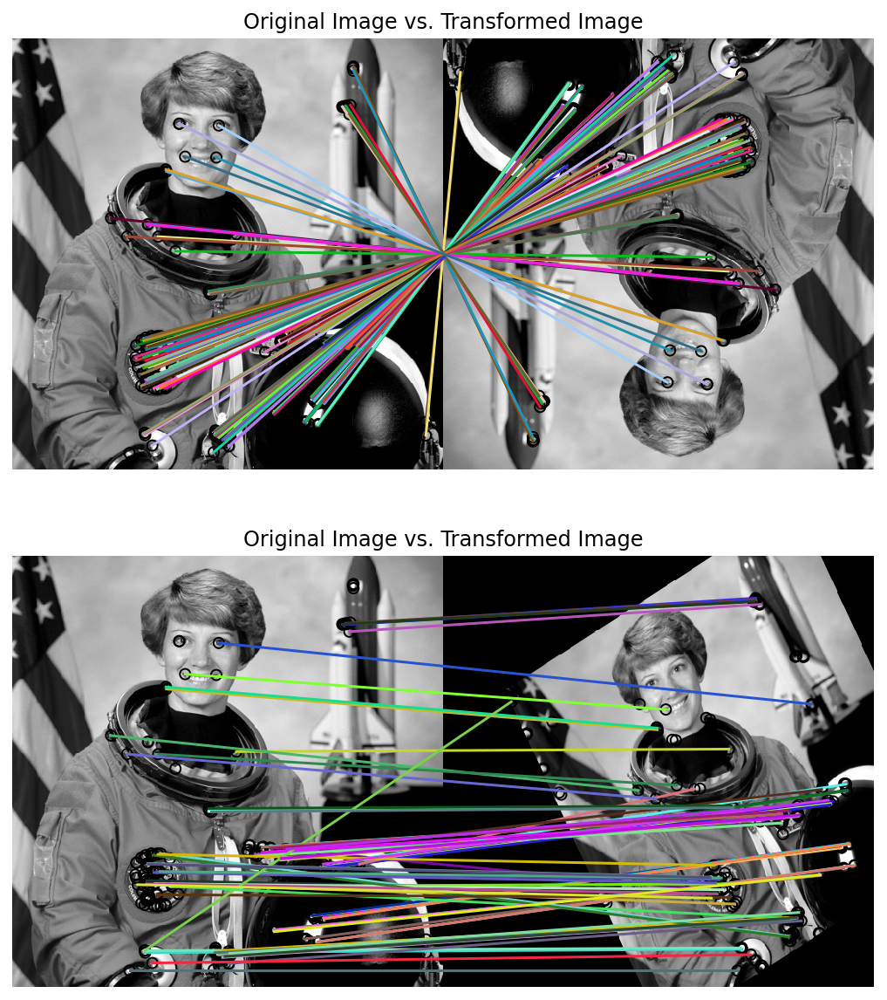

In [186]:
from skimage import data
from skimage import transform as tf
from skimage import feature
from skimage.color import rgb2gray

# Import the astronaut then warp/rotate the image
img1 = rgb2gray(data.astronaut())
img2 = tf.rotate(img1, 180)
tform = tf.AffineTransform(scale=(1.3, 1.1), rotation=0.5,
                           translation=(0, -200))
img3 = tf.warp(img1, tform)

# Build ORB extractor and extract features
descriptor_extractor = feature.ORB(n_keypoints=200)

descriptor_extractor.detect_and_extract(img1)
keypoints1 = descriptor_extractor.keypoints
descriptors1 = descriptor_extractor.descriptors

descriptor_extractor.detect_and_extract(img2)
keypoints2 = descriptor_extractor.keypoints
descriptors2 = descriptor_extractor.descriptors

descriptor_extractor.detect_and_extract(img3)
keypoints3 = descriptor_extractor.keypoints
descriptors3 = descriptor_extractor.descriptors

# Find matches between the extracted features
matches12 = feature.match_descriptors(descriptors1, descriptors2, cross_check=True)
matches13 = feature.match_descriptors(descriptors1, descriptors3, cross_check=True)

# Plot the results
fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(10, 10))

plt.gray()

feature.plot_matches(ax[0], img1, img2, keypoints1, keypoints2, matches12)
ax[0].axis('off')
ax[0].set_title("Original Image vs. Transformed Image")

feature.plot_matches(ax[1], img1, img3, keypoints1, keypoints3, matches13)
ax[1].axis('off')
ax[1].set_title("Original Image vs. Transformed Image");

#### Additional feature detection and extraction examples available in the [online gallery](https://scikit-image.org/docs/stable/auto_examples/index.html#detection-of-features-and-objects).

In [ ]:
# Room for experimentation


#### [Back to the Table of Contents](#Table-of-Contents)

---------------------------

## [skimage.filters](https://scikit-image.org/docs/stable/api/skimage.filters.html) - apply filters to an image<a id='filters'></a>

Filtering applies whole-image modifications such as sharpening or blurring.  Thresholding methods also live in this submodule.

Notable functions include (links to relevant gallery examples)

* [Thresholding](https://scikit-image.org/docs/stable/auto_examples/applications/plot_thresholding.html)
  * filters.threshold_* (multiple different functions with this prefix)
  * skimage.filters.try_all_threshold to compare various methods
* [Edge finding/enhancement](https://scikit-image.org/docs/stable/auto_examples/edges/plot_edge_filter.html)
  * filters.sobel
  * filters.prewitt
  * filters.scharr
  * filters.roberts
  * filters.laplace
  * filters.hessian
* [Ridge filters](https://scikit-image.org/docs/stable/auto_examples/edges/plot_ridge_filter.html)
  * filters.meijering
  * filters.sato
  * filters.frangi
* Inverse filtering (see also [skimage.restoration](#restoration))
  * filters.weiner
  * filters.inverse
* [Directional](https://scikit-image.org/docs/stable/auto_examples/features_detection/plot_gabor.html)
  * filters.gabor
* Blurring/denoising
  * filters.gaussian
  * filters.median
* [Sharpening](https://scikit-image.org/docs/stable/auto_examples/filters/plot_unsharp_mask.html)
  * filters.unsharp_mask
* Define your own
  * LPIFilter2D

In [187]:
from skimage import filters

In [188]:
# Explore with tab completion
filters.

SyntaxError: invalid syntax (<ipython-input-188-c6aaaf0695a7>, line 2)

### Rank filters
There is a sub-submodule, `skimage.filters.rank`, which contains rank filters.  These filters are nonlinear and operate on the local histogram.

To learn more about the rank filters, see the comprehensive [gallery example for rank filters](https://scikit-image.org/docs/stable/auto_examples/applications/plot_rank_filters.html).

#### Additional feature detection and extraction examples available in the [online gallery](https://scikit-image.org/docs/stable/auto_examples/index.html#detection-of-features-and-objects).

#### [Back to the Table of Contents](#Table-of-Contents)

---------------------------

## [skimage.future](https://scikit-image.org/docs/stable/api/skimage.future.html) - stable code with unstable API<a id='future'></a>

Bleeding edge features which work well, and will be moved from here into the main package in future releases.  However, on the way their API may change.

#### [Back to the Table of Contents](#Table-of-Contents)

------------------------------

## [skimage.graph](https://scikit-image.org/docs/stable/api/skimage.graph.html) - graph theory, minimum cost paths<a id='graph'></a>

Graph theory.  Currently this submodule primarily deals with a constructed "cost" image, and how to find the minimum cost path through it, with constraints if desired.

[The panorama tutorial lecture illustrates a real-world example.](./solutions/adv3_panorama-stitching-solution.ipynb)

#### [Back to the Table of Contents](#Table-of-Contents)

------------------------

## [skimage.io](https://scikit-image.org/docs/stable/api/skimage.io.html) - utilities to read and write images in various formats<a id='io'></a>

Reading your image and writing the results back out.  There are multiple plugins available, which support multiple formats.  The most commonly used functions include

* io.imread - Read an image to a numpy array.
* io.imsave - Write an image to disk.
* io.imread_collection - Read multiple images which match a common prefix


#### [Back to the Table of Contents](#Table-of-Contents)

------------------------------

## <a id='measure'></a>[skimage.measure](https://scikit-image.org/docs/stable/api/skimage.measure.html) - measuring image or region properties

Multiple algorithms to label images, or obtain information about discrete regions of an image.  

* Label an image
  * measure.label
  
 
* In a labeled image (image with discrete regions identified by unique integers, as returned by `label`), find various properties of the labeled regions.  [**`regionprops` is extremely useful**](https://scikit-image.org/docs/stable/auto_examples/segmentation/plot_regionprops.html)
  * measure.regionprops


* Finding paths from a 2D image, or isosurfaces from a 3D image
  * measure.find_contours
  * measure.marching_cubes_lewiner
  * measure.marching_cubes_classic
  * measure.mesh_surface_area (surface area of 3D mesh from marching cubes)


* Quantify the difference between two whole images (often used in denoising or restoration)
  * measure.compare_*


**RANDom Sample Consensus fitting (RANSAC)** - a powerful, robust approach to fitting a model to data.  It exists here because its initial use was for fitting shapes, but it can also fit transforms.
* measure.ransac
* measure.CircleModel
* measure.EllipseModel
* measure.LineModelND



In [ ]:
from skimage import measure

In [ ]:
# Explore with tab completion
measure.

In [ ]:
# Room to explore


In [189]:
import math
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

from skimage.draw import ellipse
from skimage.measure import label, regionprops, regionprops_table
from skimage.transform import rotate


image = np.zeros((600, 600))

rr, cc = ellipse(300, 350, 100, 220)
image[rr, cc] = 1

image = rotate(image, angle=15, order=0)

rr, cc = ellipse(100, 100, 60, 50)
image[rr, cc] = 1

label_img = label(image)
regions = regionprops(label_img)

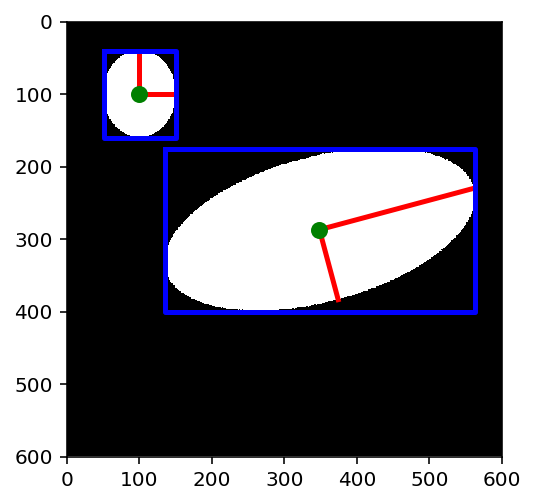

In [190]:
fig, ax = plt.subplots()
ax.imshow(image, cmap=plt.cm.gray)

for props in regions:
    y0, x0 = props.centroid
    orientation = props.orientation
    x1 = x0 + math.cos(orientation) * 0.5 * props.minor_axis_length
    y1 = y0 - math.sin(orientation) * 0.5 * props.minor_axis_length
    x2 = x0 - math.sin(orientation) * 0.5 * props.major_axis_length
    y2 = y0 - math.cos(orientation) * 0.5 * props.major_axis_length

    ax.plot((x0, x1), (y0, y1), '-r', linewidth=2.5)
    ax.plot((x0, x2), (y0, y2), '-r', linewidth=2.5)
    ax.plot(x0, y0, '.g', markersize=15)

    minr, minc, maxr, maxc = props.bbox
    bx = (minc, maxc, maxc, minc, minc)
    by = (minr, minr, maxr, maxr, minr)
    ax.plot(bx, by, '-b', linewidth=2.5)

ax.axis((0, 600, 600, 0))
plt.show()

We use the `skimage.measure.regionprops_table()` to compute (selected) properties for each region. Note that `skimage.measure.regionprops_table` actually computes the properties, whereas `skimage.measure.regionprops` computes them when they come in use (lazy evaluation).

In [191]:
props = regionprops_table(label_img, properties=('centroid',
                                                 'orientation',
                                                 'major_axis_length',
                                                 'minor_axis_length'))

We now display a table of these selected properties (one region per row), the `skimage.measure.regionprops_table` result being a pandas-compatible dict.

In [192]:
pd.DataFrame(props)

,centroid-0,centroid-1,orientation,major_axis_length,minor_axis_length
0,100.000000,100.000000,0.000000,119.807049,99.823995
1,286.914167,348.412995,-1.308966,440.015503,199.918850


#### [Back to the Table of Contents](#Table-of-Contents)

---------------------

## <a id='morphology'></a>[skimage.morphology](https://scikit-image.org/docs/stable/api/skimage.morphology.html) - binary and grayscale morphology

Morphological image processing is a collection of non-linear operations related to the shape or morphology of features in an image, such as boundaries, skeletons, etc. In any given technique, we probe an image with a small shape or template called a structuring element, which defines the region of interest or neighborhood around a pixel.

In [193]:
from skimage import morphology as morph

In [194]:
# Explore with tab completion
morph.

SyntaxError: invalid syntax (<ipython-input-194-784058961cc9>, line 2)

### Example: Flood filling

Flood fill is an algorithm to iteratively identify and/or change adjacent values in an image based on their similarity to an initial seed point. The conceptual analogy is the ‘paint bucket’ tool in many graphic editors.

The `flood` function returns the binary mask of the flooded area.  `flood_fill` returns a modified image.  Both of these can be set with a `tolerance` keyword argument, within which the adjacent region will be filled.

Here we will experiment a bit on the cameraman, turning his coat from dark to light.

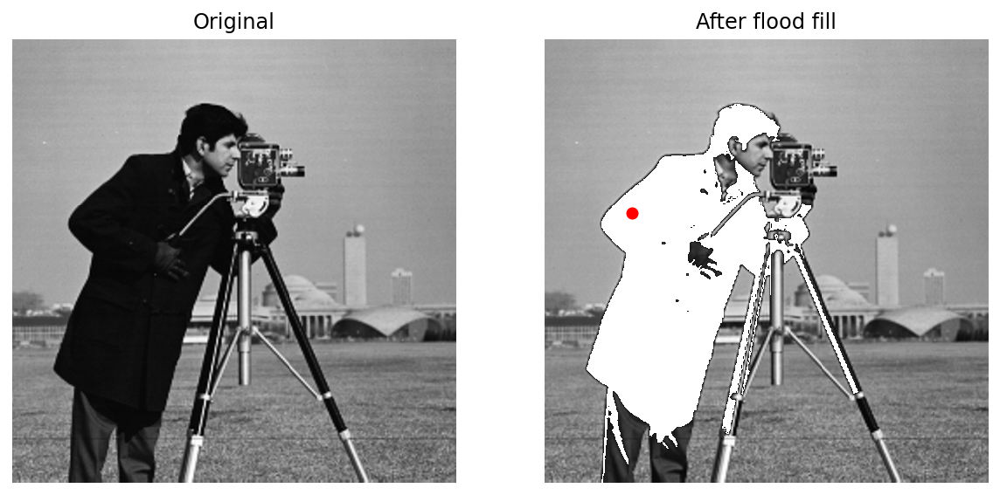

In [195]:
from skimage import data
from skimage import morphology as morph

cameraman = data.camera()

# Change the cameraman's coat from dark to light (255).  The seed point is
# chosen as (200, 100),
light_coat = morph.flood_fill(cameraman, (200, 100), 255, tolerance=10)

fig, ax = plt.subplots(ncols=2, figsize=(10, 5))

ax[0].imshow(cameraman, cmap=plt.cm.gray)
ax[0].set_title('Original')
ax[0].axis('off')

ax[1].imshow(light_coat, cmap=plt.cm.gray)
ax[1].plot(100, 200, 'ro')  # seed point
ax[1].set_title('After flood fill')
ax[1].axis('off');

### Example: Binary and grayscale morphology

Here we outline the following basic morphological operations:

1. Erosion
2. Dilation
3. Opening
4. Closing
5. White Tophat
6. Black Tophat
7. Skeletonize
8. Convex Hull

To get started, let’s load an image using `io.imread`. Note that morphology functions only work on gray-scale or binary images, so we set `as_gray=True`.

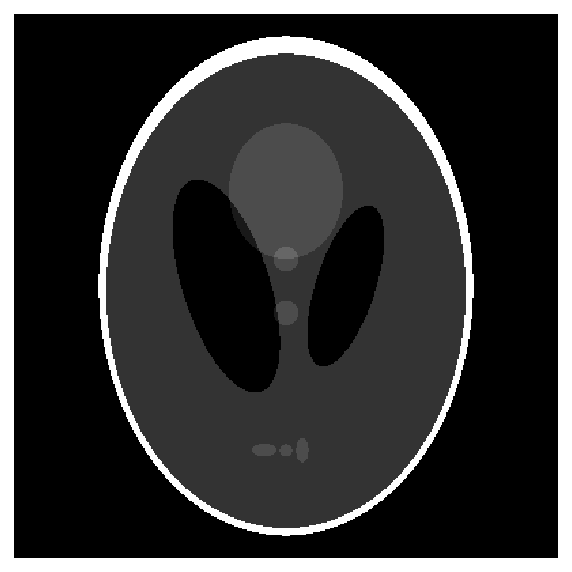

In [196]:
import os
from skimage.data import data_dir
from skimage.util import img_as_ubyte
from skimage import io

orig_phantom = img_as_ubyte(io.imread(os.path.join(data_dir, "phantom.png"),
                                      as_gray=True))
fig, ax = plt.subplots(figsize=(5, 5))
ax.imshow(orig_phantom, cmap=plt.cm.gray)
ax.axis('off');

In [197]:
def plot_comparison(original, filtered, filter_name):

    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(8, 4), sharex=True,
                                   sharey=True)
    ax1.imshow(original, cmap=plt.cm.gray)
    ax1.set_title('original')
    ax1.axis('off')
    ax2.imshow(filtered, cmap=plt.cm.gray)
    ax2.set_title(filter_name)
    ax2.axis('off')

### Erosion

Morphological `erosion` sets a pixel at (i, j) to the minimum over all pixels in the neighborhood centered at (i, j). *Erosion shrinks bright regions and enlarges dark regions.*

The structuring element, `selem`, passed to erosion is a boolean array that describes this neighborhood. Below, we use `disk` to create a circular structuring element, which we use for most of the following examples.

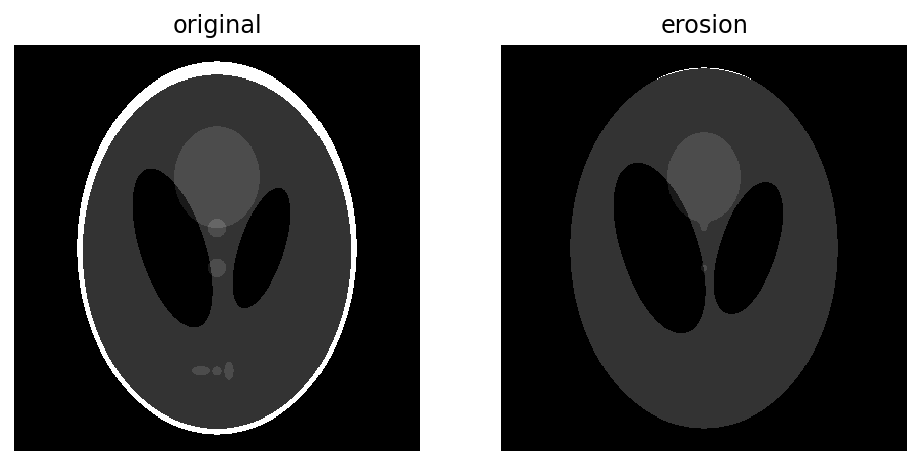

In [198]:
from skimage import morphology as morph

selem = morph.disk(6)
eroded = morph.erosion(orig_phantom, selem)
plot_comparison(orig_phantom, eroded, 'erosion')

### Dilation

Morphological `dilation` sets a pixel at (i, j) to the maximum over all pixels in the neighborhood centered at (i, j). *Dilation enlarges bright regions and shrinks dark regions.*

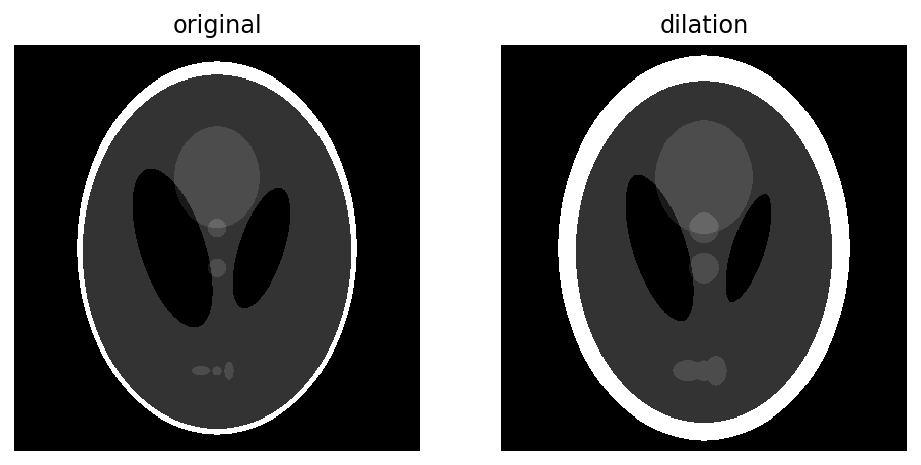

In [199]:
dilated = morph.dilation(orig_phantom, selem)
plot_comparison(orig_phantom, dilated, 'dilation')

Notice how the white boundary of the image thickens, or gets dilated, as we increase the size of the disk. Also notice the decrease in size of the two black ellipses in the centre, and the thickening of the light grey circle in the center and the 3 patches in the lower part of the image.

### Opening

Morphological `opening` on an image is defined as an erosion followed by a dilation. *Opening can remove small bright spots (i.e. “salt”) and connect small dark cracks.*

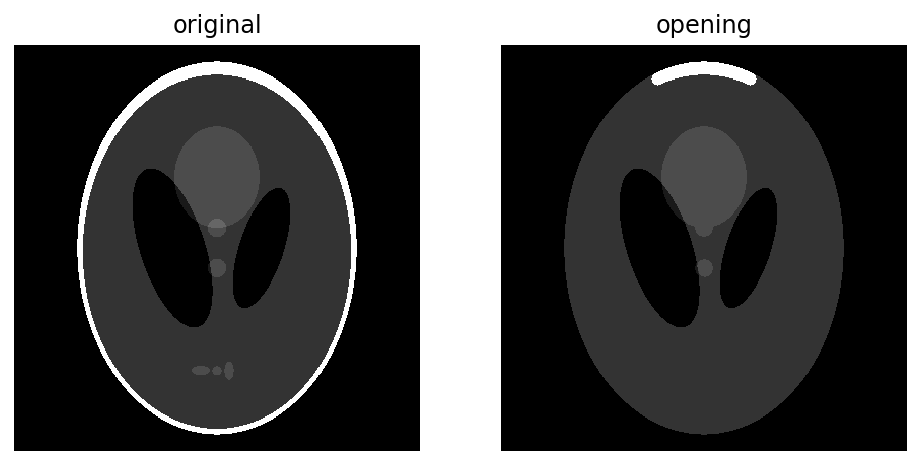

In [200]:
opened = morph.opening(orig_phantom, selem)
plot_comparison(orig_phantom, opened, 'opening')

Since opening an image starts with an erosion operation, light regions that are smaller than the structuring element are removed. The dilation operation that follows ensures that light regions that are larger than the structuring element retain their original size. Notice how the light and dark shapes in the center their original thickness but the 3 lighter patches in the bottom get completely eroded. The size dependence is highlighted by the outer white ring: The parts of the ring thinner than the structuring element were completely erased, while the thicker region at the top retains its original thickness.

### Closing

Morphological `closing` on an image is defined as a dilation followed by an erosion. *Closing can remove small dark spots (i.e. “pepper”) and connect small bright cracks.*

To illustrate this more clearly, let’s add a small crack to the white border:

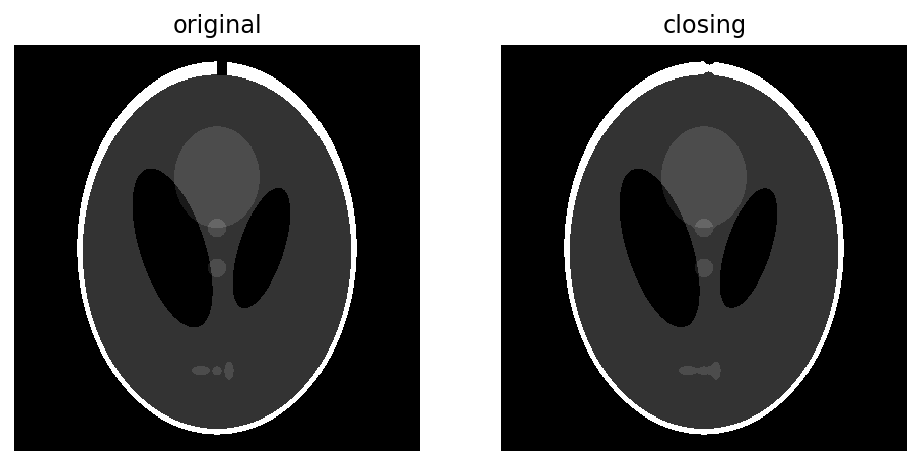

In [201]:
phantom = orig_phantom.copy()
phantom[10:30, 200:210] = 0

closed = morph.closing(phantom, selem)
plot_comparison(phantom, closed, 'closing')

Since closing an image starts with an dilation operation, dark regions that are smaller than the structuring element are removed. The dilation operation that follows ensures that dark regions that are larger than the structuring element retain their original size. Notice how the white ellipses at the bottom get connected because of dilation, but other dark region retain their original sizes. Also notice how the crack we added is mostly removed.

### White tophat

The `white_tophat` of an image is defined as the image minus its morphological opening. *This operation returns the bright spots of the image that are smaller than the structuring element.*

To make things interesting, we’ll add bright and dark spots to the image:

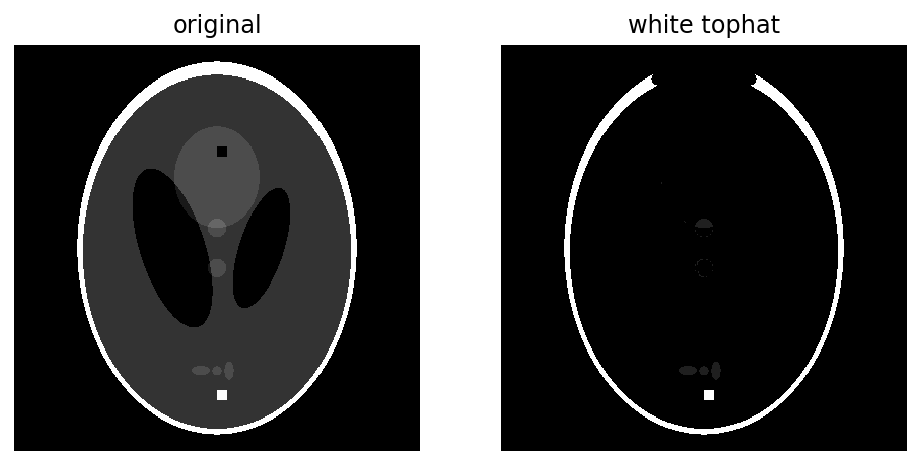

In [202]:
phantom = orig_phantom.copy()
phantom[340:350, 200:210] = 255
phantom[100:110, 200:210] = 0

w_tophat = morph.white_tophat(phantom, selem)
plot_comparison(phantom, w_tophat, 'white tophat')

As you can see, the 10-pixel wide white square is highlighted since it is smaller than the structuring element. Also, the thin, white edges around most of the ellipse are retained because they’re smaller than the structuring element, but the thicker region at the top disappears.

### Black tophat

The `black_tophat` of an image is defined as its morphological closing minus the original image. *This operation returns the dark spots of the image that are smaller than the structuring element.*

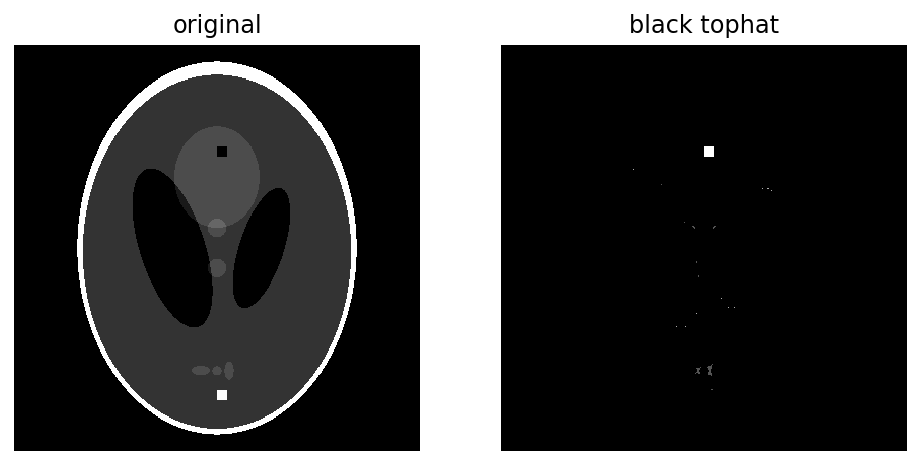

In [203]:
b_tophat = morph.black_tophat(phantom, selem)
plot_comparison(phantom, b_tophat, 'black tophat')

As you can see, the 10-pixel wide black square is highlighted since it is smaller than the structuring element.

#### Duality

As you should have noticed, many of these operations are simply the reverse of another operation. This duality can be summarized as follows:

* Erosion <-> Dilation
* Opening <-> Closing
* White tophat <-> Black tophat


### Skeletonize

Thinning is used to reduce each connected component in a binary image to a single-pixel wide skeleton. It is important to note that this is performed on binary images only.

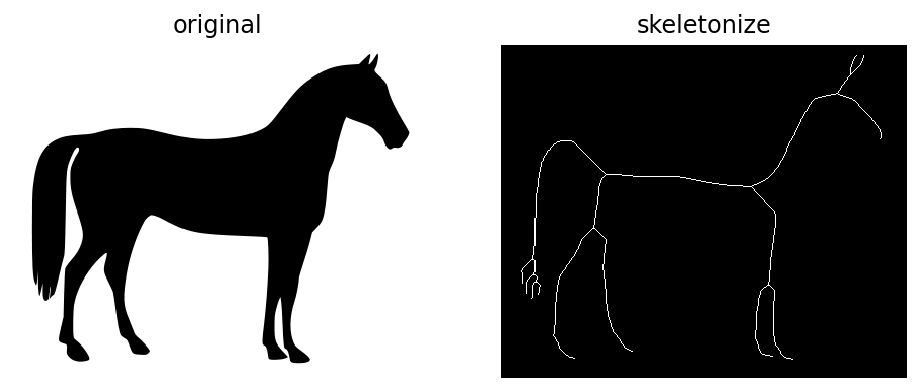

In [204]:
horse = io.imread(os.path.join(data_dir, "horse.png"), as_gray=True)

sk = morph.skeletonize(horse == 0)
plot_comparison(horse, sk, 'skeletonize')

As the name suggests, this technique is used to thin the image to 1-pixel wide skeleton by applying thinning successively.

### Convex hull

The convex_hull_image is the set of pixels included in the smallest convex polygon that surround all white pixels in the input image. Again note that this is also performed on binary images.

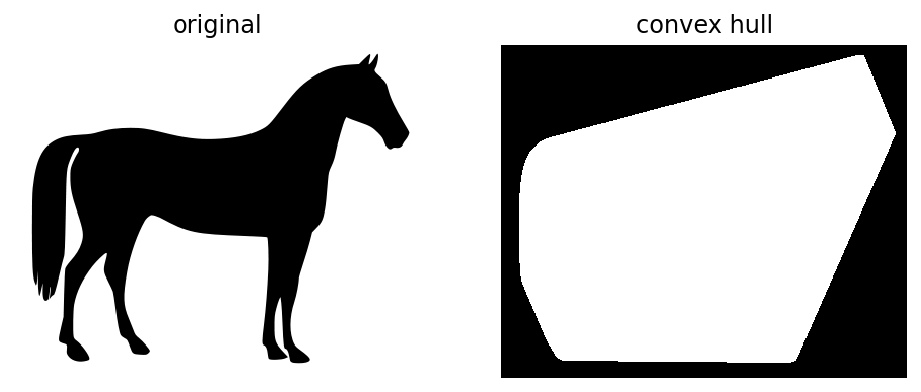

In [205]:
hull1 = morph.convex_hull_image(horse == 0)
plot_comparison(horse, hull1, 'convex hull')

#### [Back to the Table of Contents](#Table-of-Contents)

-----------------------------------

## [skimage.restoration](https://scikit-image.org/docs/stable/api/skimage.restoration.html) - restoration of an image<a id='restoration'></a>

This submodule includes routines to restore images.  Currently these routines fall into four major categories.  Links lead to topical gallery examples.

* [Reducing noise](https://scikit-image.org/docs/stable/auto_examples/filters/plot_denoise.html)
  * restoration.denoise_*
* [Deconvolution](https://scikit-image.org/docs/stable/auto_examples/filters/plot_deconvolution.html), or reversing a convolutional effect which applies to the entire image.  For example, lens correction.  This can be done [unsupervised](https://scikit-image.org/docs/stable/auto_examples/filters/plot_restoration.html).
  * restoration.weiner
  * restoration.unsupervised_weiner
  * restoration.richardson_lucy
* [Inpainting](https://scikit-image.org/docs/stable/auto_examples/filters/plot_inpaint.html), or filling in missing areas of an image
  * restoration.inpaint_biharmonic
* [Phase unwrapping](https://scikit-image.org/docs/stable/auto_examples/filters/plot_phase_unwrap.html)
  * restoration.unwrap_phase

In [206]:
from skimage import restoration

In [207]:
# Explore with tab completion
restoration.

SyntaxError: invalid syntax (<ipython-input-207-579526cd8a19>, line 2)

In [208]:
# Space to experiment with restoration techniques


#### [Back to the Table of Contents](#Table-of-Contents)

---------------------------------

## <a id='segmentation'></a>[skimage.segmentation](https://scikit-image.org/docs/stable/api/skimage.segmentation.html) - identification of regions of interest

One of the key image analysis tasks is identifying regions of interest.  These could be a person, an object, certain features of an animal, microscopic image, or stars.  Segmenting an image is the process of determining where these things you want are in your images.

Segmentation has two overarching categories: Supervised and Unsupervised.

**Supervised** - must provide some guidance (seed points or initial conditions)

* segmentation.random_walker
* segmentation.active_contour
* segmentation.watershed
* segmentation.flood_fill
* segmentation.flood
* some thresholding algorithms in `filters`


**Unsupervised** - no human input

* segmentation.slic
* segmentation.felzenszwalb
* segmentation.chan_vese
* some thresholding algorithms in `filters`


There is a [segmentation lecture](./4_segmentation.ipynb) ([and solution](./solutions/4_segmentation.ipynb)) you may peruse, as well as many [gallery examples](https://scikit-image.org/docs/stable/auto_examples/index.html#segmentation-of-objects) which illustrate all of these segmentation methods.

In [209]:
from skimage import segmentation

In [210]:
# Explore with tab completion
segmentation.

SyntaxError: invalid syntax (<ipython-input-210-860a58fd527d>, line 2)

In [211]:
# Room for experimentation


#### [Back to the Table of Contents](#Table-of-Contents)

---------------------------

## [skimage.transform](https://scikit-image.org/docs/stable/api/skimage.transform.html) - transforms & warping<a id='transform'></a>

This submodule has multiple features which fall under the umbrella of transformations.

Forward (`radon`) and inverse (`iradon`) radon transforms, as well as some variants (`iradon_sart`) and the finite versions of these transforms (`frt2` and `ifrt2`).  These are used for [reconstructing medical computed tomography (CT) images](https://scikit-image.org/docs/stable/auto_examples/transform/plot_radon_transform.html).

Hough transforms for identifying lines, circles, and ellipses.

Changing image size, shape, or resolution with `resize`, `rescale`, or `downscale_local_mean`.

`warp`, and `warp_coordinates` which take an image or set of coordinates and translate them through one of the defined `*Transforms` in this submodule.  `estimate_transform` may be assist in estimating the parameters.

[Numerous gallery examples are available](https://scikit-image.org/docs/stable/auto_examples/index.html#geometrical-transformations-and-registration) illustrating these functions.  [The panorama tutorial also includes warping](./solutions/adv3_panorama-stitching-solution.ipynb) via `SimilarityTransform` with parameter estimation via `measure.ransac`.

In [212]:
from skimage import transform

In [213]:
# Explore with tab completion
transform.

SyntaxError: invalid syntax (<ipython-input-213-74d868e62113>, line 2)

In [214]:
# Room for experimentation


#### [Back to the Table of Contents](#Table-of-Contents)


--------------------------

## [skimage.util](https://scikit-image.org/docs/stable/api/skimage.util.html) - utility functions<a id='util'></a>

These are generally useful functions which have no definite other place in the package.

`util.img_as_*` are convenience functions for datatype conversion.

`util.invert` is a convenient way to invert any image, accounting for its datatype.

`util.random_noise` is a comprehensive function to apply any amount of many different types of noise to images.  The seed may be set, resulting in pseudo-random noise for testing.

`util.view_as_*` allows for overlapping views into the same memory array, which is useful for elegant local computations with minimal memory impact.

`util.apply_parallel` uses Dask to apply a function across subsections of an image.  This can result in dramatic performance or memory improvements, but depending on the algorithm edge effects or lack of knowledge of the remainder of the image may result in unexpected results.

`util.pad` and `util.crop` pads or crops the edges of images.  `util.pad` is now a direct wrapper for `numpy.pad`.

In [215]:
from skimage import util

In [216]:
# Explore with tab completion
util.

SyntaxError: invalid syntax (<ipython-input-216-4526e07e4b0e>, line 2)

In [217]:
# Room to experiment
